## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'spaceNet-full' 
TRANSFORM = 'gabor'
CHANNEL = 'gray'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
gray_gabor_full_spaceNet.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/spaceNet/full/gabor/gray'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 160000000,
 1: 160000000,
 2: 160000000,
 3: 160000000,
 4: 160000000,
 5: 160000000,
 6: 160000000,
 7: 160000000,
 8: 160000000,
 9: 160000000,
 10: 160000000,
 11: 160000000,
 12: 160000000,
 13: 160000000,
 14: 160000000,
 15: 160000000,
 16: 160000000,
 17: 160000000,
 18: 160000000,
 19: 160000000,
 20: 160000000,
 21: 160000000,
 22: 160000000,
 23: 160000000,
 24: 160000000,
 25: 160000000,
 26: 160000000,
 27: 160000000,
 28: 160000000,
 29: 160000000,
 30: 160000000,
 31: 160000000,
 32: 160000000,
 33: 160000000,
 34: 160000000,
 35: 160000000,
 36: 160000000,
 37: 160000000,
 38: 160000000,
 39: 160000000,
 40: 160000000,
 41: 160000000}

Running 12760 CDFs


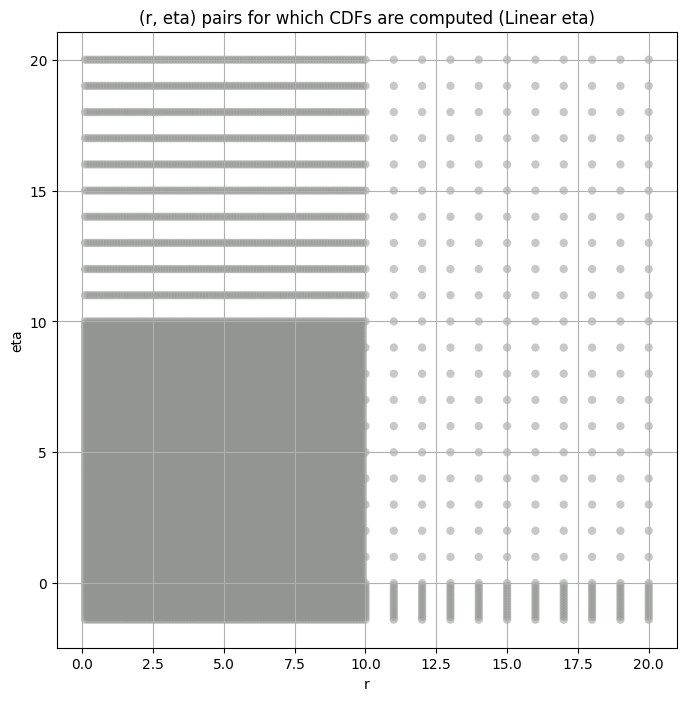

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,119.920680,90.392960,170.642840,10.590433,3.464781,74.931915,160000000.0,"(2.0, 0.5, 0.044)"
1,47.594410,35.287544,70.195230,16.244356,4.297632,127.499300,160000000.0,"(2.0, 0.5, 0.065)"
2,21.673610,15.789366,35.630035,23.372608,4.751333,189.667900,160000000.0,"(2.0, 0.5, 0.096)"
3,8.808341,6.126378,15.579457,28.468450,5.715089,174.328890,160000000.0,"(2.0, 0.5, 0.141)"
4,3.561086,2.395280,7.824097,44.146633,6.604411,327.389340,160000000.0,"(2.0, 0.5, 0.208)"
5,1.033891,0.661437,2.774271,82.956276,5.937702,427.047420,160000000.0,"(2.0, 0.5, 0.306)"
6,0.608527,0.399818,1.869624,99.041620,5.892619,468.845900,160000000.0,"(2.0, 0.5, 0.45)"
7,166.012740,126.613090,245.244550,12.991724,3.800807,110.412130,160000000.0,"(2.0, 1.0, 0.044)"
8,65.958330,48.032578,106.776000,17.634312,4.299627,133.457060,160000000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,119.920680,119.920677,112.300148,108.340263,102.536072
1,47.594410,47.594410,43.814865,41.972343,39.348217
2,21.673610,21.673611,19.702017,18.815195,17.559395
3,8.808341,8.808341,7.875830,7.460336,6.890198
4,3.561086,3.561086,3.145809,2.973319,2.737348
5,1.033891,1.033891,0.886067,0.833189,0.762902
6,0.608527,0.608527,0.519293,0.489619,0.450325
7,166.012740,166.012741,154.466949,148.773926,140.512878
8,65.958330,65.958328,60.487396,57.891792,54.222961


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.010389842018879769 119.92068


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.010782499102812593 112.30015


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.012463761808046425 108.34026


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.015107709218733167 102.53607
Number of samples: 100000, Without approximation : 160000000.0


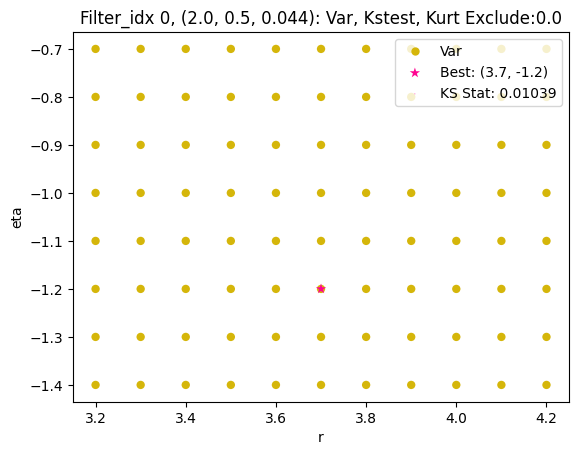

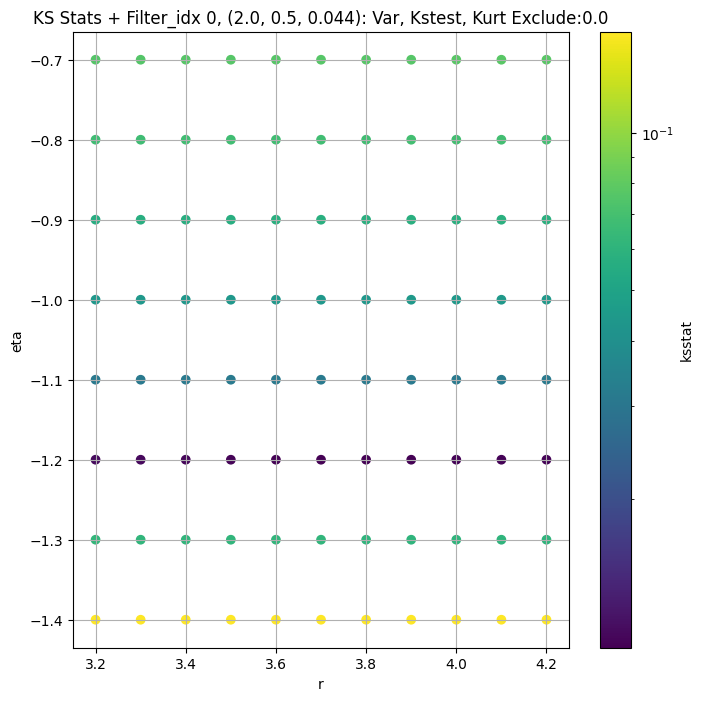

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.011634169665070249 47.59441


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.011402667990476512 43.814865


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.011693731130952956 41.972343


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.011701087837178936 39.348217
Number of samples: 100000, Without approximation : 160000000.0


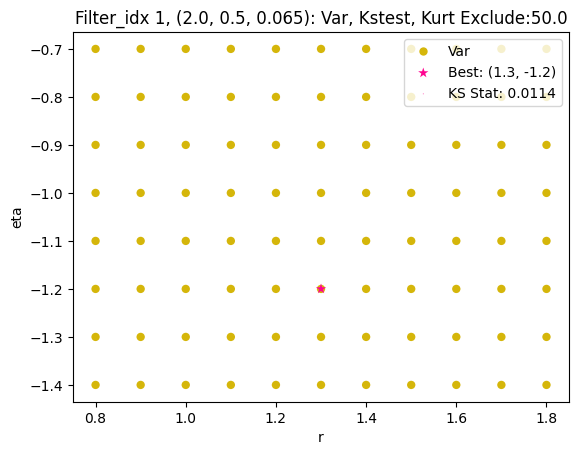

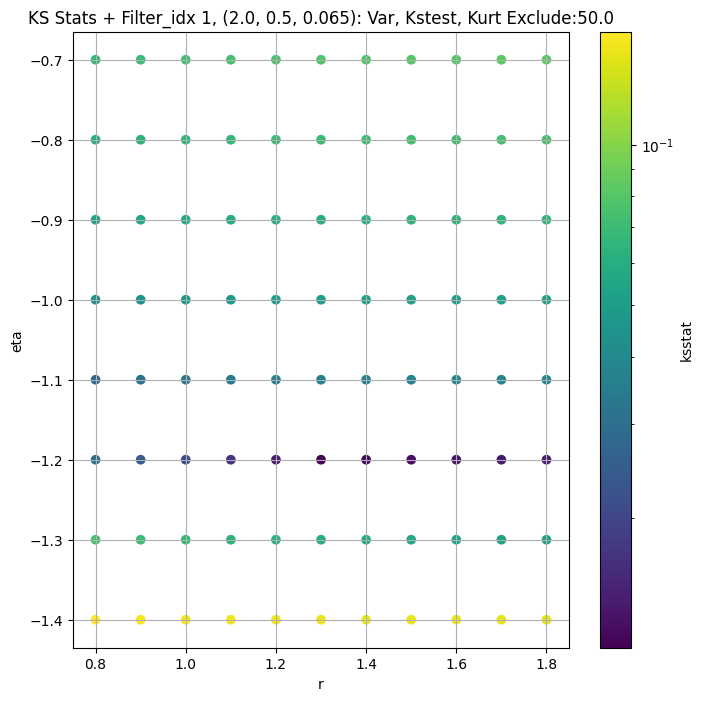

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.008964208268773088 21.67361


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.008775436062365527 19.702017


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.00906511616861938 18.815195


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.00897121889502328 17.559395
Number of samples: 100000, Without approximation : 160000000.0


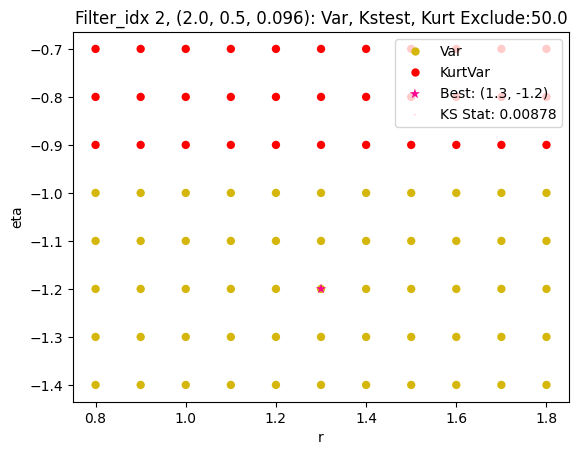

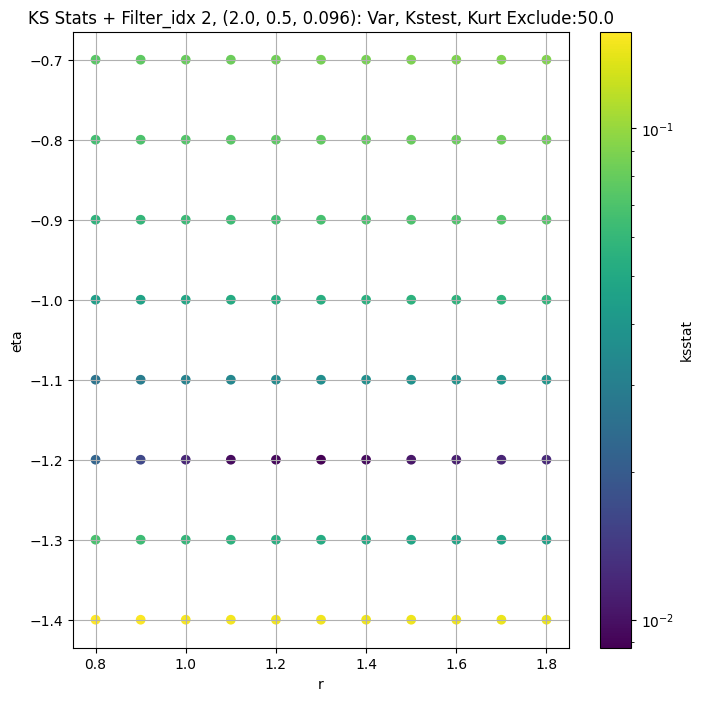

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.010230283502409288 8.808341


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.009921755832956736 7.8758297


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.008590391696484456 7.4603357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.012759647767824678 6.890198
Number of samples: 100000, Without approximation : 160000000.0


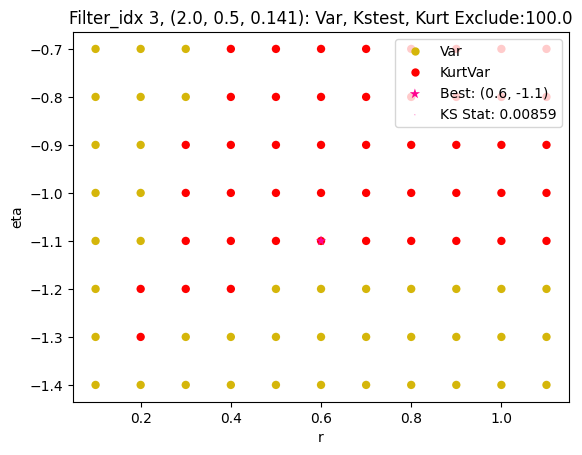

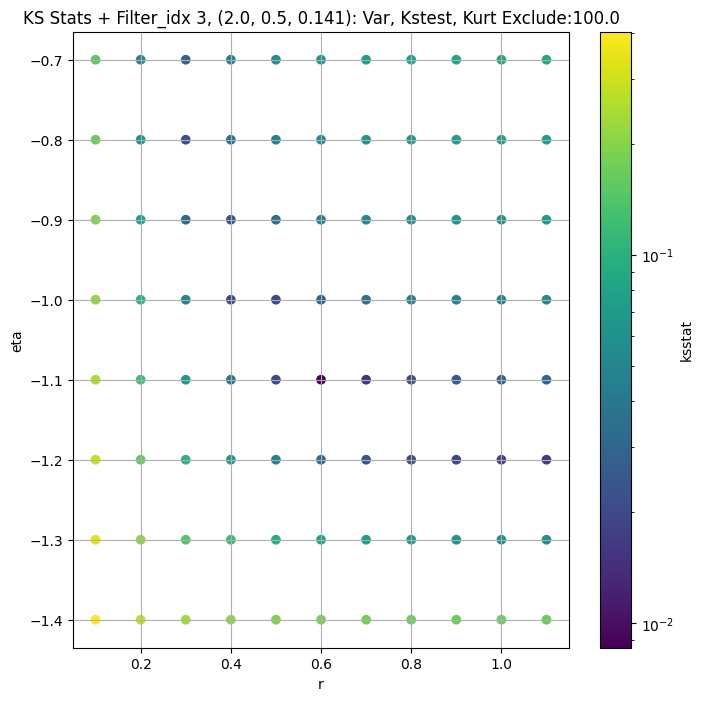

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.007937340947900218 3.5610857


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.012488241588769267 3.145809


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.009505736161895428 2.973319


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.008287055743470773 2.7373478
Number of samples: 100000, Without approximation : 160000000.0


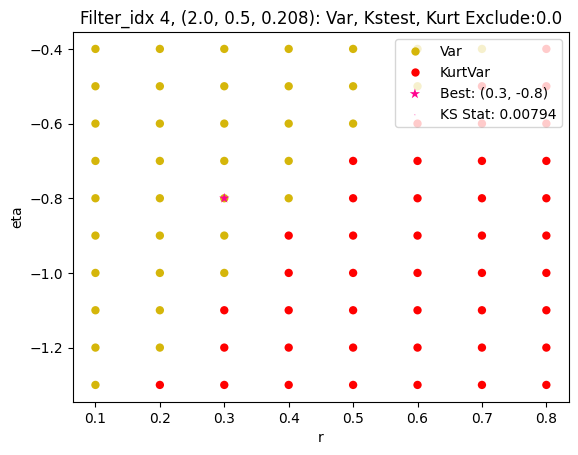

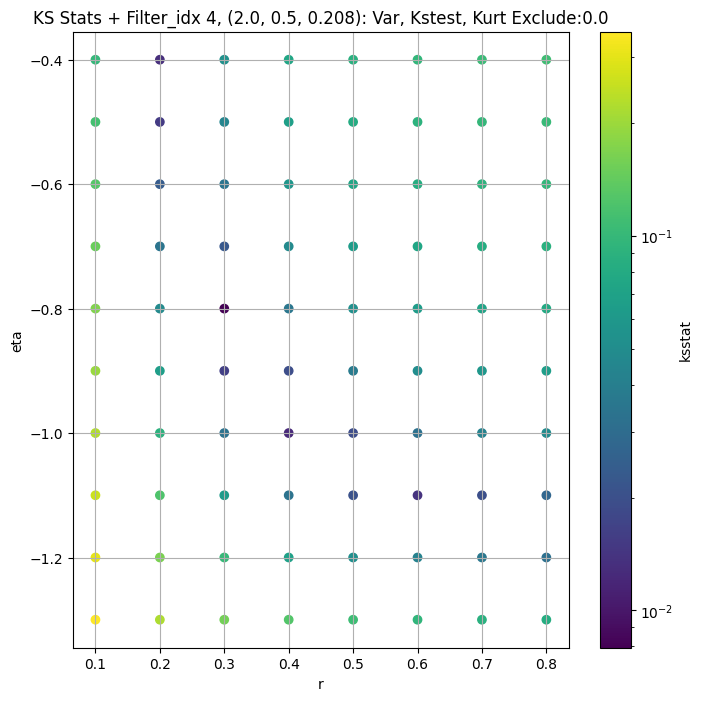

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.0038473966762069406 1.033891


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.004516957569333596 0.88606703


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.006114284929108149 0.8331886


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.006878002729097776 0.76290226
Number of samples: 100000, Without approximation : 160000000.0


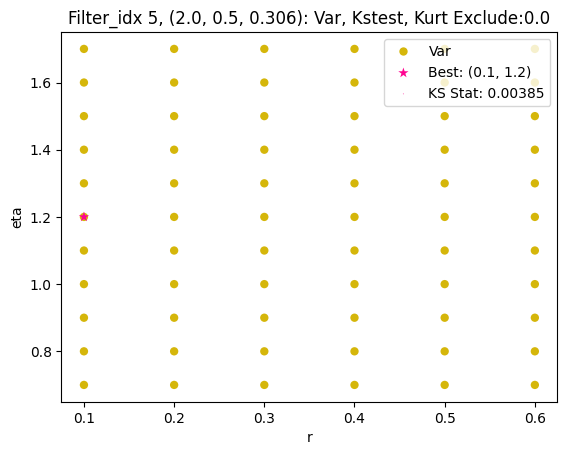

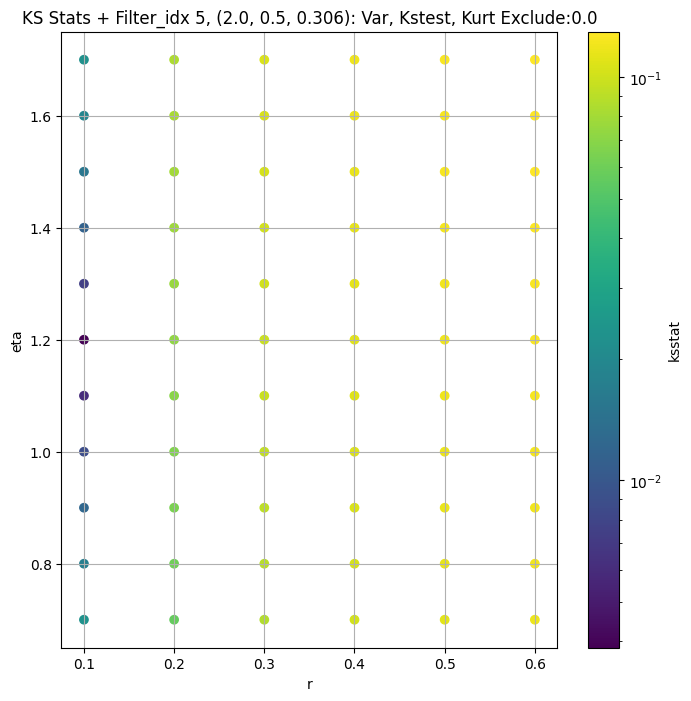

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.002096411593319747 0.6085269


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.003176518622534874 0.51929295


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.003665439753614219 0.48961866


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.004770245153505326 0.45032474
Number of samples: 100000, Without approximation : 160000000.0


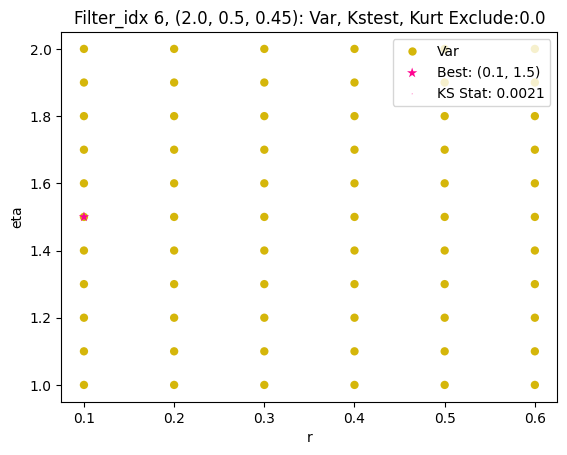

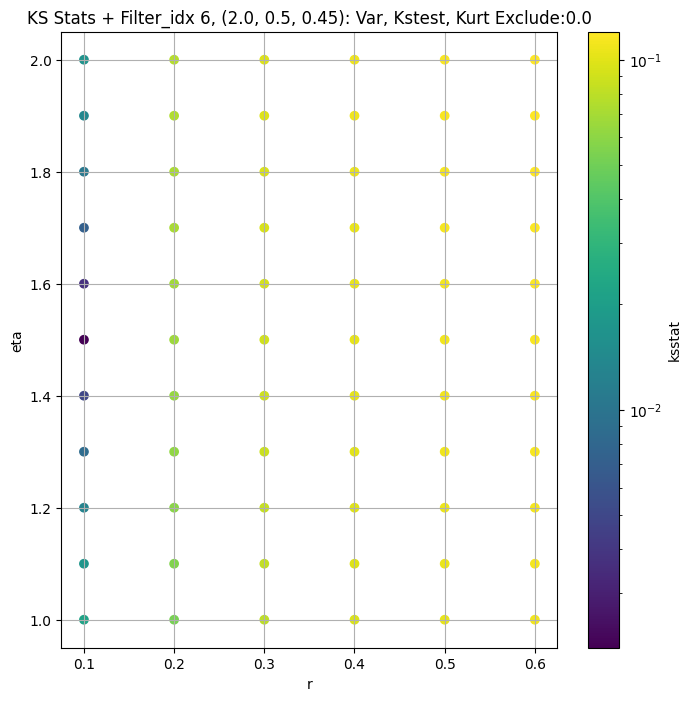

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.010354484888179805 166.01274


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.010968653862799493 154.46695


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.012613177496909045 148.77393


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.015179157529437326 140.51288
Number of samples: 100000, Without approximation : 160000000.0


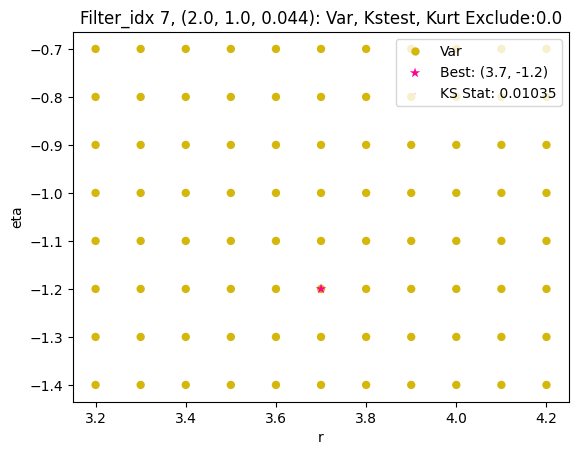

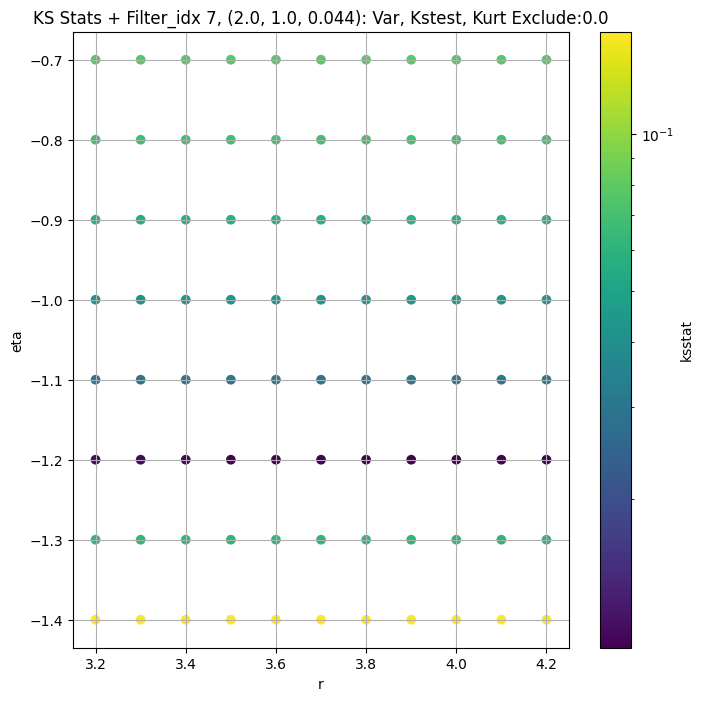

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.009156675252030427 65.95833


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.008865730194154486 60.487396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.008816331615557838 57.891792


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.008854854874182472 54.22296
Number of samples: 100000, Without approximation : 160000000.0


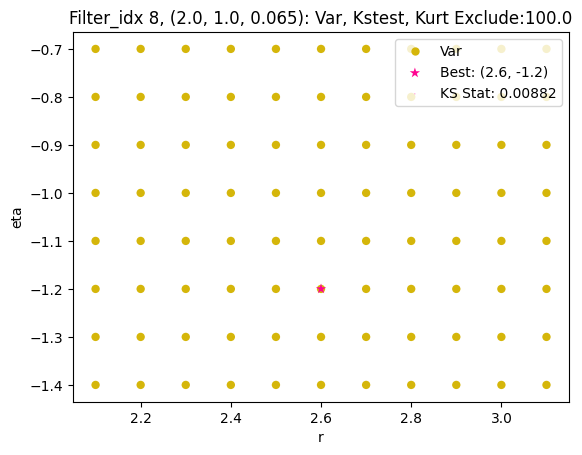

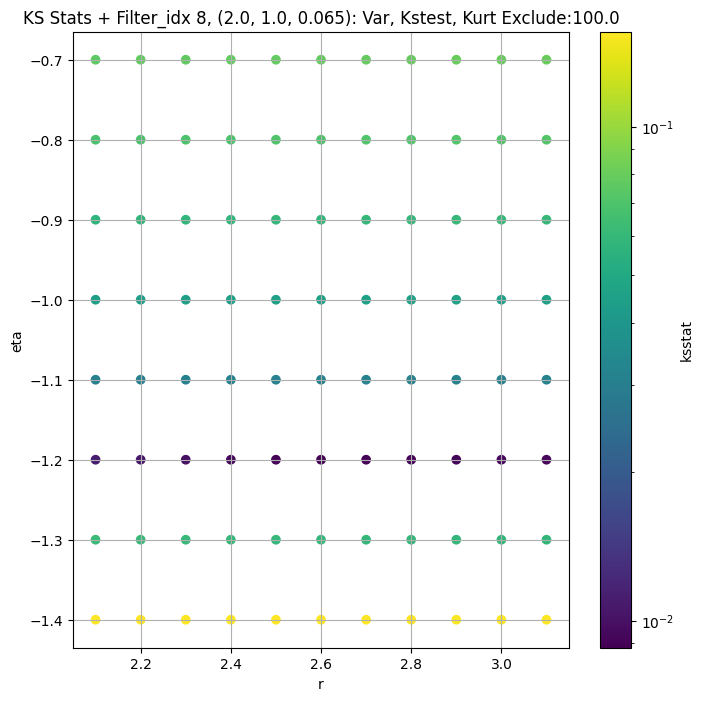

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.009195214420965547 27.470833


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.008664762268252857 24.865755


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.008352012160555589 23.750765


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.008178347184874701 22.180223
Number of samples: 100000, Without approximation : 160000000.0


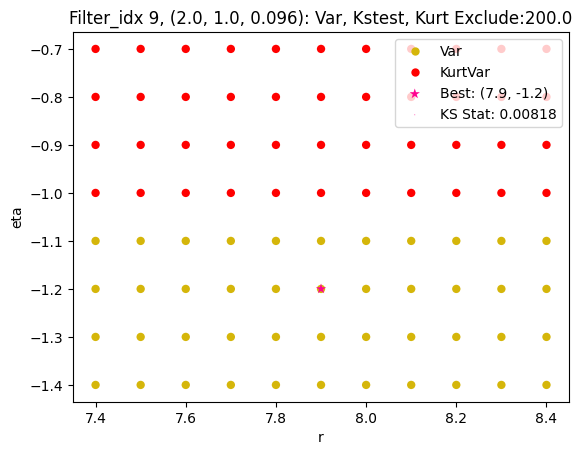

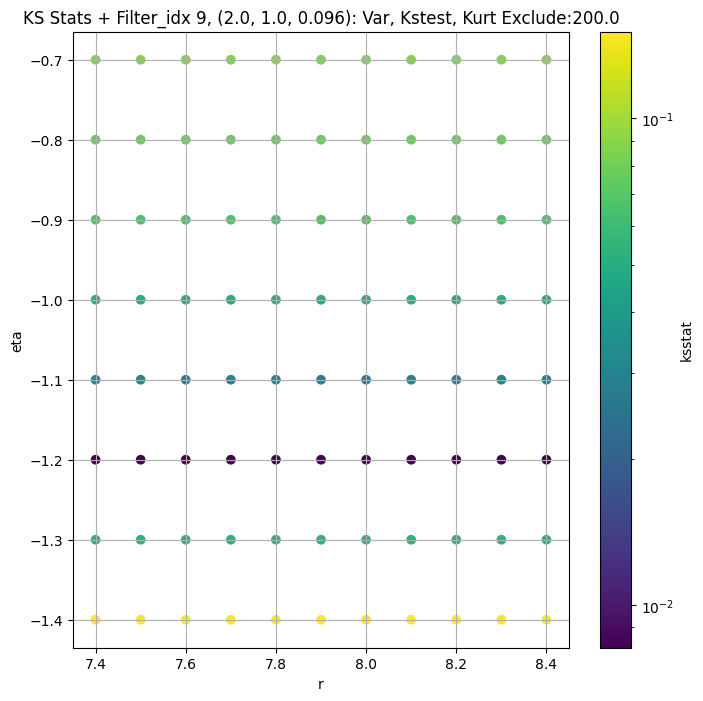

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.009870786067951998 12.15753


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.007126081551241642 10.875903


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.010340409428069464 10.33105


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.009389824472233355 9.569081
Number of samples: 100000, Without approximation : 160000000.0


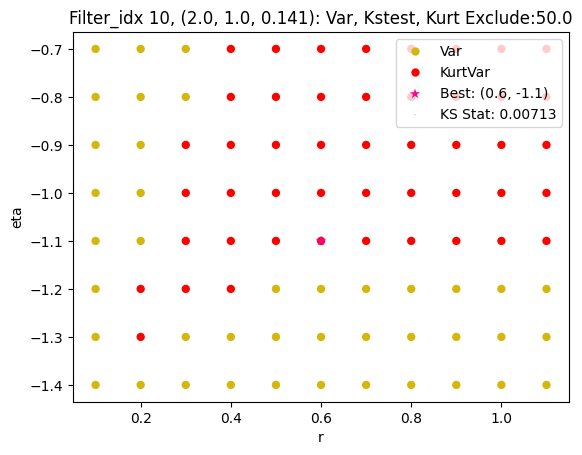

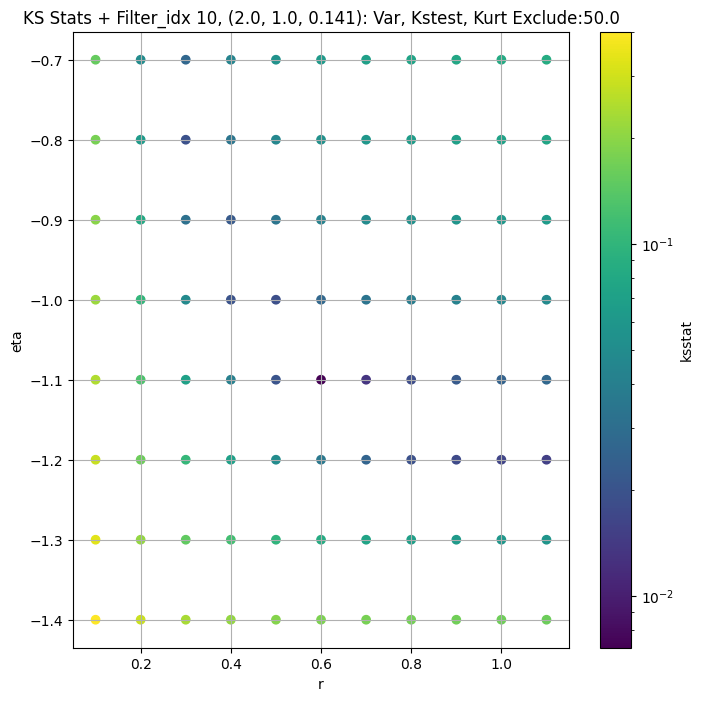

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.0073653933818307316 4.718697


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.009447535338397262 4.1265826


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.012501357725688667 3.882321


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.010283524384024578 3.553152
Number of samples: 100000, Without approximation : 160000000.0


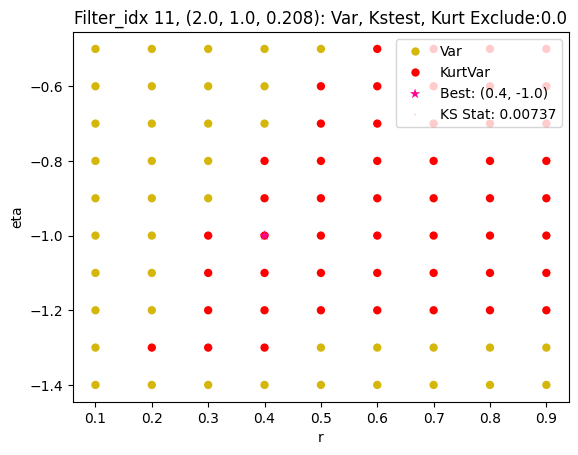

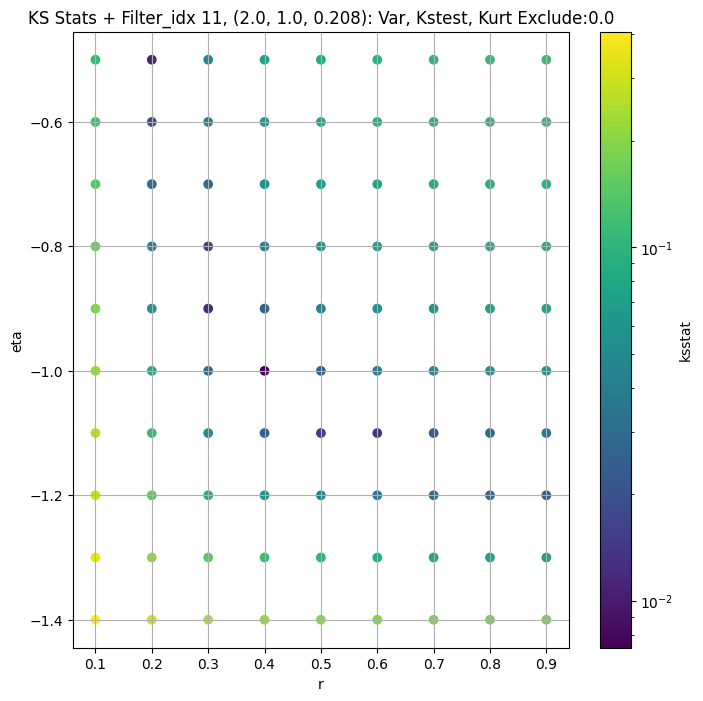

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.006465178410495431 1.6281819


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.007090090552631878 1.3914604


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.00872544483386306 1.3065224


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.00823174039080743 1.1937668
Number of samples: 100000, Without approximation : 160000000.0


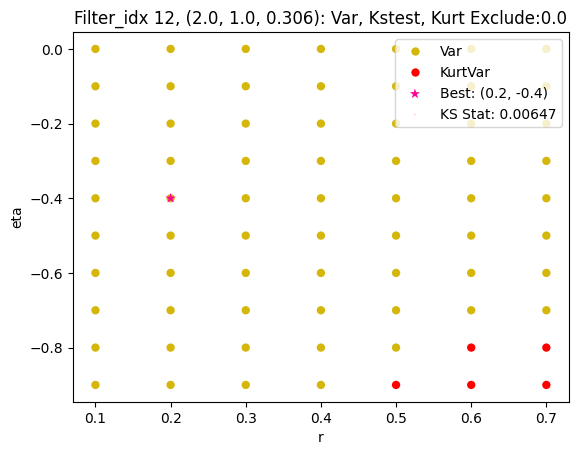

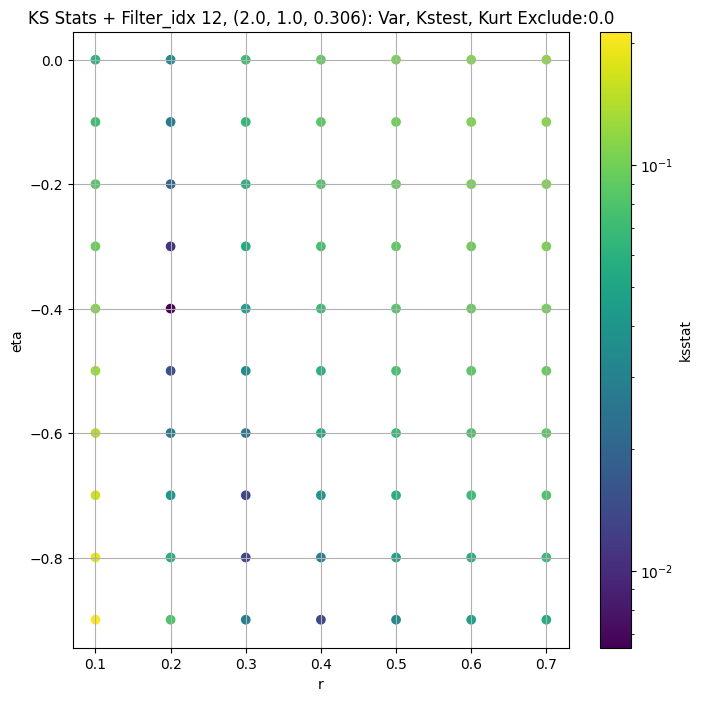

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.0023507149498195323 0.5886774


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.0028447486156001345 0.49662054


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.0043638575683067615 0.4683042


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.005604125754763656 0.43057942
Number of samples: 100000, Without approximation : 160000000.0


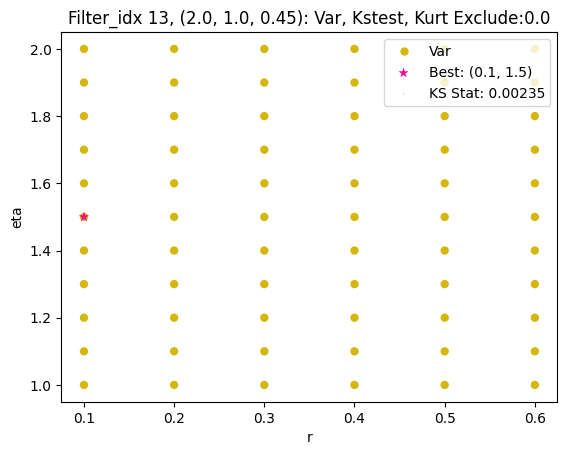

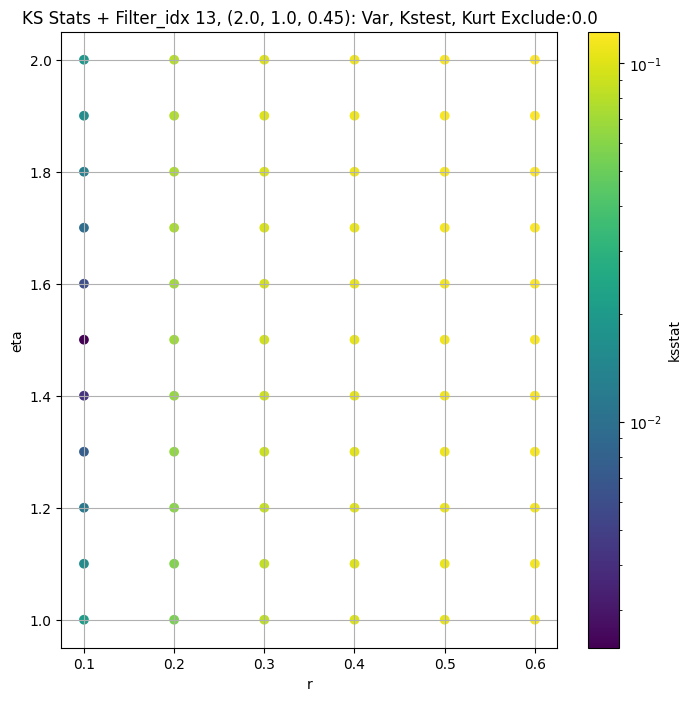

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.010524573737086096 116.50107


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.010634322107696936 108.05007


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.010502264932350291 103.80156


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.010636037038318613 97.61616
Number of samples: 100000, Without approximation : 160000000.0


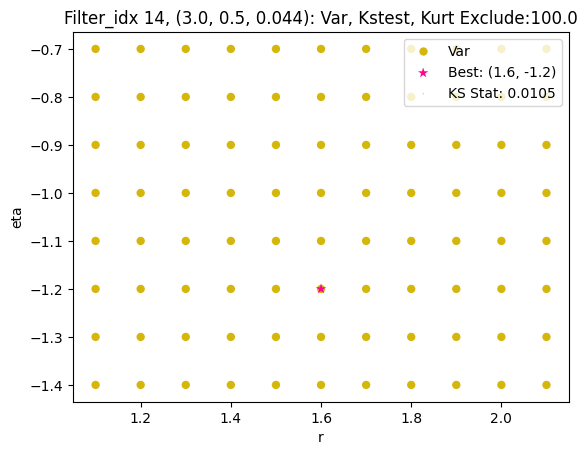

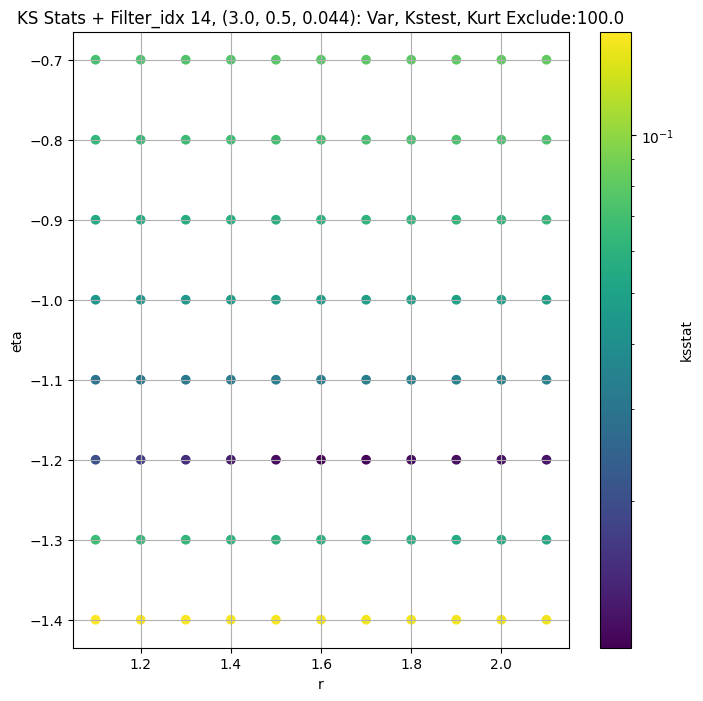

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.01013840946347977 48.885197


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.010084641346713497 44.858814


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.010516933900432957 42.966965


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.010303600932401236 40.24318
Number of samples: 100000, Without approximation : 160000000.0


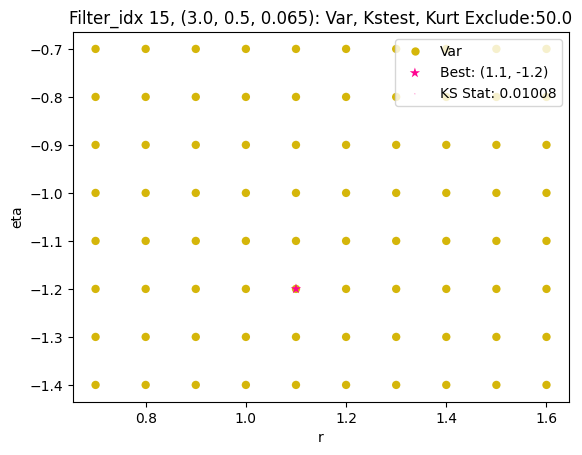

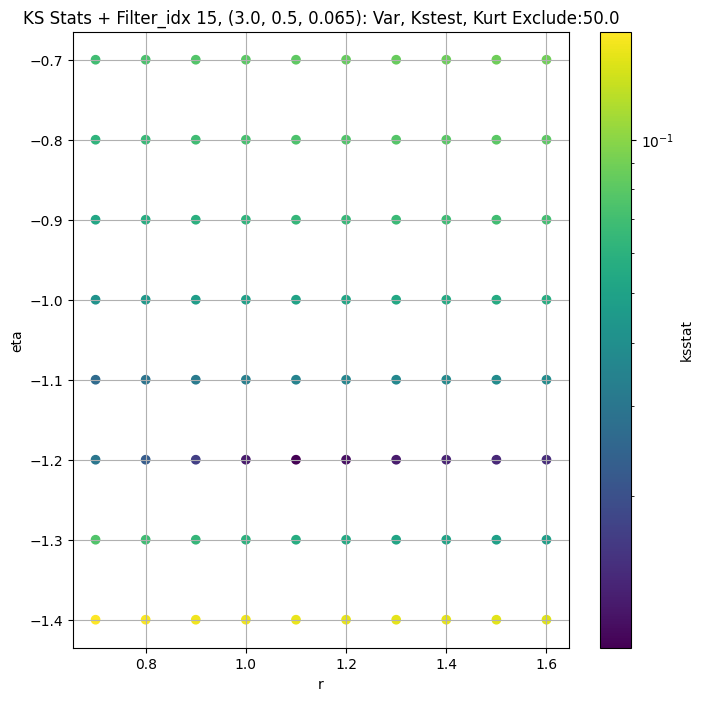

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.010105683687205269 20.937191


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.010450511694919395 18.837904


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.010256120000555646 17.90752


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.010055783354170011 16.586258
Number of samples: 100000, Without approximation : 160000000.0


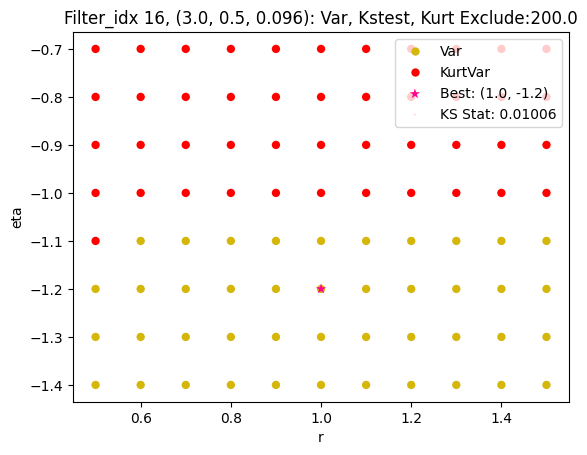

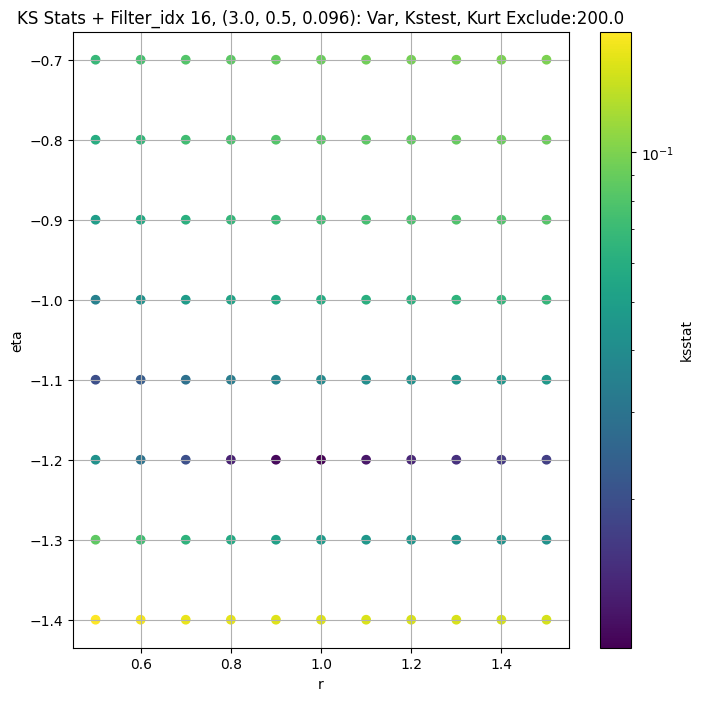

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.014118652613126614 8.425982


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.009582193324096322 7.471787


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.010004218922231078 7.0615706


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.014540281962339752 6.491939
Number of samples: 100000, Without approximation : 160000000.0


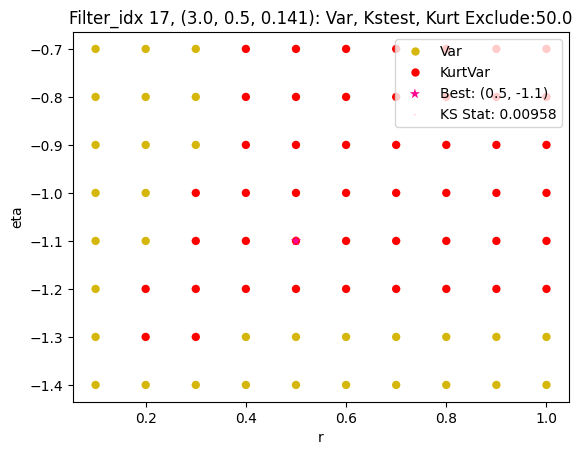

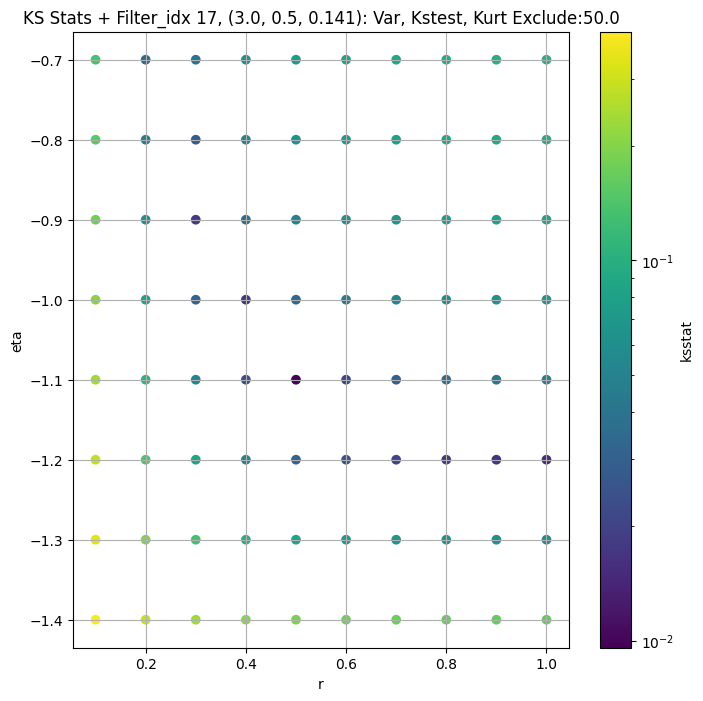

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.009643076597166678 3.3330612


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.010985195447749008 2.9201498


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.01062607514635272 2.740345


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.013296082990762681 2.4975522
Number of samples: 100000, Without approximation : 160000000.0


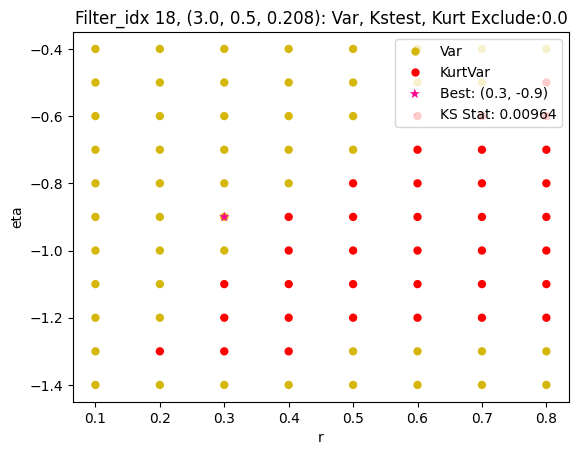

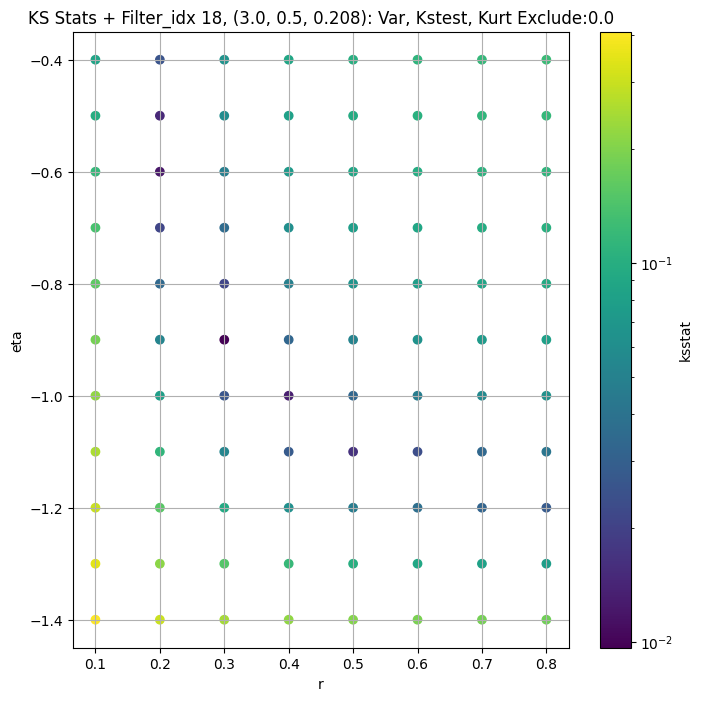

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.005642158744837811 0.9693491


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.0067852018758296495 0.81922686


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.006134540896999496 0.7651845


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.008445794049051256 0.6944632
Number of samples: 100000, Without approximation : 160000000.0


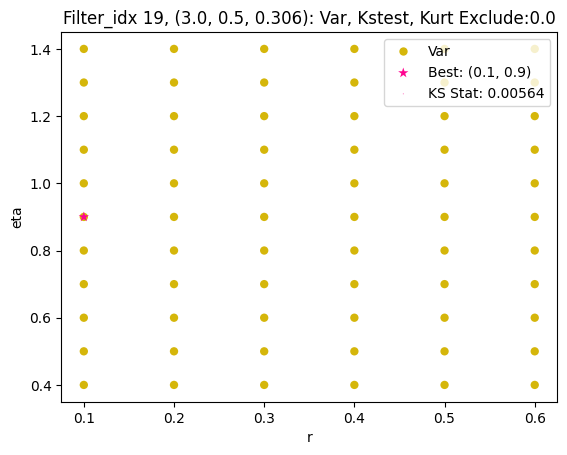

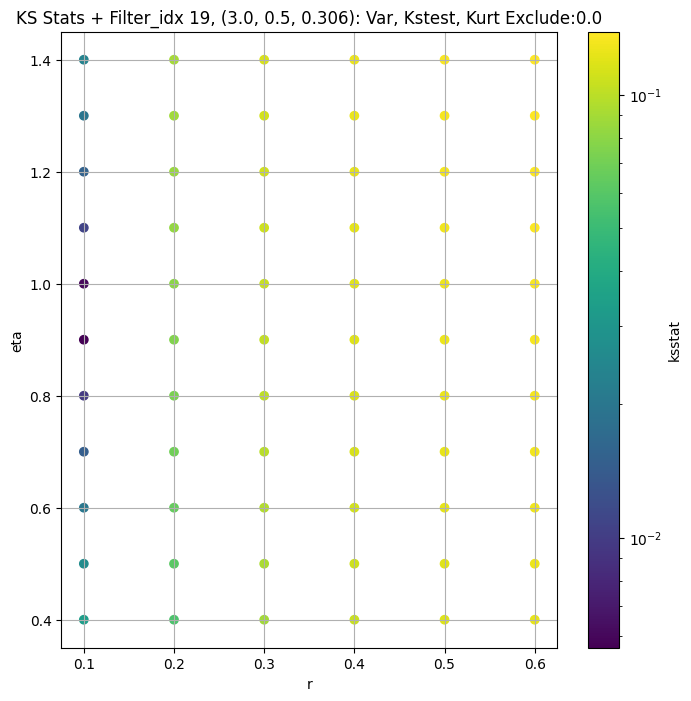

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.003968893821072017 0.34720543


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.003418705702001236 0.29037085


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.00401952274662265 0.2731885


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.006109752420044301 0.2507912
Number of samples: 100000, Without approximation : 160000000.0


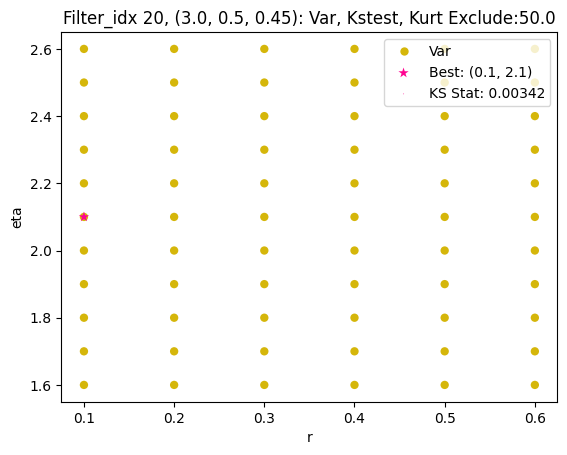

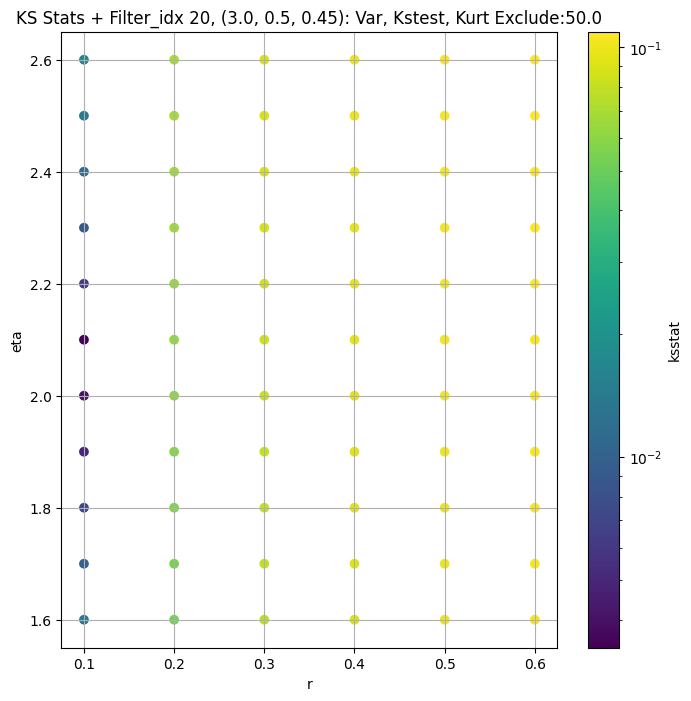

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.008113879122355339 140.4855


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.007933561571583758 129.50838


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.008046208790261411 124.11669


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.008073429333831261 116.3625
Number of samples: 100000, Without approximation : 160000000.0


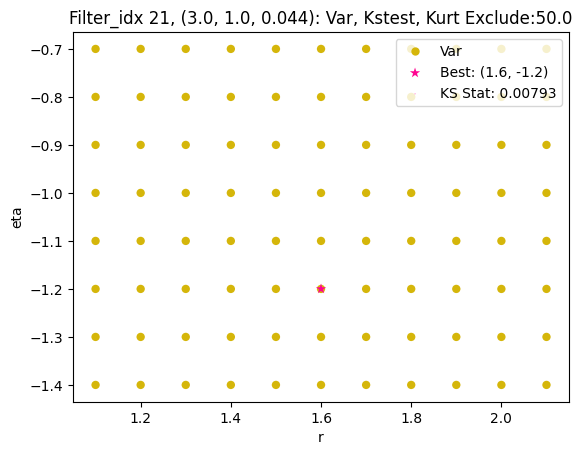

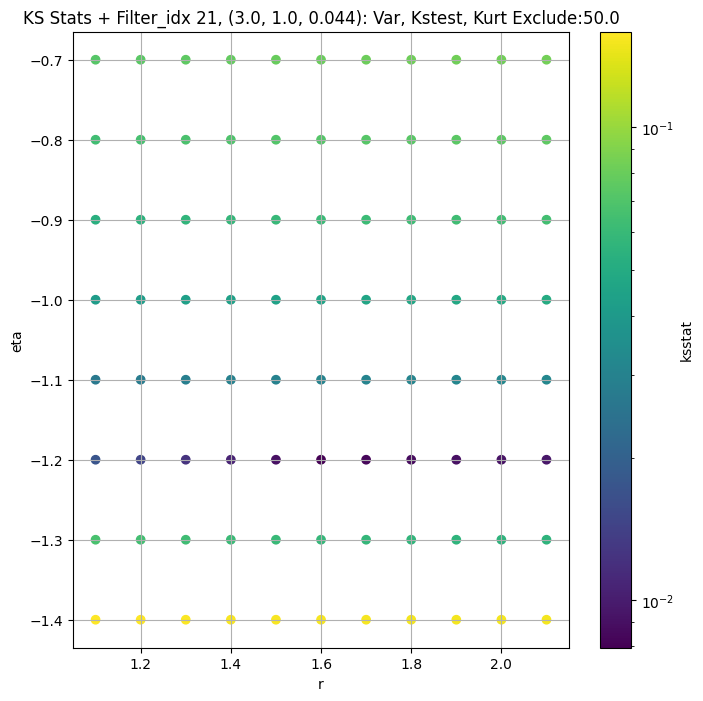

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.007907003241583332 53.498684


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.007749189745251961 48.826286


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.008154105586767324 46.688107


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.007898668061147363 43.63807
Number of samples: 100000, Without approximation : 160000000.0


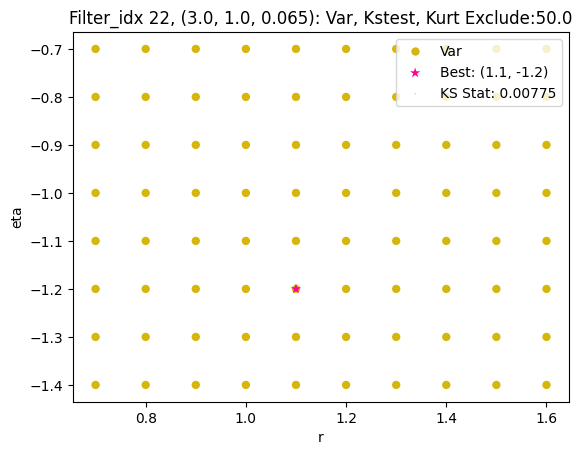

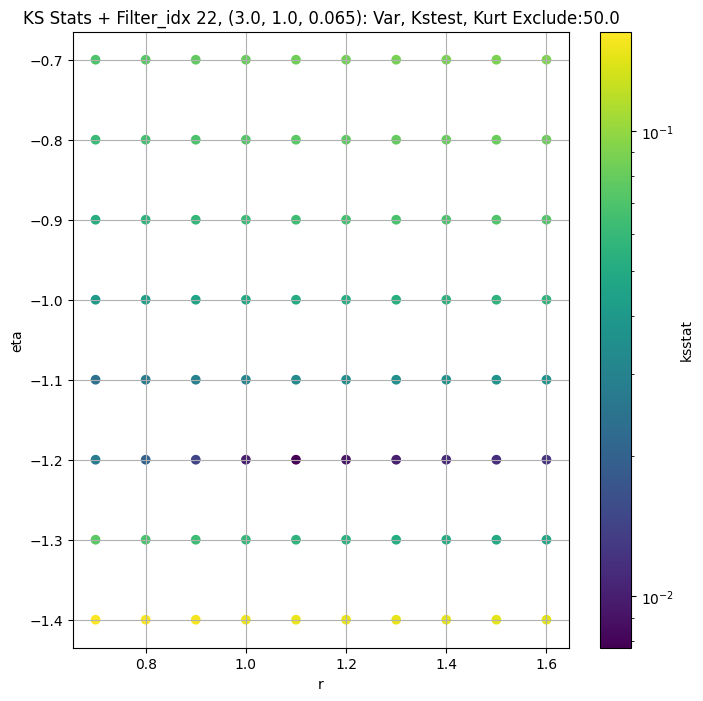

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.009306190707523476 23.714125


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.009063579784741482 21.734434


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.008822431746880799 20.750174


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.008837816957371236 19.325962
Number of samples: 100000, Without approximation : 160000000.0


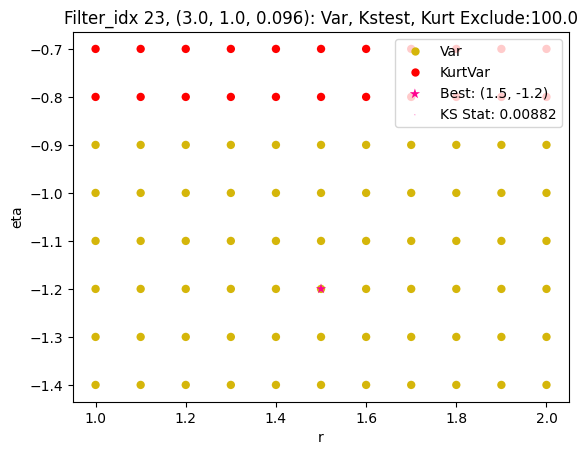

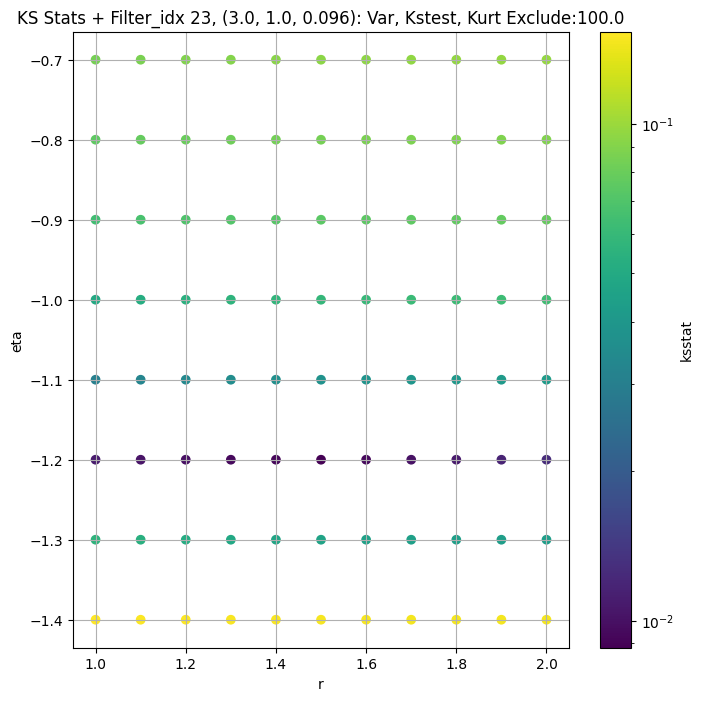

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.012057661847886258 10.035672


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.007692771594670855 8.893985


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.00829310915791448 8.386857


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.013280275205654446 7.691683
Number of samples: 100000, Without approximation : 160000000.0


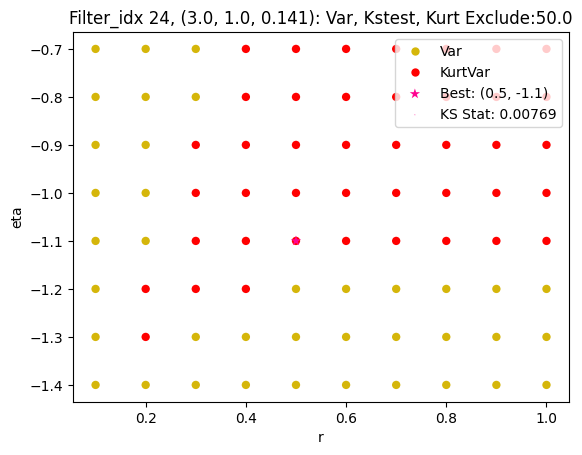

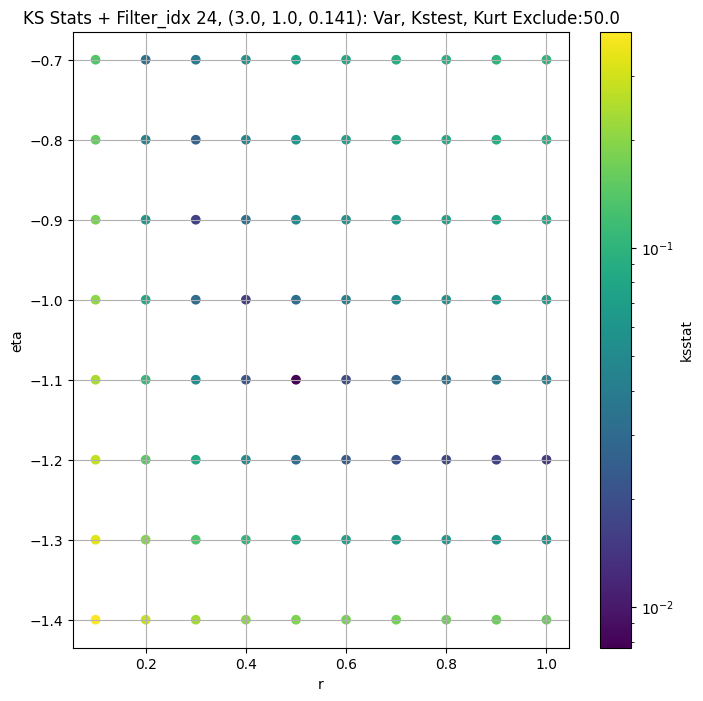

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.009766244698953763 3.9081697


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.009154832554249495 3.384917


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.009103551197906623 3.1672604


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.010560014616629365 2.8761277
Number of samples: 100000, Without approximation : 160000000.0


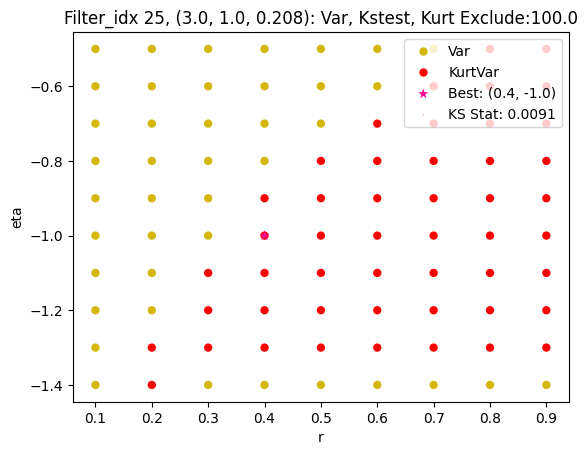

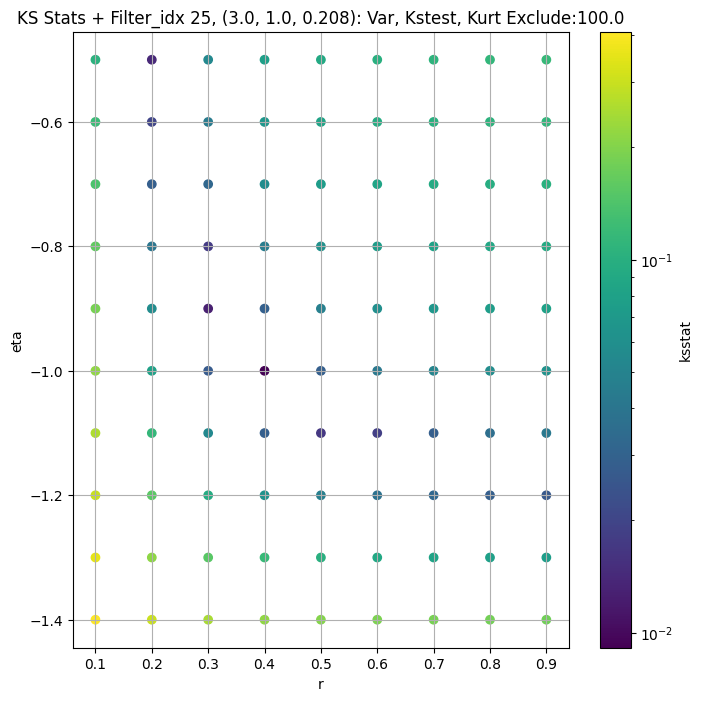

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.005975616151722374 1.2336318


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.007149276562673501 1.0249529


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.006407242091489351 0.95391953


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.008378505337128826 0.86159354
Number of samples: 100000, Without approximation : 160000000.0


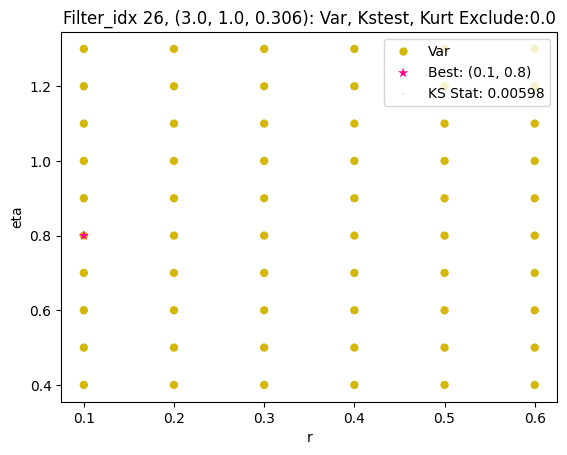

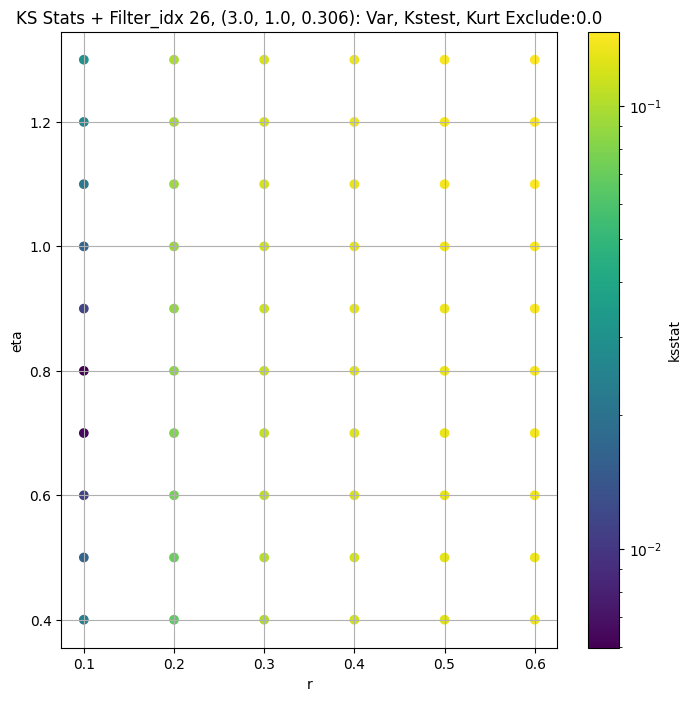

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.006000923429323679 0.4590403


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.002623720094634824 0.36544505


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.003900350346646042 0.3419159


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.005067661475208207 0.31167412
Number of samples: 100000, Without approximation : 160000000.0


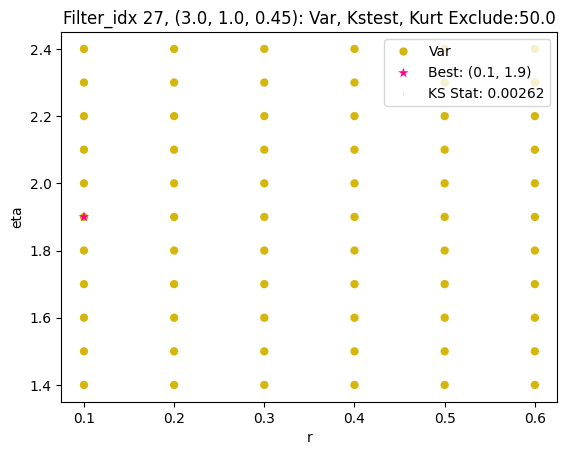

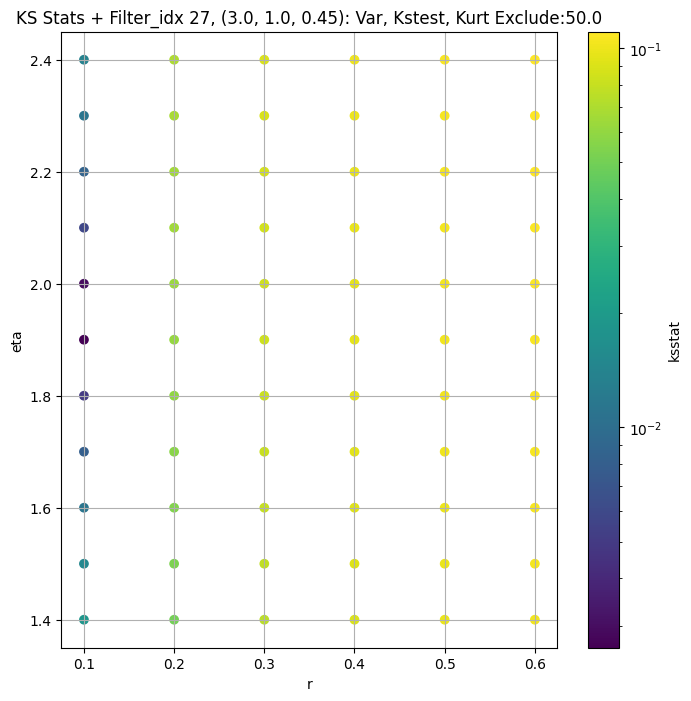

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.008278942433545322 107.09753


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.008331400351473006 100.69229


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.008359579149058993 97.163414


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.008692543583026235 91.86187
Number of samples: 100000, Without approximation : 160000000.0


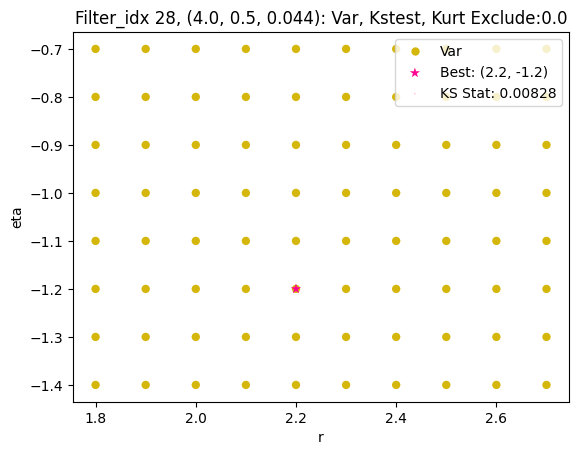

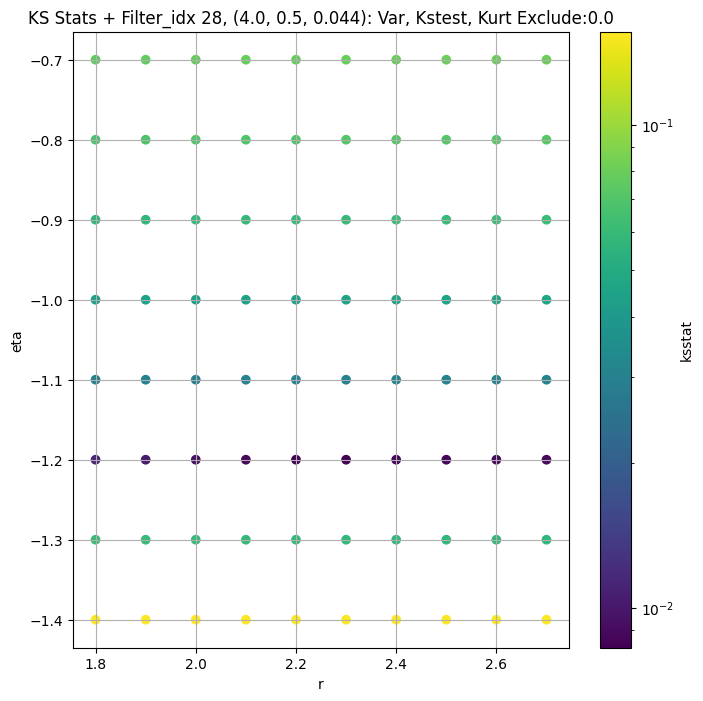

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.007449385406066267 42.61373


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.007181573987167622 39.32629


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.007482300434607403 37.708252


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.007320855069209264 35.343285
Number of samples: 100000, Without approximation : 160000000.0


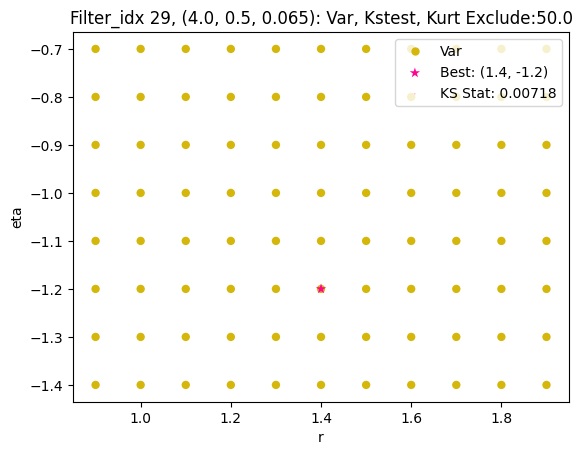

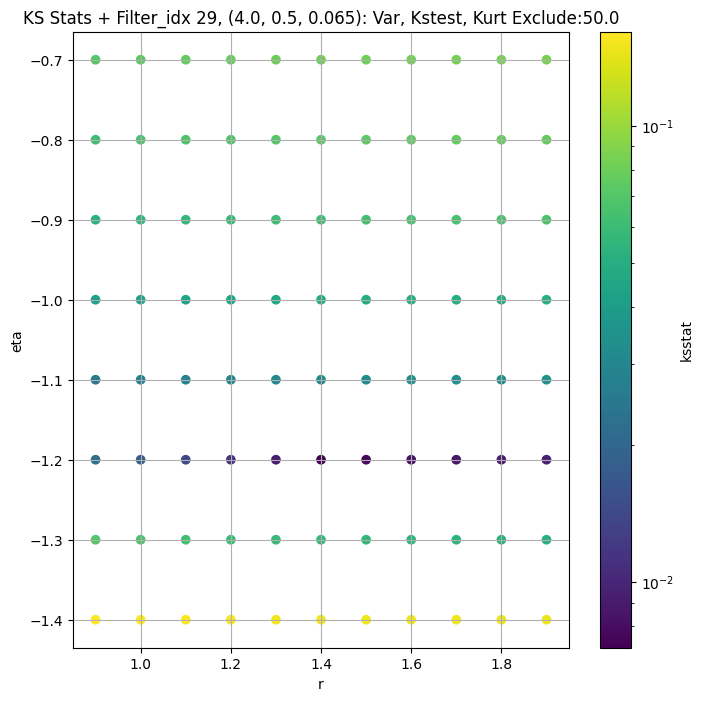

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.009509627780247443 19.663296


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.009737459817436123 17.999205


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.009580775420465648 17.170973


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.009498083981769156 15.978004
Number of samples: 100000, Without approximation : 160000000.0


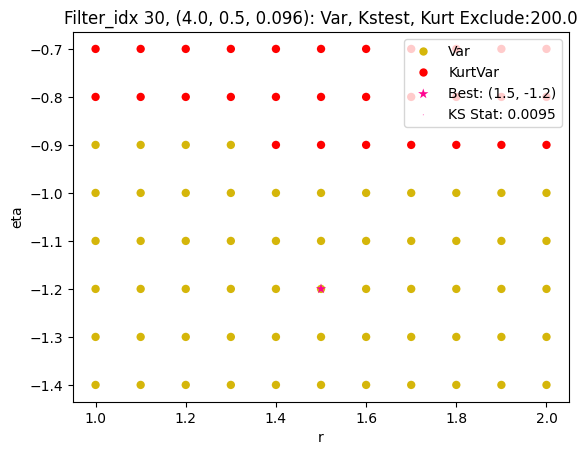

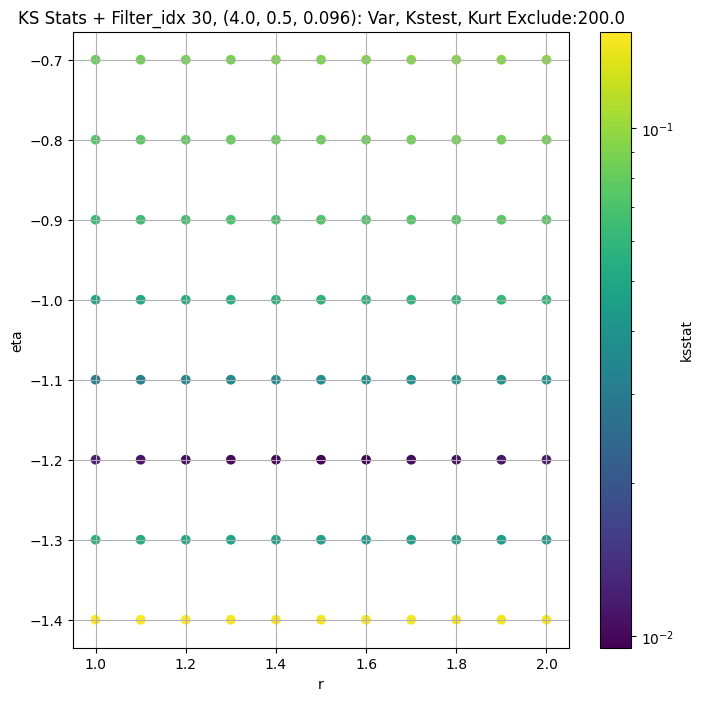

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.012103272809417087 8.503867


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.009156518786648776 7.5925074


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.012508008584429797 7.173278


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.01395923391921472 6.5907974
Number of samples: 100000, Without approximation : 160000000.0


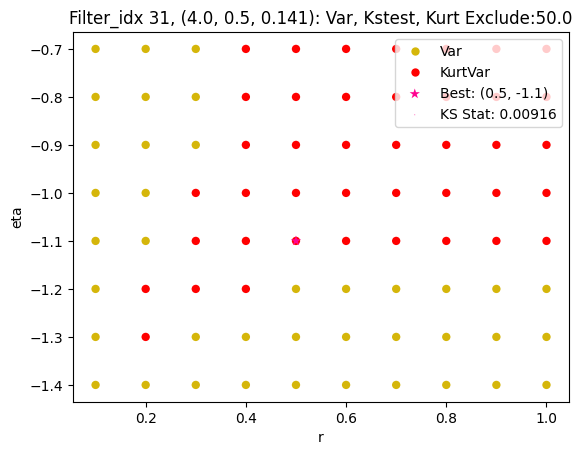

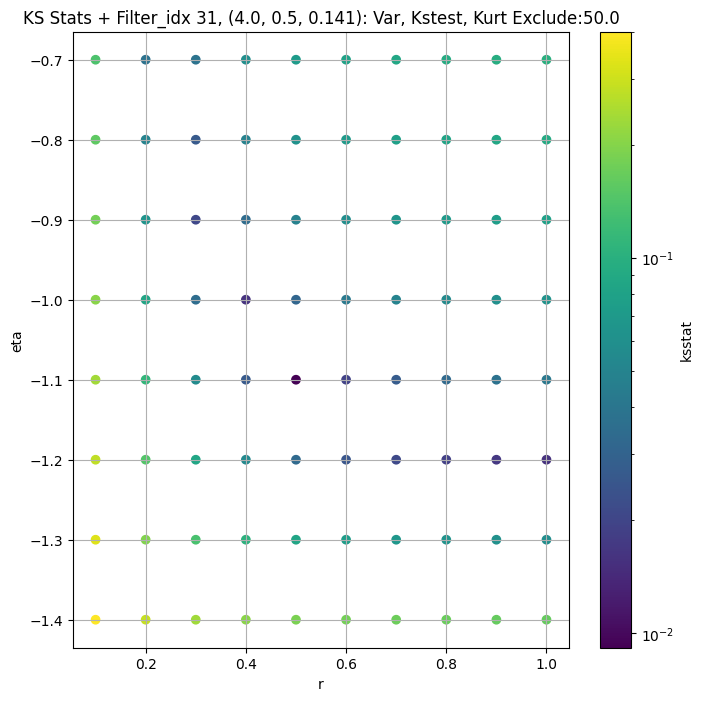

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.009788509973562842 3.3099813


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.009809296006400459 2.831337


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.009963759501197322 2.6569633


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.012769769306133827 2.4225173
Number of samples: 100000, Without approximation : 160000000.0


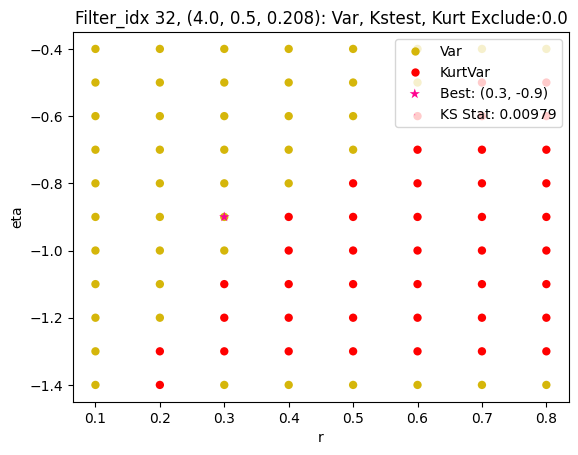

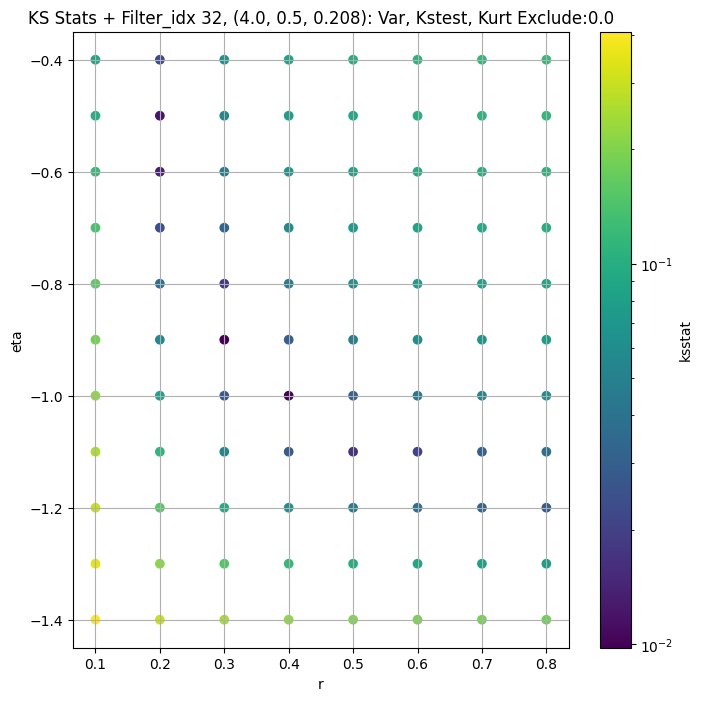

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.006358176735071885 0.9458285


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.0063861802572236365 0.78776646


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.007259989303475711 0.7353637


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.008050125888722115 0.6670952
Number of samples: 100000, Without approximation : 160000000.0


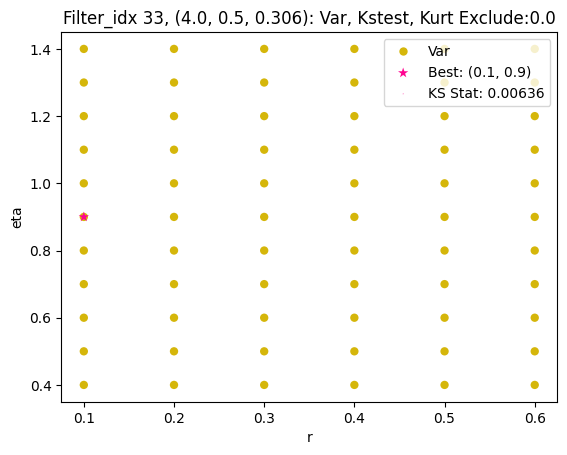

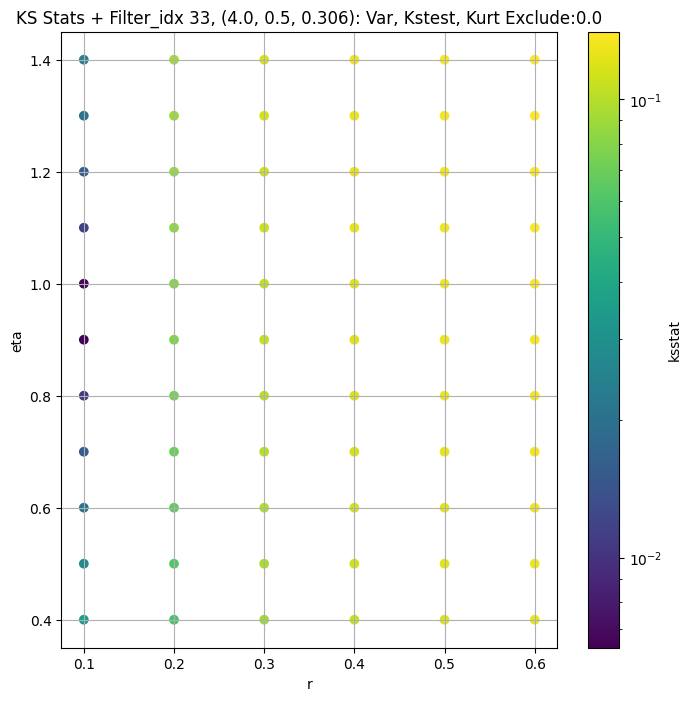

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.0036079438070878433 0.30912352


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.0030797800934665442 0.24671529


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.003216072863406756 0.23272169


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.004723010497145297 0.21458416
Number of samples: 100000, Without approximation : 160000000.0


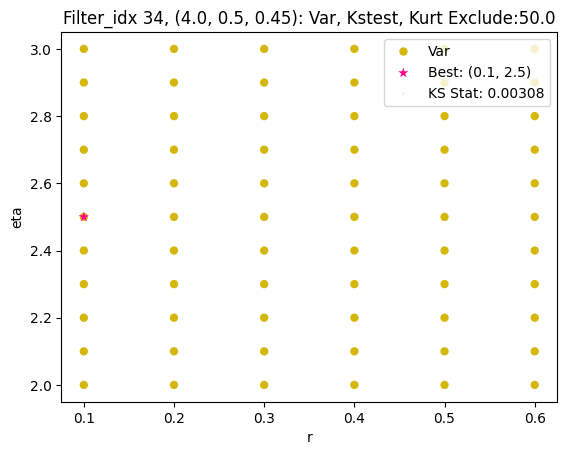

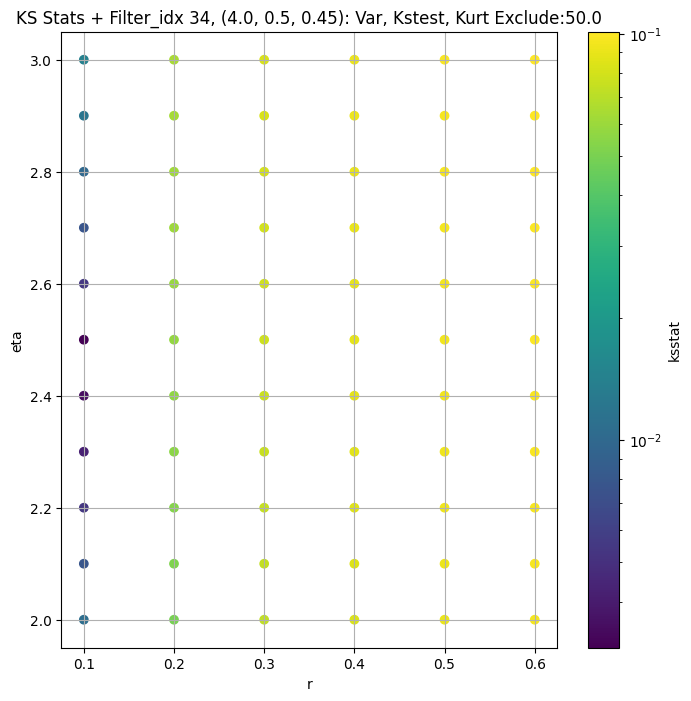

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.007306358604838081 121.18041


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.00757988499018869 111.67986


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.007438129444546138 107.007835


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.007510295269466949 100.36782
Number of samples: 100000, Without approximation : 160000000.0


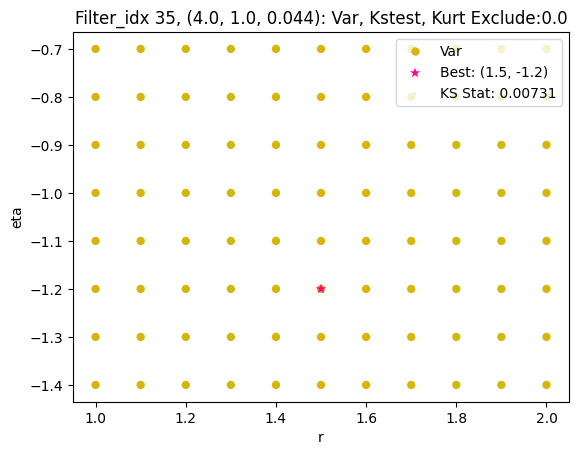

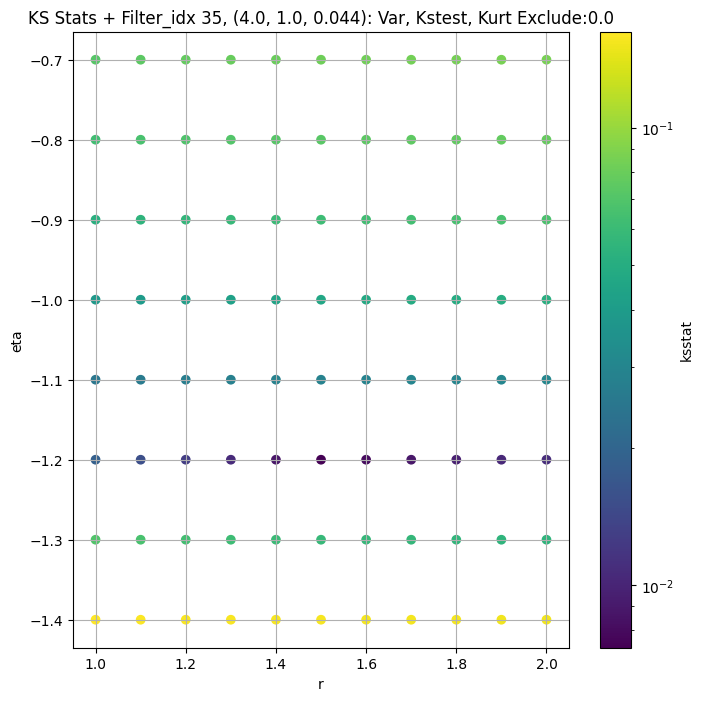

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.010104945461941517 50.96683


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.010132744613826183 46.97357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.010551533686398273 44.971058


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.01031971206878618 42.06902
Number of samples: 100000, Without approximation : 160000000.0


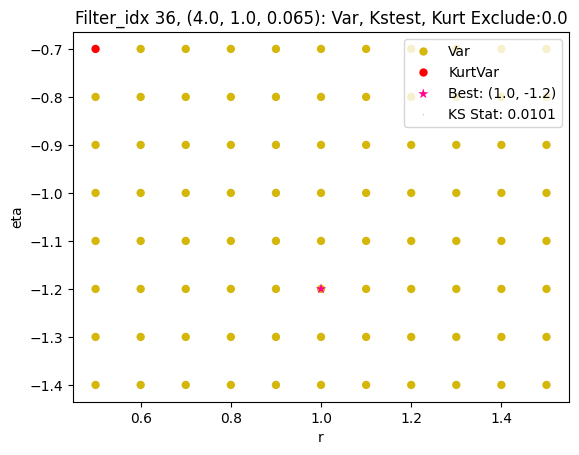

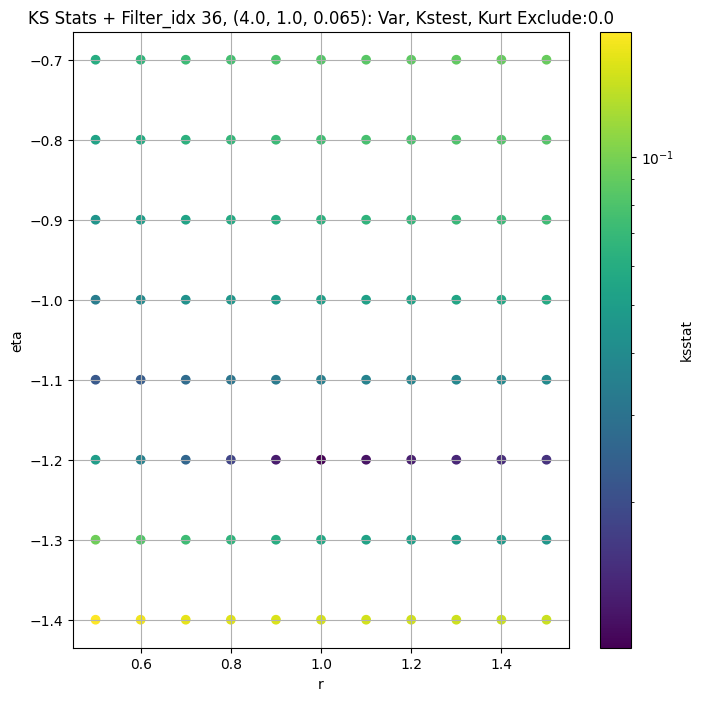

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.010674843064973571 23.426535


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.0098742999161604 21.248037


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.00964743483379904 20.202948


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.00947607769686748 18.74327
Number of samples: 100000, Without approximation : 160000000.0


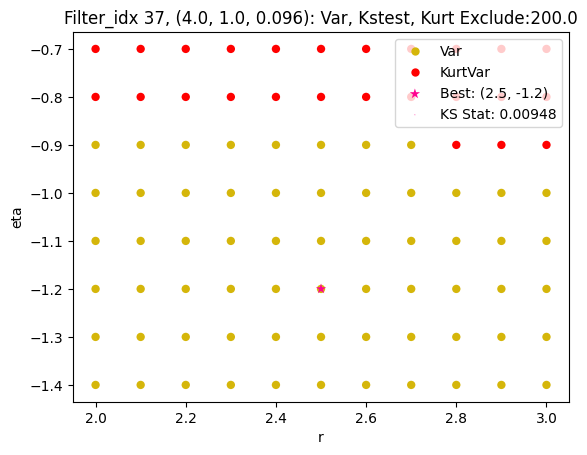

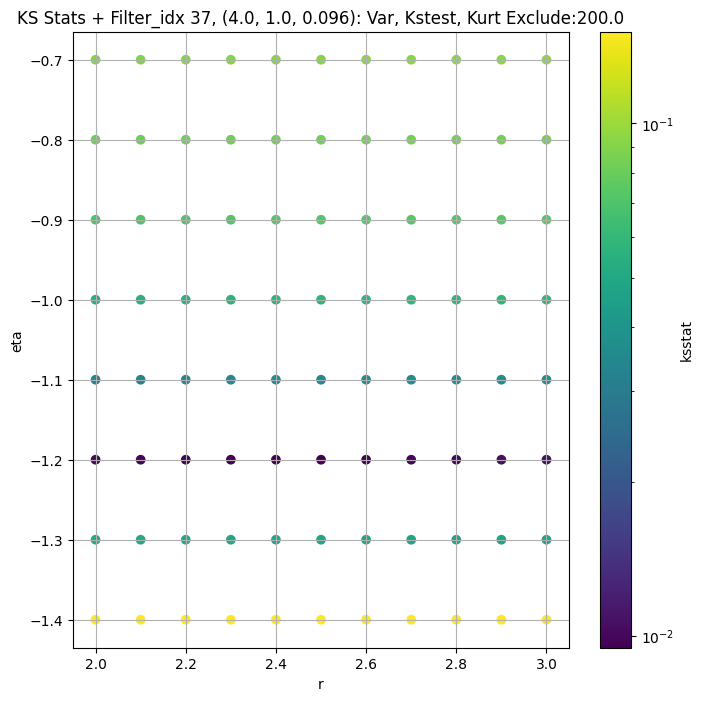

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.009150497299542815 9.312407


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.008227809845397949 8.204585


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.010287368114792 7.740921


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.010448533275189409 7.101048
Number of samples: 100000, Without approximation : 160000000.0


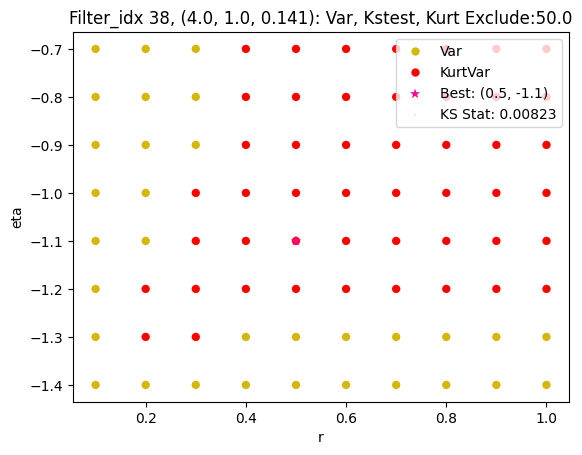

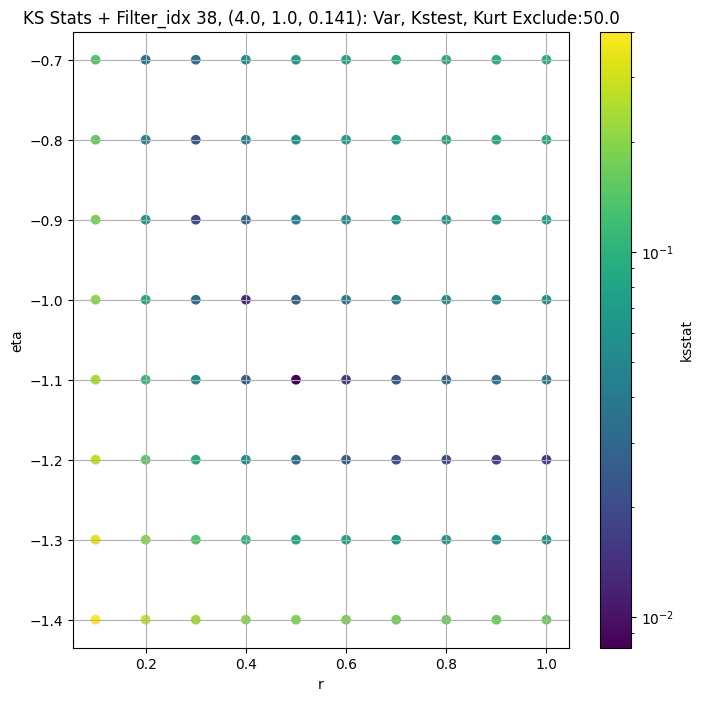

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.0069733283913929744 3.6433825


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.00875147380794844 3.14116


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.00974657239505794 2.9520884


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.013276405653031897 2.695764
Number of samples: 100000, Without approximation : 160000000.0


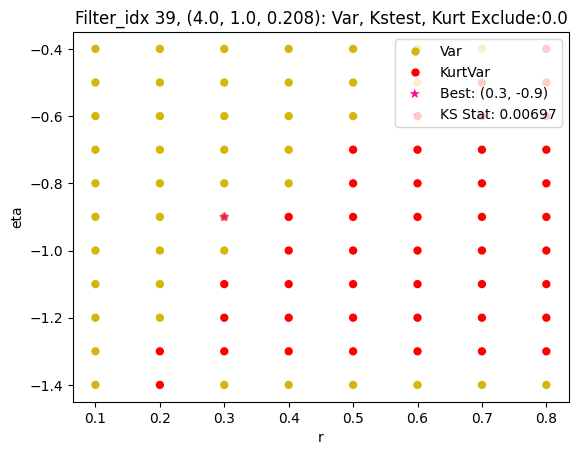

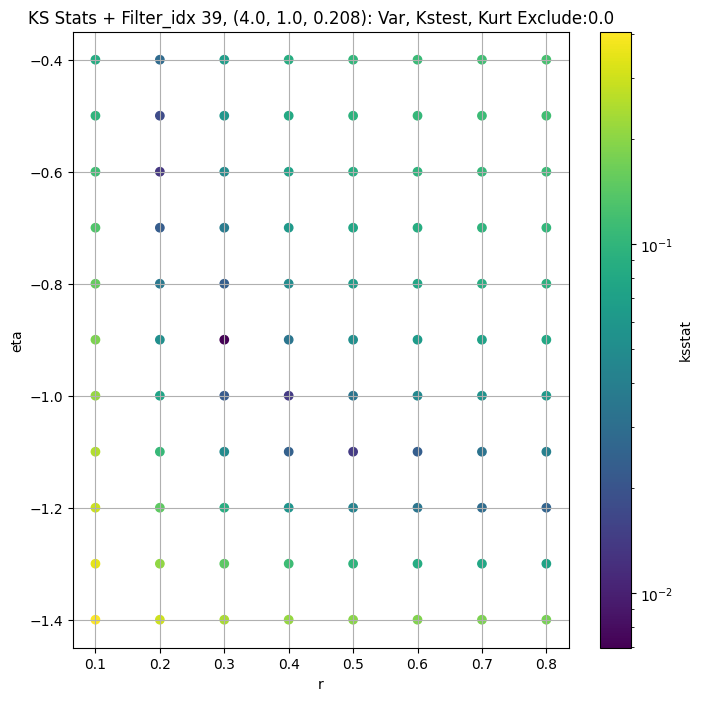

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.005190528201878819 1.1515096


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.006282966202651799 0.92886615


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.005391786285273571 0.86677986


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.007710815189980069 0.7857825
Number of samples: 100000, Without approximation : 160000000.0


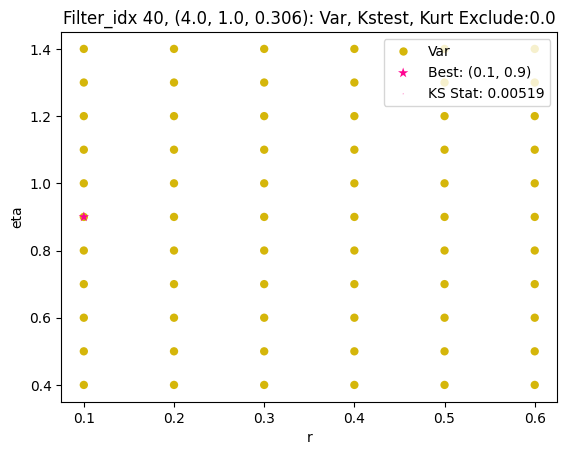

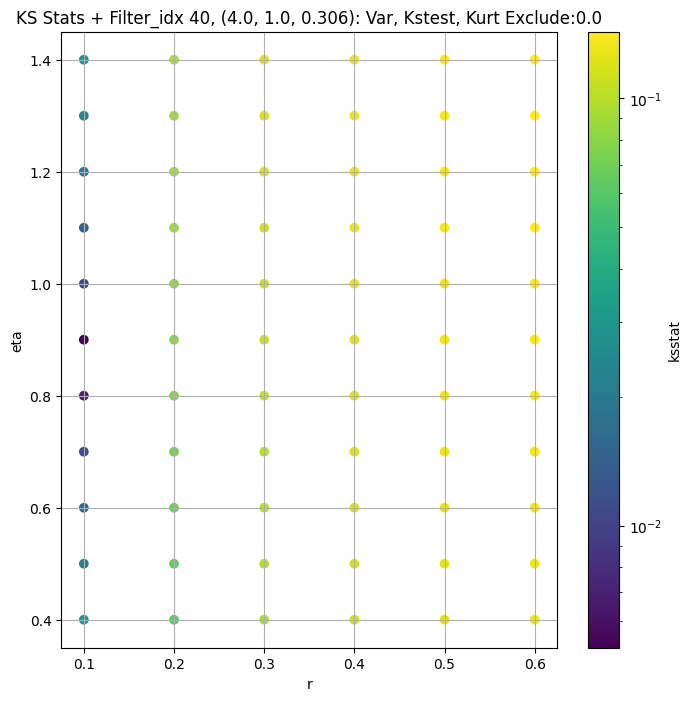

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.006819612980065726 0.39317724


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.0024986992794391316 0.29729268


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.003912550136496003 0.277479


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.0050337803775527545 0.25254124
Number of samples: 100000, Without approximation : 160000000.0


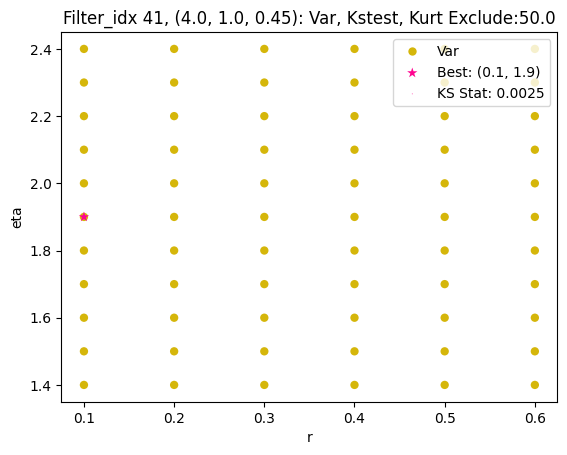

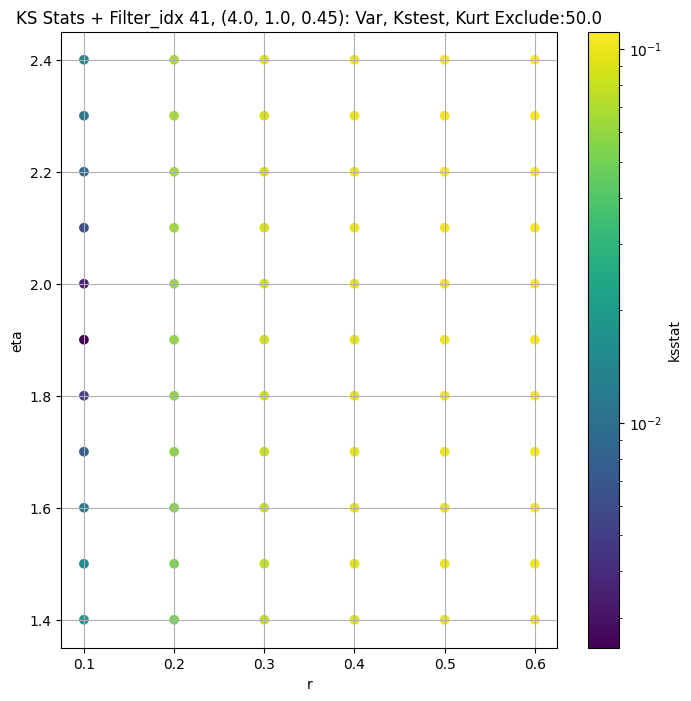

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",119.920680,90.392960,170.642840,10.590433,3.464781,74.931915,160000000.0,"(2.0, 0.5, 0.044)",0.010390,3.7,-1.2,5.594559e+02,0.0,119.920680,0.000107
1,"(2.0, 0.5, 0.065)",47.594410,35.287544,70.195230,16.244356,4.297632,127.499300,160000000.0,"(2.0, 0.5, 0.065)",0.011403,1.3,-1.2,1.728865e+02,50.0,43.814865,0.000107
2,"(2.0, 0.5, 0.096)",21.673610,15.789366,35.630035,23.372608,4.751333,189.667900,160000000.0,"(2.0, 0.5, 0.096)",0.008775,1.3,-1.2,7.774104e+01,50.0,19.702017,0.000107
3,"(2.0, 0.5, 0.141)",8.808341,6.126378,15.579457,28.468450,5.715089,174.328890,160000000.0,"(2.0, 0.5, 0.141)",0.008590,0.6,-1.1,8.484664e+00,100.0,7.460336,0.000107
4,"(2.0, 0.5, 0.208)",3.561086,2.395280,7.824097,44.146633,6.604411,327.389340,160000000.0,"(2.0, 0.5, 0.208)",0.007937,0.3,-0.8,6.175921e-02,0.0,3.561086,0.000107
5,"(2.0, 0.5, 0.306)",1.033891,0.661437,2.774271,82.956276,5.937702,427.047420,160000000.0,"(2.0, 0.5, 0.306)",0.003847,0.1,1.2,1.120879e-15,0.0,1.033891,0.000107
6,"(2.0, 0.5, 0.45)",0.608527,0.399818,1.869624,99.041620,5.892619,468.845900,160000000.0,"(2.0, 0.5, 0.45)",0.002096,0.1,1.5,2.637749e-16,0.0,0.608527,0.000107
7,"(2.0, 1.0, 0.044)",166.012740,126.613090,245.244550,12.991724,3.800807,110.412130,160000000.0,"(2.0, 1.0, 0.044)",0.010354,3.7,-1.2,7.744853e+02,0.0,166.012740,0.000107
8,"(2.0, 1.0, 0.065)",65.958330,48.032578,106.776000,17.634312,4.299627,133.457060,160000000.0,"(2.0, 1.0, 0.065)",0.008816,2.6,-1.2,2.675942e+02,100.0,57.891792,0.000107


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.011841509856366894, var: 108.34026336669922


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.01207142701567776, var: 110.17442321777344


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.012332853211079686, var: 112.3001480102539


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.01184145074711862, var: 114.94210052490234


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.010389842018879769, var: 119.9206771850586
Number of samples: 100000, Without approximation : 160000000.0


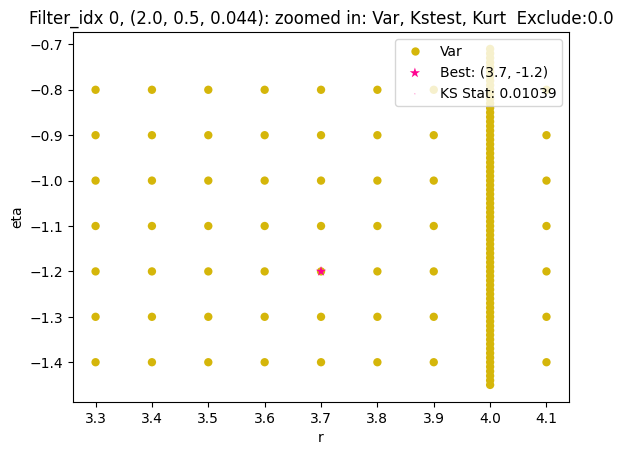

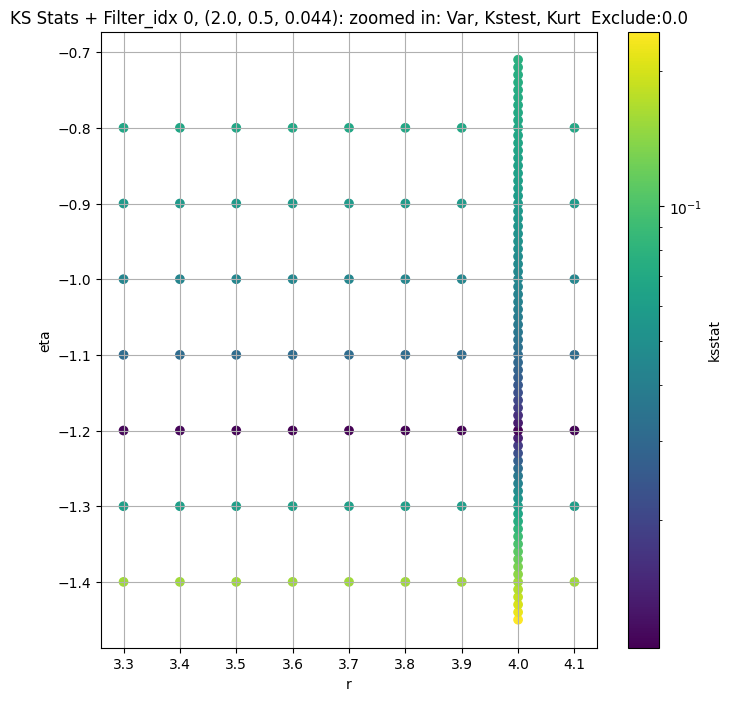

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 1, 50.0 + 100 = 150, ksstat: 0.011410150113613737, var: 40.54677200317383


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 1, 50.0 + 75 = 125, ksstat: 0.011365298419133418, var: 41.223873138427734


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 1, 50.0 + 50 = 100, ksstat: 0.011125179182859046, var: 41.97234344482422


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 1, 50.0 + 25 = 75, ksstat: 0.010124652235129261, var: 42.819679260253906


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 1, 50.0 + 0 = 50, ksstat: 0.010150728664919395, var: 43.81486511230469


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 1, 50.0 + -25 = 25, ksstat: 0.01010792457224663, var: 45.07442855834961


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 1, 50.0 + -50 = 0, ksstat: 0.009046903522905492, var: 47.59440994262695
Number of samples: 100000, Without approximation : 160000000.0


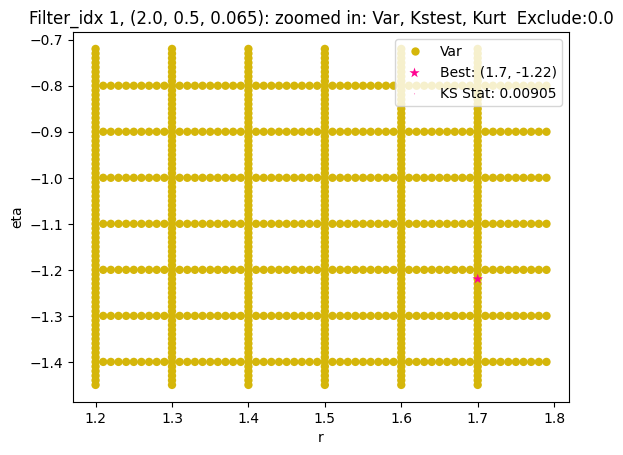

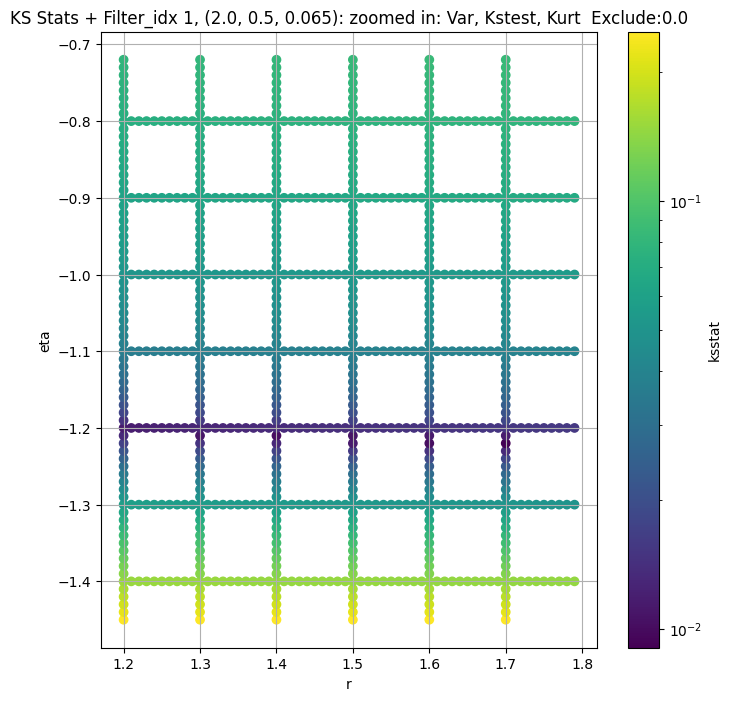

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 2, 50.0 + 100 = 150, ksstat: 0.008722570372205252, var: 18.13200569152832


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 2, 50.0 + 75 = 125, ksstat: 0.008632382416060791, var: 18.456222534179688


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 2, 50.0 + 50 = 100, ksstat: 0.008332514724493423, var: 18.815195083618164


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 2, 50.0 + 25 = 75, ksstat: 0.008724221577290636, var: 19.222068786621094


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 2, 50.0 + 0 = 50, ksstat: 0.008591927974384572, var: 19.702016830444336


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 2, 50.0 + -25 = 25, ksstat: 0.008392552244904317, var: 20.314998626708984


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 2, 50.0 + -50 = 0, ksstat: 0.008638697135530449, var: 21.67361068725586
Number of samples: 100000, Without approximation : 160000000.0


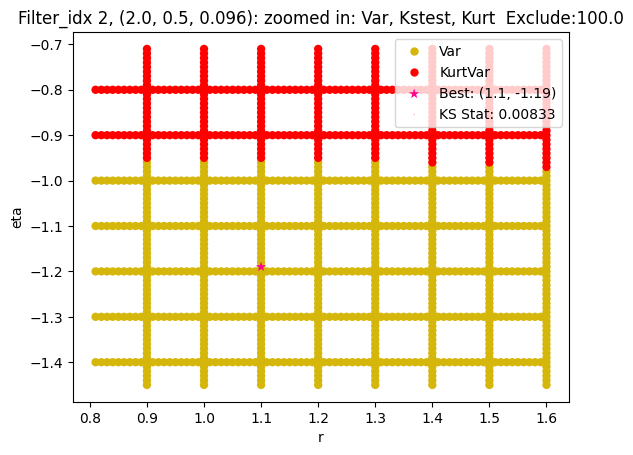

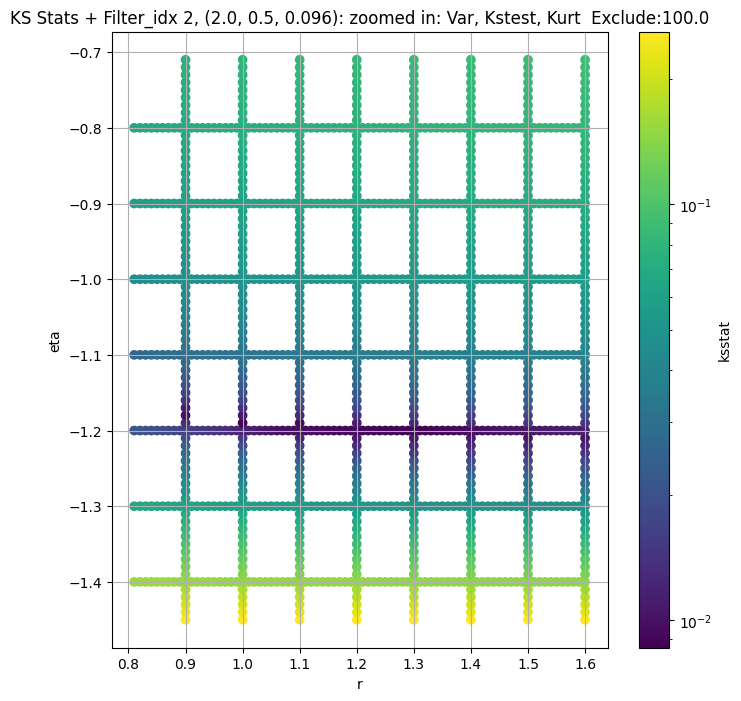

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + 100 = 200, ksstat: 0.008692702995044072, var: 6.890198230743408


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + 75 = 175, ksstat: 0.007970546316083515, var: 7.013525009155273


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + 50 = 150, ksstat: 0.00835698827508824, var: 7.147583961486816


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + 25 = 125, ksstat: 0.008333912637290553, var: 7.295144081115723


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + 0 = 100, ksstat: 0.008123318110158761, var: 7.460335731506348


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + -25 = 75, ksstat: 0.008030688946274955, var: 7.64973783493042


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + -50 = 50, ksstat: 0.007224999775873042, var: 7.875829696655273


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + -75 = 25, ksstat: 0.0074251739360057245, var: 8.168255805969238


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 100.0 + -100 = 0, ksstat: 0.006918514489999805, var: 8.808341026306152
Number of samples: 100000, Without approximation : 160000000.0


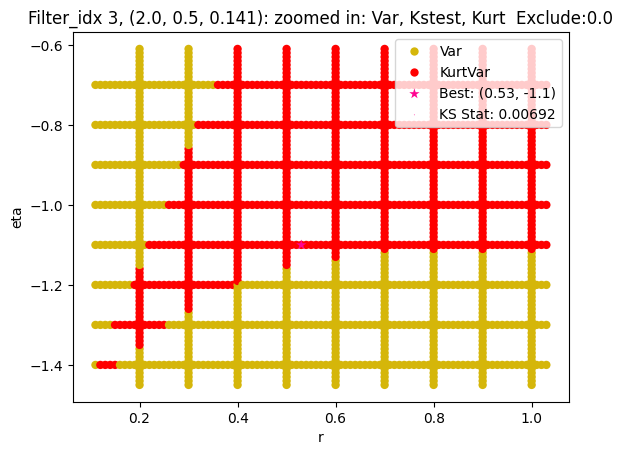

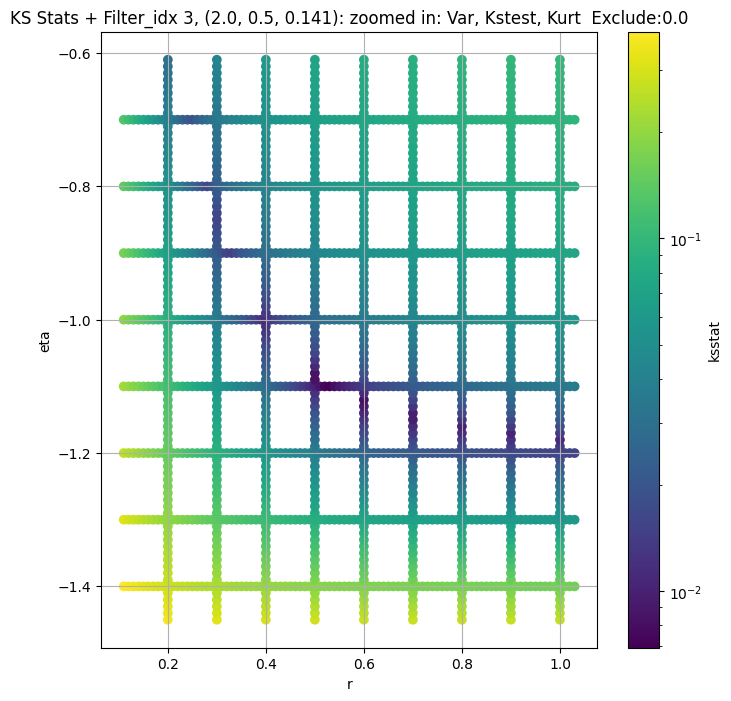

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 0.0 + 100 = 100, ksstat: 0.007909554542242292, var: 2.9733190536499023


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 0.0 + 75 = 75, ksstat: 0.0074020336662341535, var: 3.0519258975982666


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 0.0 + 50 = 50, ksstat: 0.006646676056745071, var: 3.1458089351654053


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 0.0 + 25 = 25, ksstat: 0.0070590753522792316, var: 3.2674498558044434


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 0.0 + 0 = 0, ksstat: 0.006638126103221342, var: 3.5610857009887695
Number of samples: 100000, Without approximation : 160000000.0


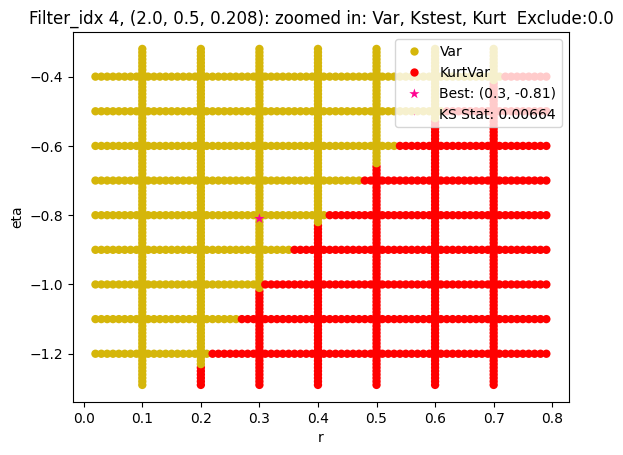

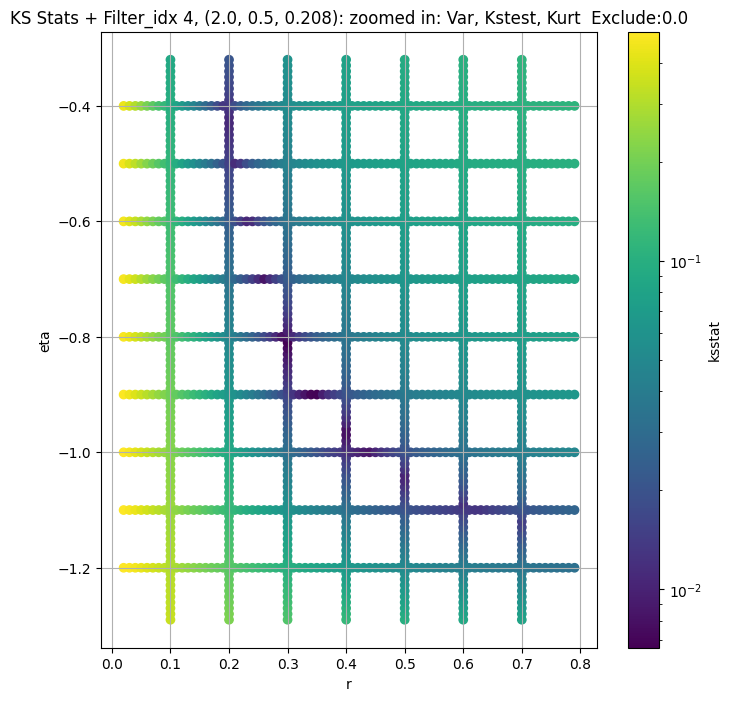

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.007627024243132663, var: 0.8331885933876038


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.007607220039716145, var: 0.8570818901062012


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.0064547148436360224, var: 0.8860670328140259


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.005604799754242551, var: 0.9244531393051147


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.0038473966762069406, var: 1.033890962600708
Number of samples: 100000, Without approximation : 160000000.0


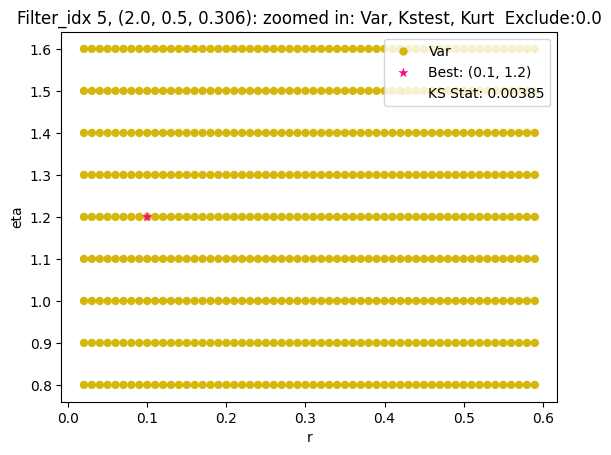

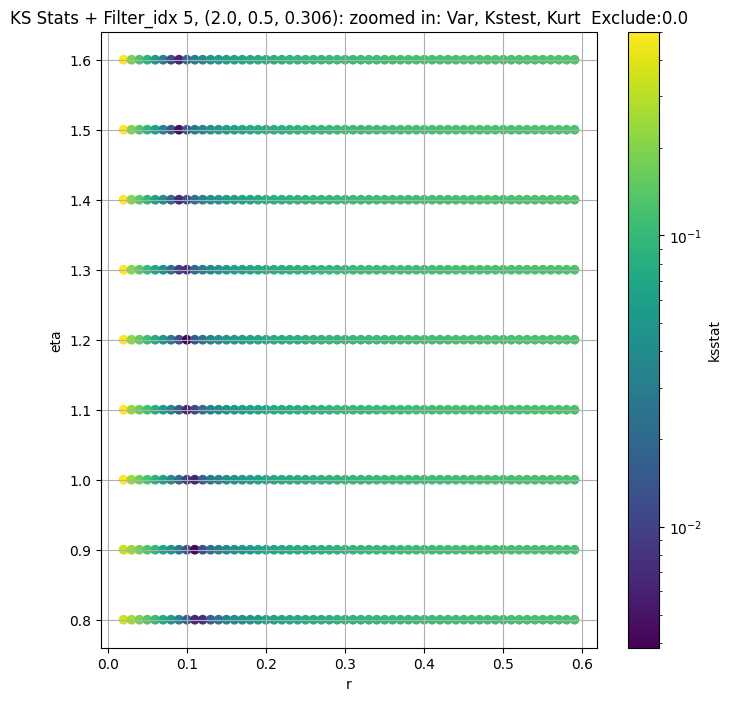

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 100 = 100, ksstat: 0.0062023684707139815, var: 0.4896186590194702


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 75 = 75, ksstat: 0.005261745033072085, var: 0.5030102729797363


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 50 = 50, ksstat: 0.004504775276995096, var: 0.519292950630188


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 25 = 25, ksstat: 0.004088089572454323, var: 0.5410401821136475


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 0 = 0, ksstat: 0.0018564058566908487, var: 0.608526885509491
Number of samples: 100000, Without approximation : 160000000.0


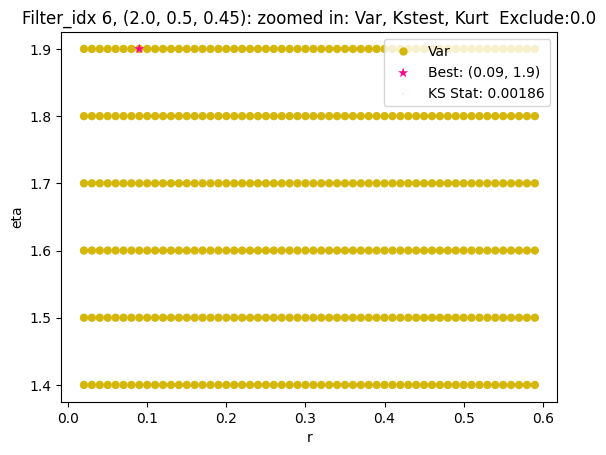

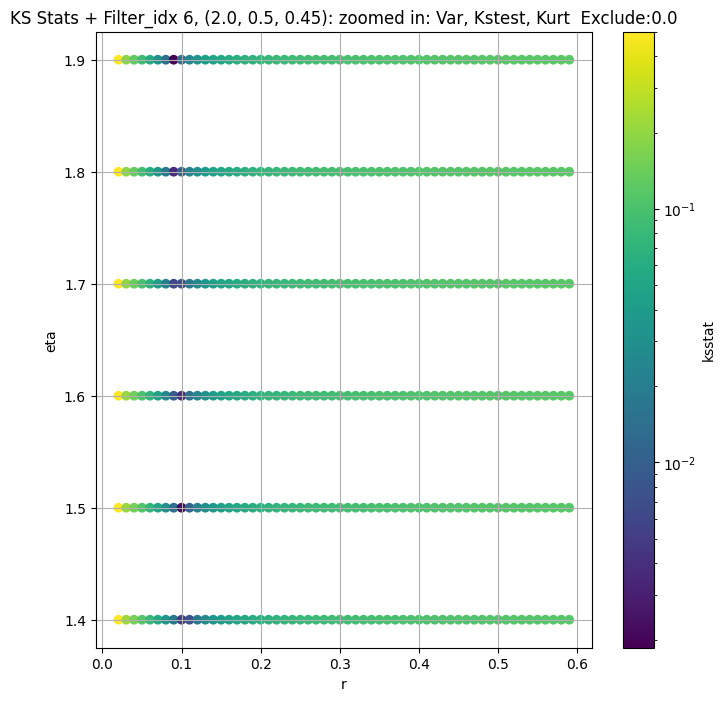

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.011689616218307775, var: 148.77392578125


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.011914520565358688, var: 151.40220642089844


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.01217114048309953, var: 154.46694946289062


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.011924065370479409, var: 158.3001251220703


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.010354484888179805, var: 166.0127410888672
Number of samples: 100000, Without approximation : 160000000.0


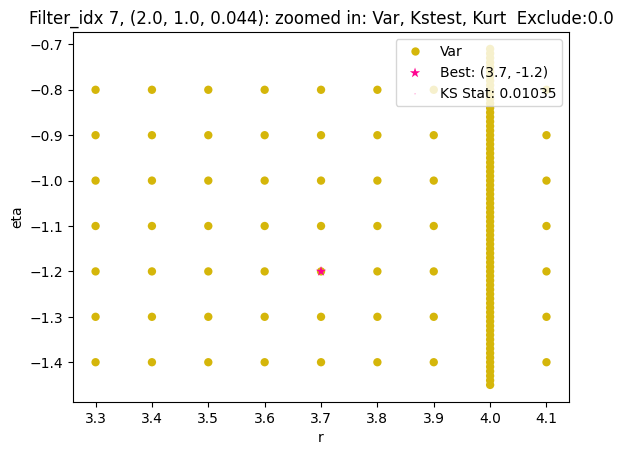

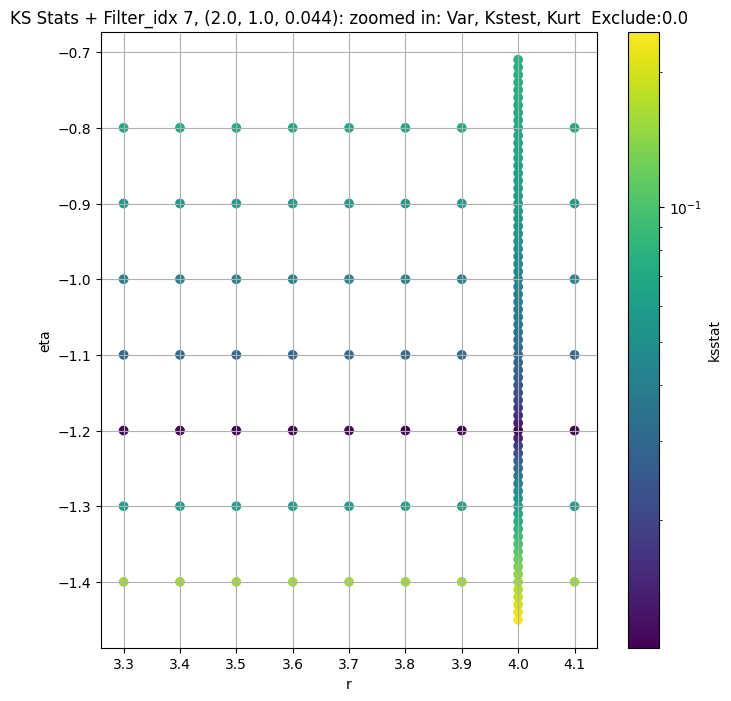

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + 100 = 200, ksstat: 0.010520179755333647, var: 54.22296142578125


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + 75 = 175, ksstat: 0.009852327296895502, var: 55.02694320678711


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + 50 = 150, ksstat: 0.009151182865325569, var: 55.894493103027344


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + 25 = 125, ksstat: 0.00885942435028969, var: 56.84159469604492


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + 0 = 100, ksstat: 0.008816331615557838, var: 57.89179229736328


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + -25 = 75, ksstat: 0.00885195266448846, var: 59.083126068115234


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + -50 = 50, ksstat: 0.008865730194154486, var: 60.487396240234375


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + -75 = 25, ksstat: 0.009319447989075247, var: 62.2744255065918


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 8, 100.0 + -100 = 0, ksstat: 0.012091800689233545, var: 65.95832824707031
Number of samples: 100000, Without approximation : 160000000.0


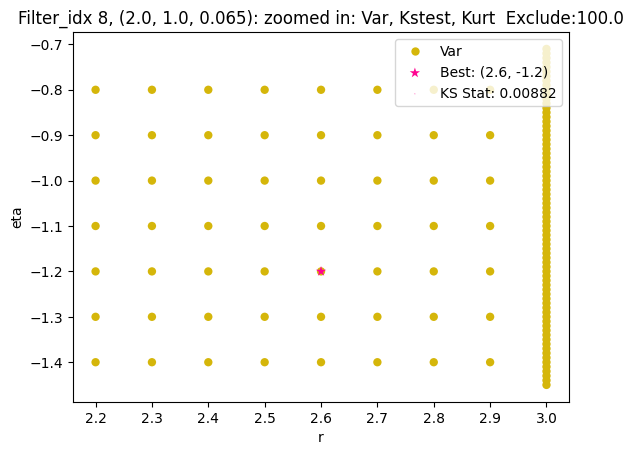

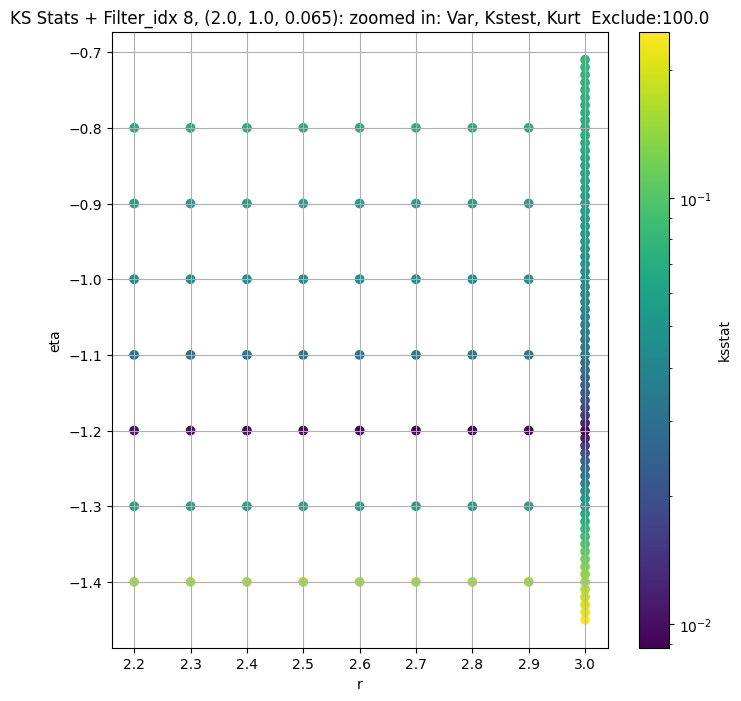

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + 100 = 300, ksstat: 0.007182389421927338, var: 21.00340461730957


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + 75 = 275, ksstat: 0.007130860518015175, var: 21.273517608642578


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + 50 = 250, ksstat: 0.008000138930529532, var: 21.558170318603516


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + 25 = 225, ksstat: 0.0082556829833495, var: 21.85945701599121


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + 0 = 200, ksstat: 0.008178347184874701, var: 22.18022346496582


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + -25 = 175, ksstat: 0.009057106985039476, var: 22.523906707763672


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + -50 = 150, ksstat: 0.010062095871628152, var: 22.895179748535156


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + -75 = 125, ksstat: 0.00997015724937722, var: 23.300762176513672


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 9, 200.0 + -100 = 100, ksstat: 0.010916386877660167, var: 23.750764846801758
Number of samples: 100000, Without approximation : 160000000.0


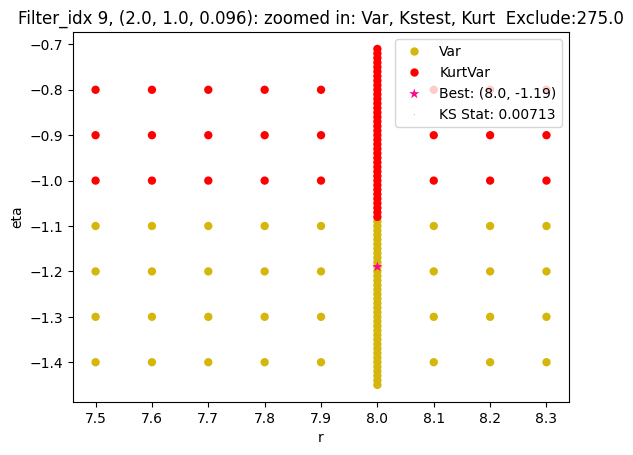

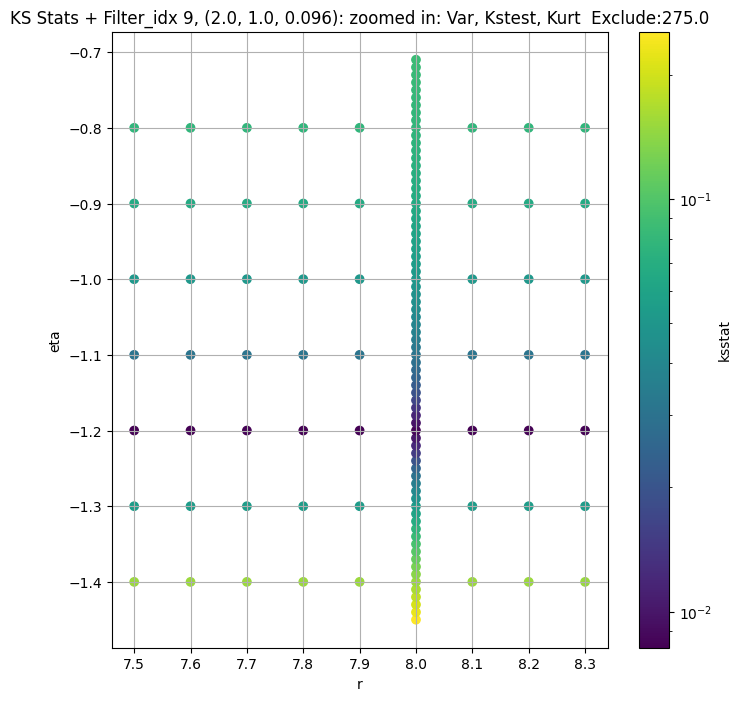

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 50.0 + 100 = 150, ksstat: 0.007472015593521342, var: 9.914651870727539


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 50.0 + 75 = 125, ksstat: 0.006377795635320815, var: 10.111741065979004


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 50.0 + 50 = 100, ksstat: 0.0065012741388776885, var: 10.331049919128418


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 50.0 + 25 = 75, ksstat: 0.007211140197067811, var: 10.580533027648926


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 50.0 + 0 = 50, ksstat: 0.007088837332585363, var: 10.875903129577637


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 50.0 + -25 = 25, ksstat: 0.006789268770434842, var: 11.255332946777344


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 50.0 + -50 = 0, ksstat: 0.00638236400103398, var: 12.157529830932617
Number of samples: 100000, Without approximation : 160000000.0


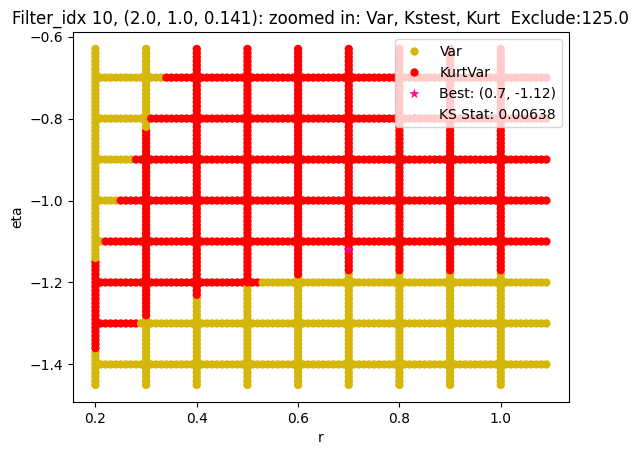

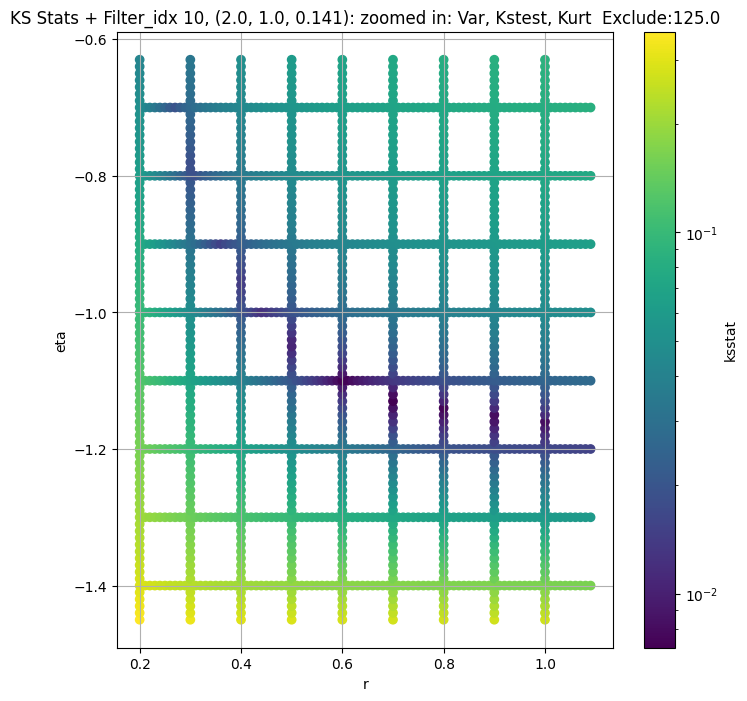

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.006956922114279451, var: 3.8823208808898926


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.006569874494132766, var: 3.9931609630584717


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.006276878946606446, var: 4.126582622528076


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.0063322576268494135, var: 4.301181316375732


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.006281970028184536, var: 4.7186970710754395
Number of samples: 100000, Without approximation : 160000000.0


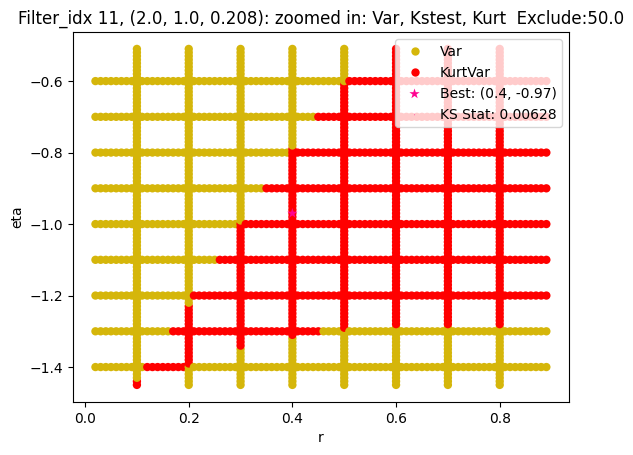

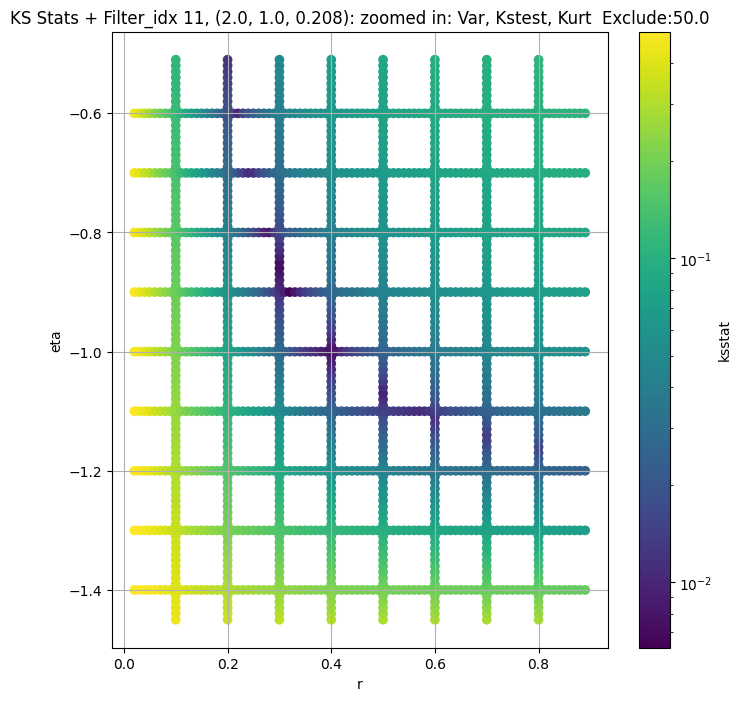

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.005530945546449173, var: 1.3065223693847656


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.005459316716915741, var: 1.3448781967163086


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.005199270137032752, var: 1.3914604187011719


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.004976402409245573, var: 1.4533686637878418


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.0043329976066347475, var: 1.6281819343566895
Number of samples: 100000, Without approximation : 160000000.0


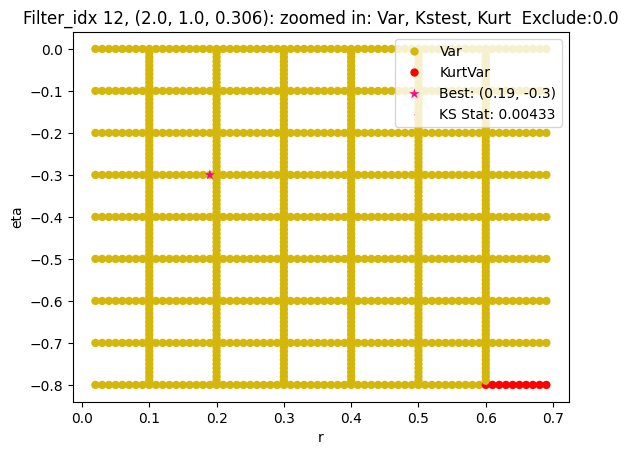

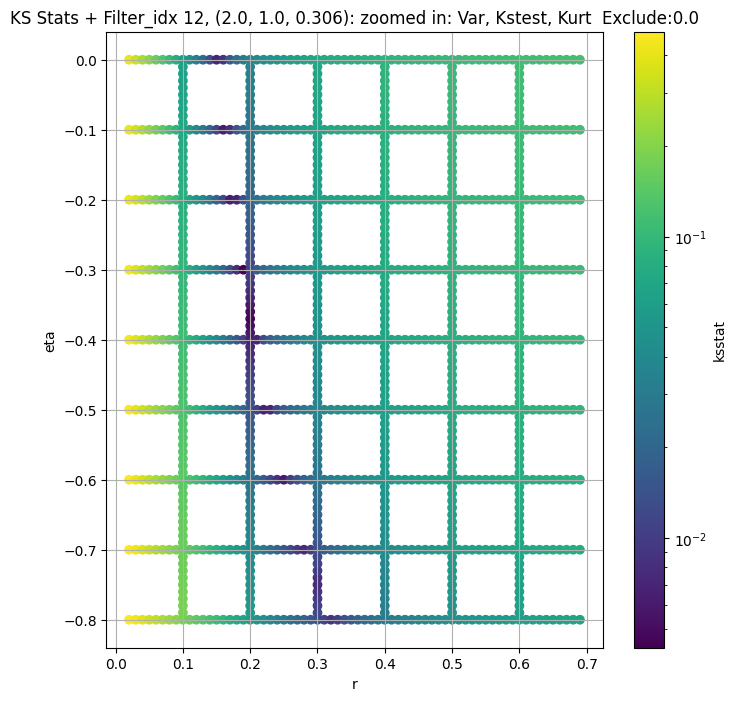

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 100 = 100, ksstat: 0.005999242344371103, var: 0.46830418705940247


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 75 = 75, ksstat: 0.005286693523381181, var: 0.48109427094459534


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 50 = 50, ksstat: 0.004653804070177361, var: 0.4966205358505249


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 25 = 25, ksstat: 0.0036639510914051737, var: 0.5172988176345825


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 0 = 0, ksstat: 0.002144361002166084, var: 0.5886774063110352
Number of samples: 100000, Without approximation : 160000000.0


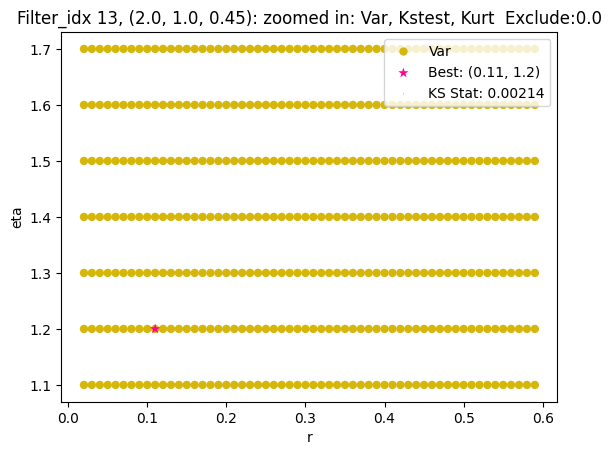

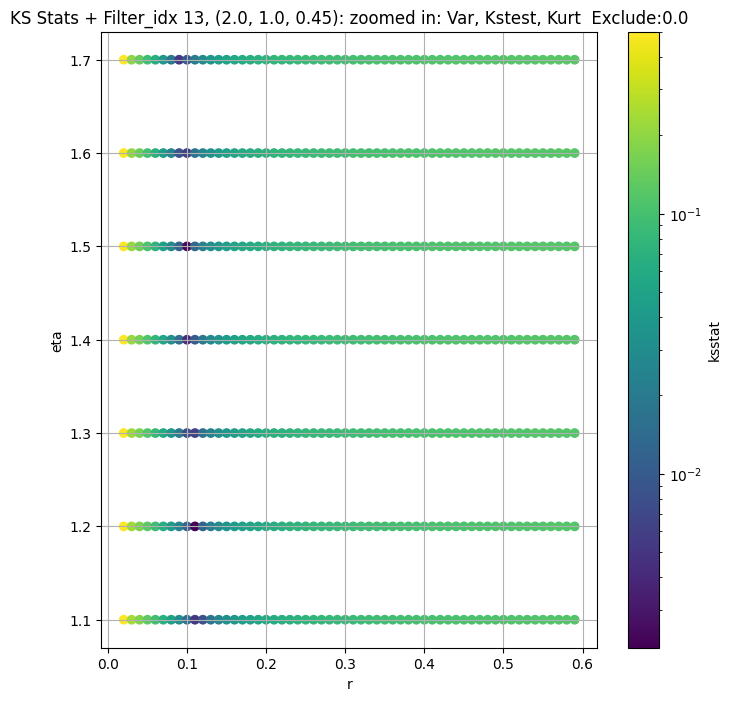

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + 100 = 200, ksstat: 0.010486047706594503, var: 97.61615753173828


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + 75 = 175, ksstat: 0.010464041612775365, var: 98.98660278320312


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + 50 = 150, ksstat: 0.010433003144278752, var: 100.45674133300781


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + 25 = 125, ksstat: 0.01041300868265238, var: 102.05033874511719


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + 0 = 100, ksstat: 0.009801747173251052, var: 103.80155944824219


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + -25 = 75, ksstat: 0.009059597475441605, var: 105.7666015625


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + -50 = 50, ksstat: 0.009120183308809482, var: 108.0500717163086


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + -75 = 25, ksstat: 0.009184259779913495, var: 110.90771484375


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 14, 100.0 + -100 = 0, ksstat: 0.008458678432910927, var: 116.50106811523438
Number of samples: 100000, Without approximation : 160000000.0


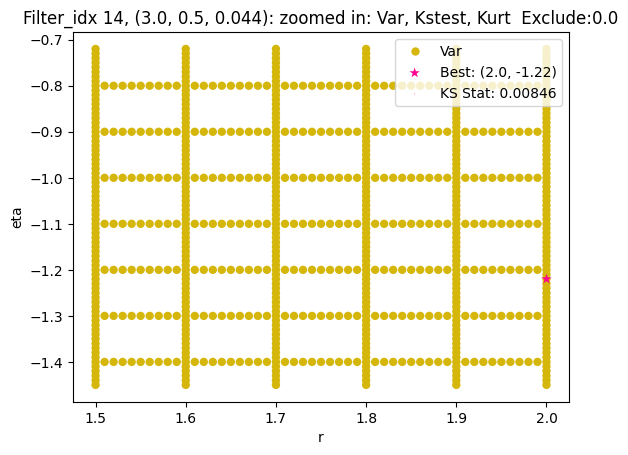

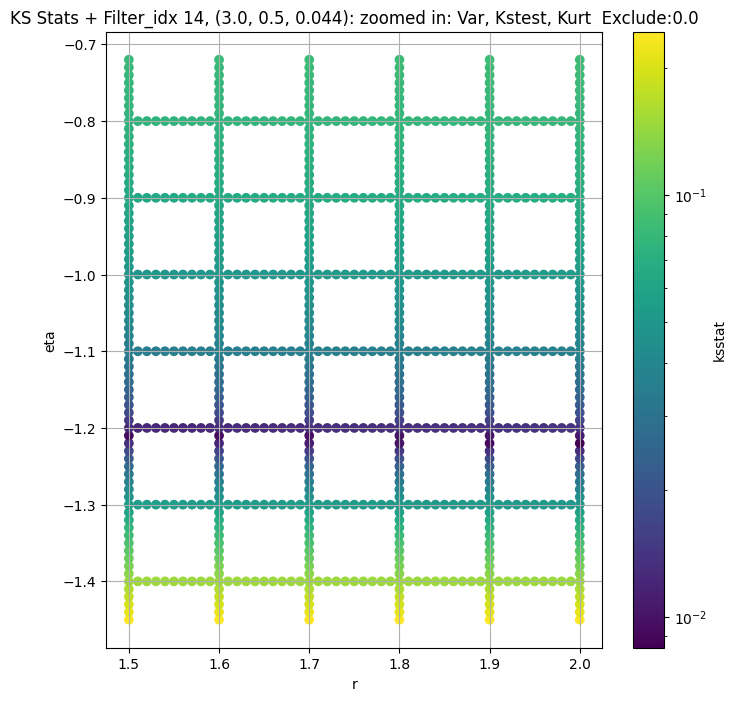

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 100 = 150, ksstat: 0.009021562249277082, var: 41.490352630615234


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 75 = 125, ksstat: 0.008642123335903085, var: 42.19270706176758


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 50 = 100, ksstat: 0.008979269241507937, var: 42.96696472167969


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 25 = 75, ksstat: 0.008523927419116395, var: 43.83910369873047


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 0 = 50, ksstat: 0.008950406901227947, var: 44.85881423950195


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + -25 = 25, ksstat: 0.00847169744893106, var: 46.1491813659668


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + -50 = 0, ksstat: 0.008303675500123175, var: 48.885196685791016
Number of samples: 100000, Without approximation : 160000000.0


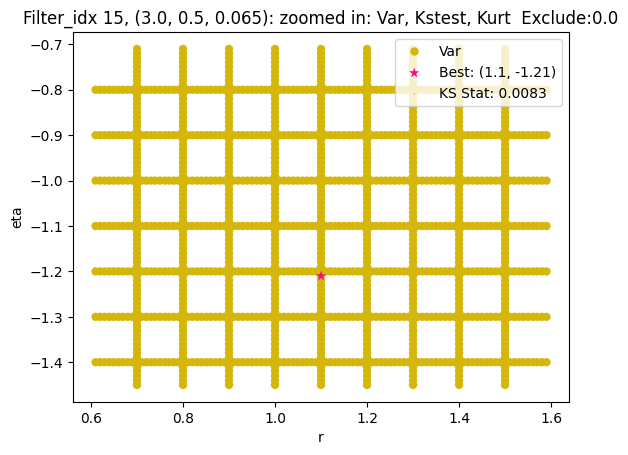

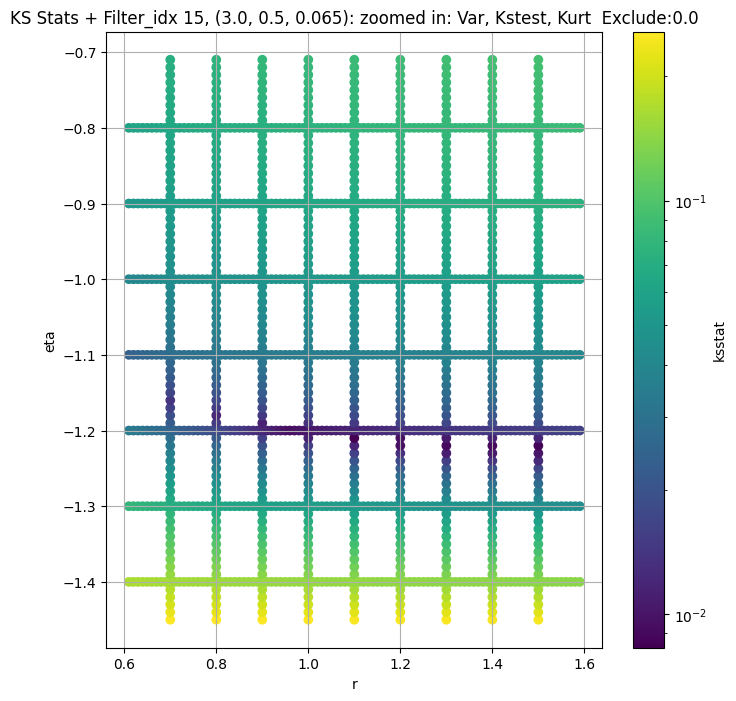

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 100 = 300, ksstat: 0.009312808908949588, var: 15.597818374633789


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 75 = 275, ksstat: 0.00955632780843857, var: 15.824197769165039


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 50 = 250, ksstat: 0.00991515001274057, var: 16.0631046295166


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 25 = 225, ksstat: 0.009931999272367098, var: 16.31640625


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 0 = 200, ksstat: 0.010019490383386065, var: 16.586257934570312


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + -25 = 175, ksstat: 0.009711337605777137, var: 16.875518798828125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + -50 = 150, ksstat: 0.00956391808575352, var: 17.188207626342773


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + -75 = 125, ksstat: 0.009444507814814429, var: 17.529430389404297


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + -100 = 100, ksstat: 0.009334004226332016, var: 17.907520294189453
Number of samples: 100000, Without approximation : 160000000.0


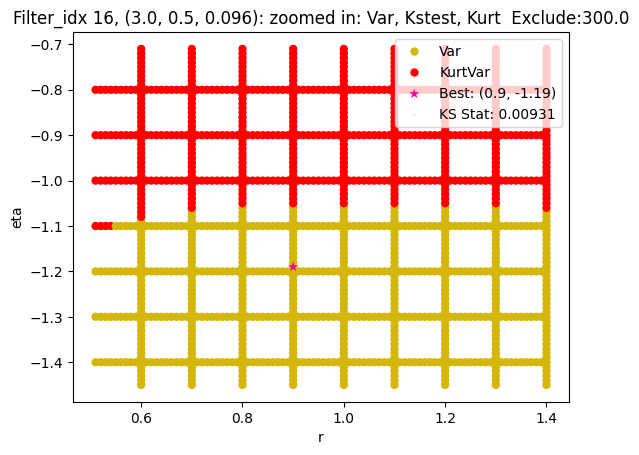

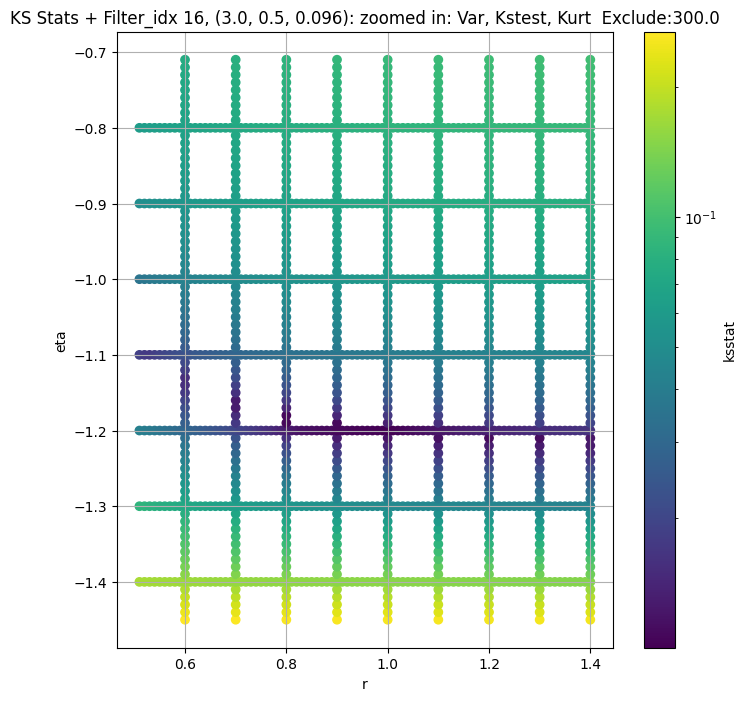

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 100 = 150, ksstat: 0.009557309390357038, var: 6.749610900878906


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 75 = 125, ksstat: 0.009246953569428173, var: 6.896987438201904


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 50 = 100, ksstat: 0.008925241962923325, var: 7.061570644378662


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 25 = 75, ksstat: 0.00851822068877539, var: 7.249383449554443


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 0 = 50, ksstat: 0.008181515314750865, var: 7.471786975860596


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + -25 = 25, ksstat: 0.00823355946337867, var: 7.756700038909912


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + -50 = 0, ksstat: 0.008419949261309068, var: 8.425982475280762
Number of samples: 100000, Without approximation : 160000000.0


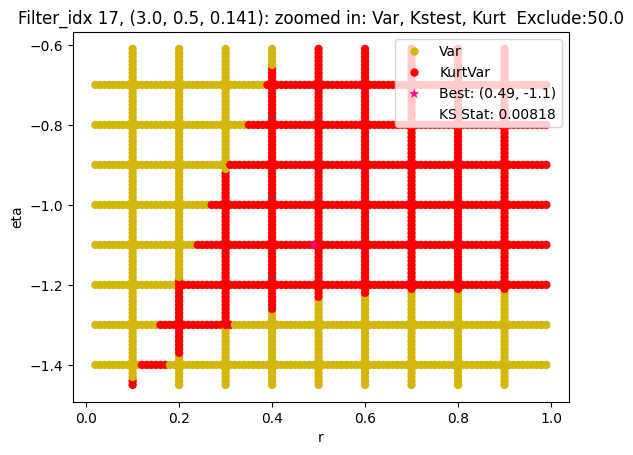

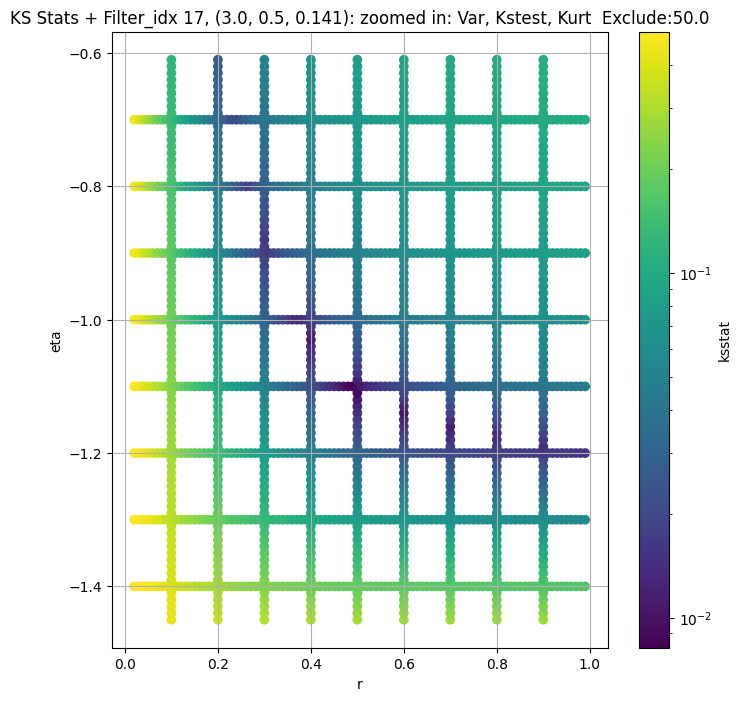

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 0.0 + 100 = 100, ksstat: 0.007979943734579442, var: 2.740345001220703


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 0.0 + 75 = 75, ksstat: 0.007991895003638949, var: 2.822026252746582


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 0.0 + 50 = 50, ksstat: 0.007219241368930818, var: 2.920149803161621


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 0.0 + 25 = 25, ksstat: 0.006846229933651582, var: 3.0480008125305176


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 0.0 + 0 = 0, ksstat: 0.006842978043295367, var: 3.3330612182617188
Number of samples: 100000, Without approximation : 160000000.0


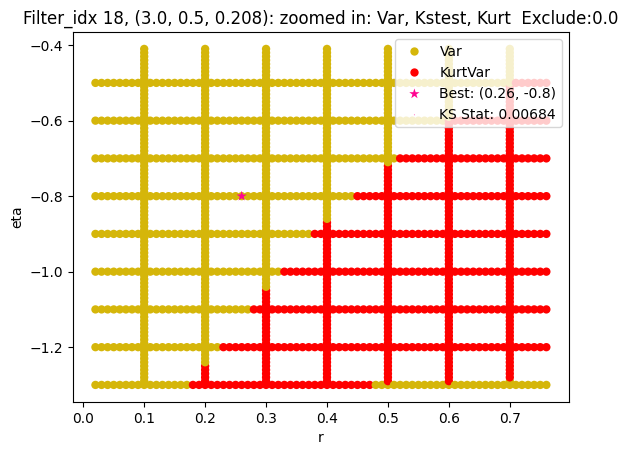

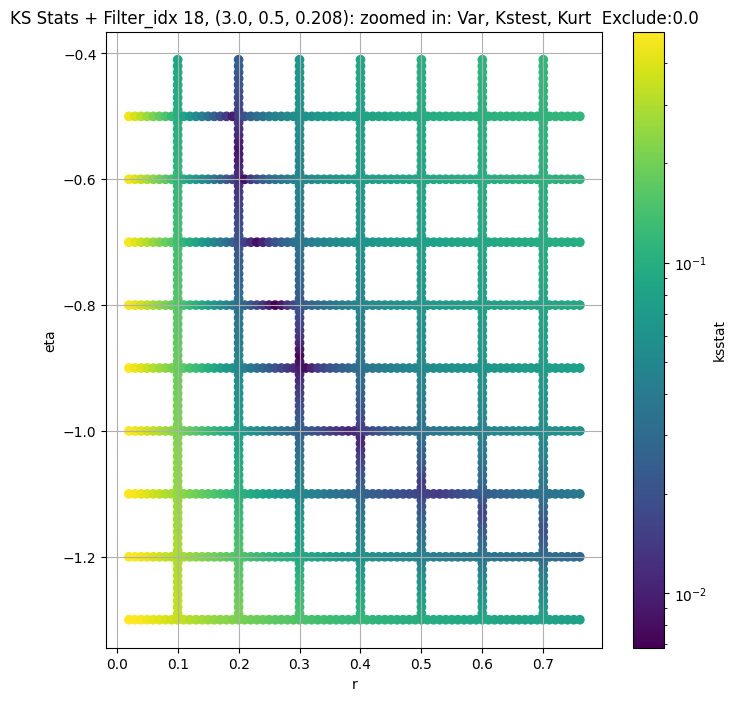

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.0066010435620807995, var: 0.7651845216751099


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.006421739999993292, var: 0.7895063161849976


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.006331876610913237, var: 0.819226861000061


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.005214295500532096, var: 0.8590507507324219


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.004644542072320568, var: 0.9693490862846375
Number of samples: 100000, Without approximation : 160000000.0


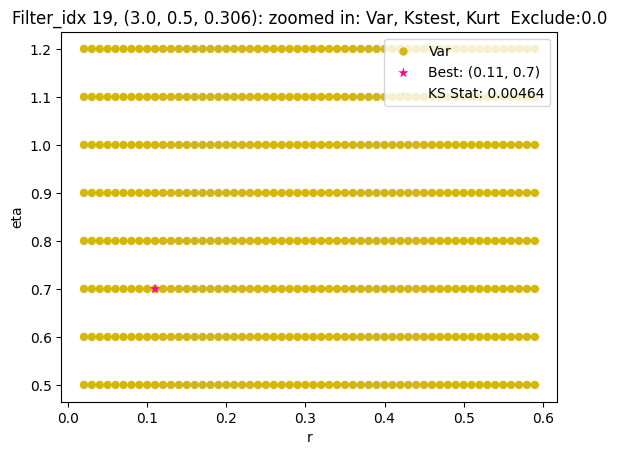

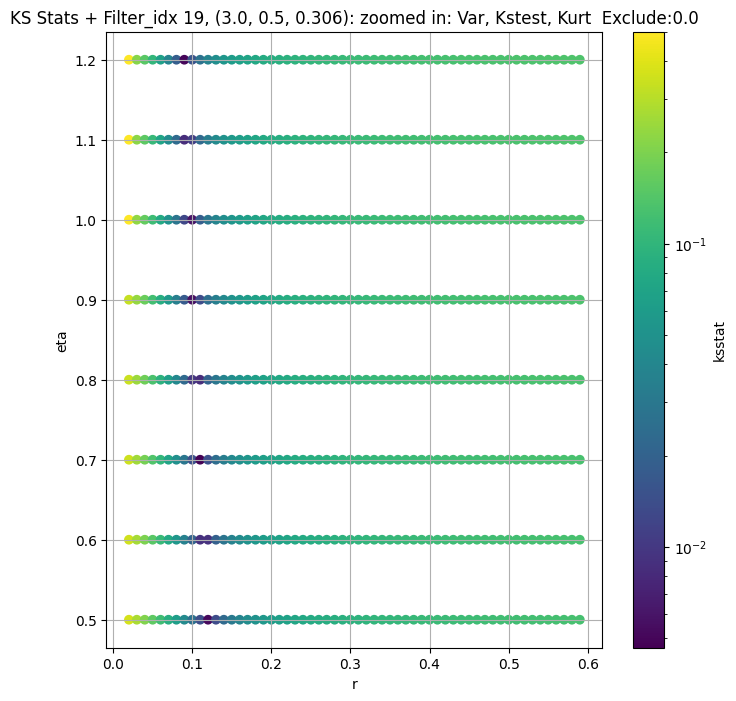

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 100 = 150, ksstat: 0.00583748324018097, var: 0.2607768476009369


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 75 = 125, ksstat: 0.00535989264678445, var: 0.2665903568267822


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 50 = 100, ksstat: 0.005030434745823209, var: 0.2731885015964508


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 25 = 75, ksstat: 0.004336114976592698, var: 0.28089919686317444


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 0 = 50, ksstat: 0.003418705702001236, var: 0.2903708517551422


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + -25 = 25, ksstat: 0.0026820581762868057, var: 0.3032890856266022


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + -50 = 0, ksstat: 0.0032951102825323764, var: 0.34720543026924133
Number of samples: 100000, Without approximation : 160000000.0


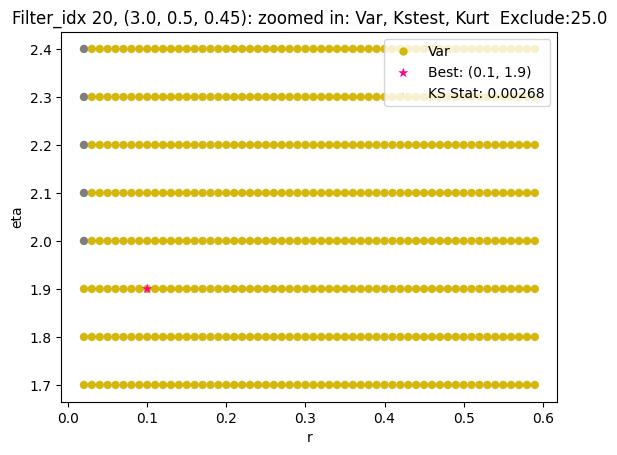

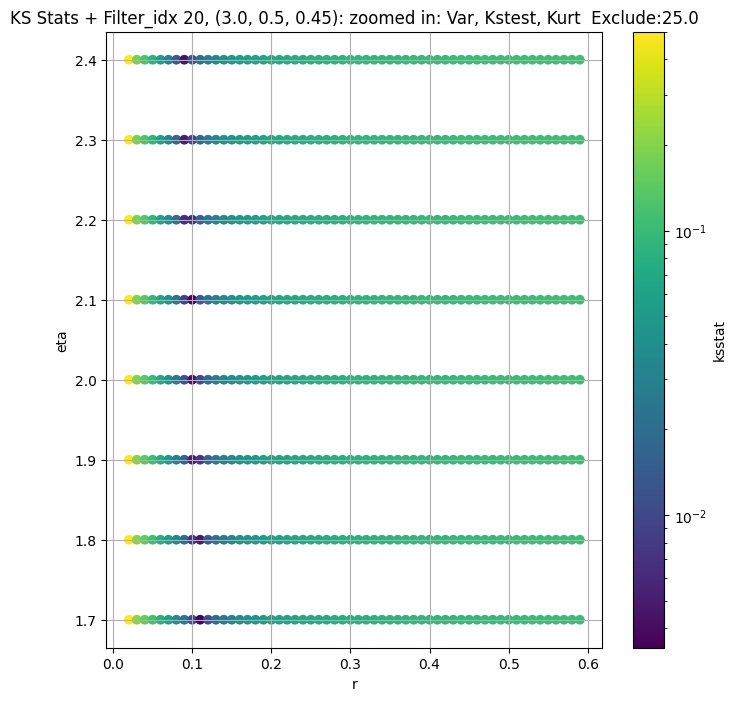

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 21, 50.0 + 100 = 150, ksstat: 0.007977131384907743, var: 119.90673828125


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 21, 50.0 + 75 = 125, ksstat: 0.007963317988752938, var: 121.90731048583984


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 21, 50.0 + 50 = 100, ksstat: 0.00794855230359881, var: 124.11669158935547


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 21, 50.0 + 25 = 75, ksstat: 0.007922233180420235, var: 126.60585021972656


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 21, 50.0 + 0 = 50, ksstat: 0.007889991477430303, var: 129.5083770751953


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 21, 50.0 + -25 = 25, ksstat: 0.007098409948525619, var: 133.15603637695312


  0%|          | 0/1242 [00:00<?, ?it/s]

Finding Minimum after computing 1242 CDFs
filter_idx 21, 50.0 + -50 = 0, ksstat: 0.007795659476628525, var: 140.48550415039062
Number of samples: 100000, Without approximation : 160000000.0


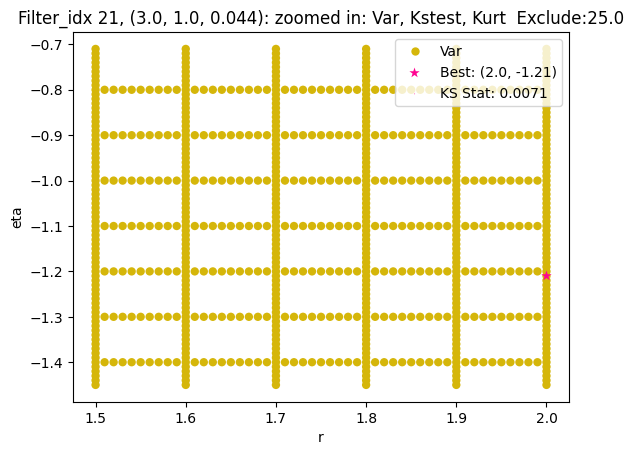

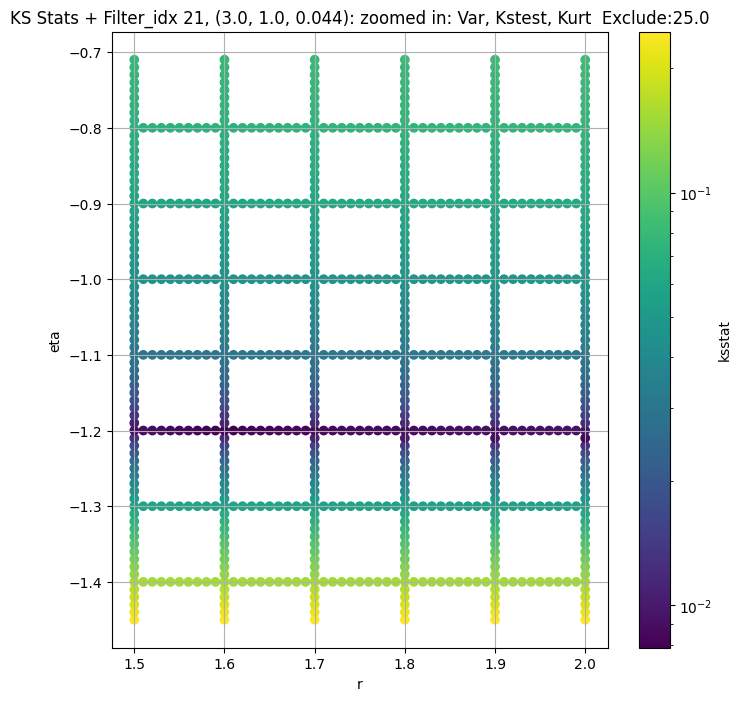

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 50.0 + 100 = 150, ksstat: 0.0075871704314710575, var: 45.03157043457031


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 50.0 + 75 = 125, ksstat: 0.007573306626890042, var: 45.8184700012207


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 50.0 + 50 = 100, ksstat: 0.00753339923540669, var: 46.688106536865234


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 50.0 + 25 = 75, ksstat: 0.0074371888607933645, var: 47.67123031616211


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 50.0 + 0 = 50, ksstat: 0.007395386017306105, var: 48.82628631591797


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 50.0 + -25 = 25, ksstat: 0.007275771587450908, var: 50.29122543334961


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 50.0 + -50 = 0, ksstat: 0.007172566953828896, var: 53.49868392944336
Number of samples: 100000, Without approximation : 160000000.0


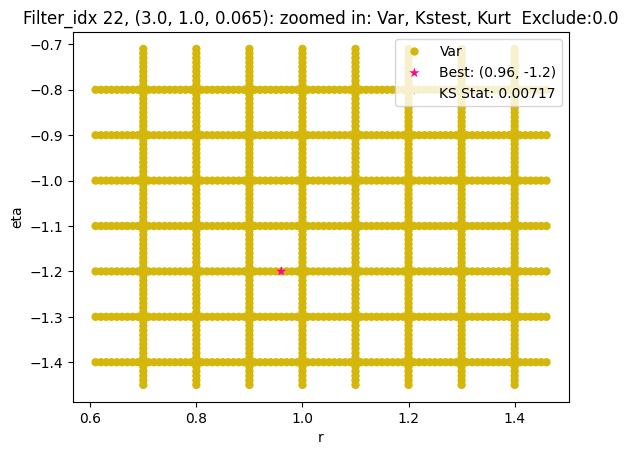

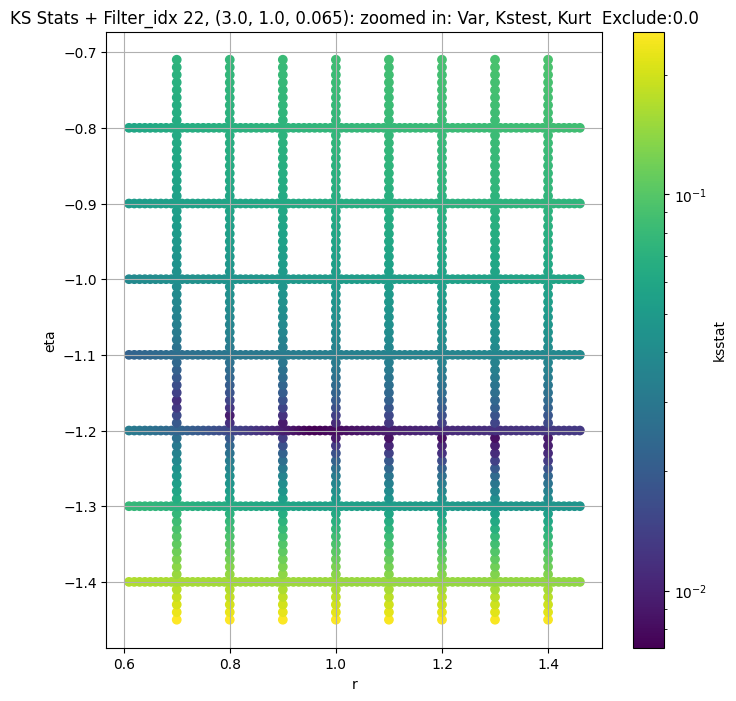

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + 100 = 200, ksstat: 0.008513183837313587, var: 19.32596206665039


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + 75 = 175, ksstat: 0.008505255247519605, var: 19.639982223510742


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + 50 = 150, ksstat: 0.00841959054439706, var: 19.978065490722656


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + 25 = 125, ksstat: 0.0084789118534076, var: 20.345489501953125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + 0 = 100, ksstat: 0.008586244110590058, var: 20.750173568725586


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + -25 = 75, ksstat: 0.008476774822325728, var: 21.205175399780273


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + -50 = 50, ksstat: 0.008505955475823113, var: 21.734434127807617


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + -75 = 25, ksstat: 0.0088123105473909, var: 22.39340591430664


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 100.0 + -100 = 0, ksstat: 0.009021504151080384, var: 23.71412467956543
Number of samples: 100000, Without approximation : 160000000.0


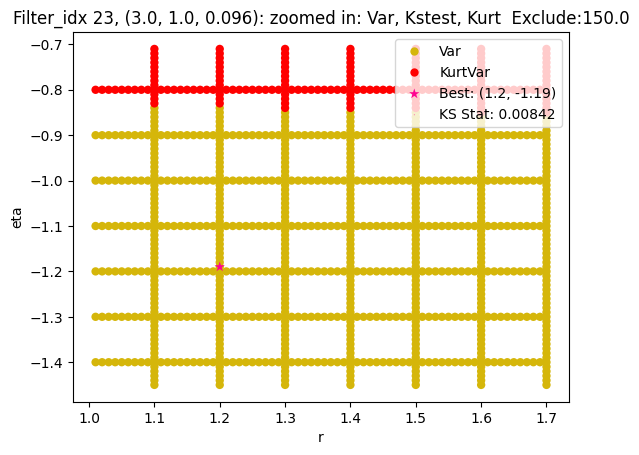

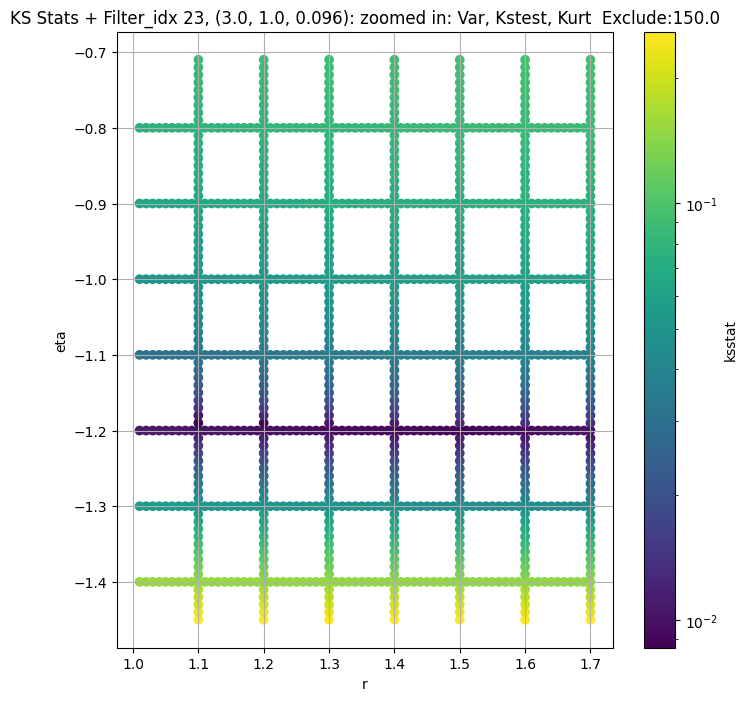

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 50.0 + 100 = 150, ksstat: 0.0078339103988503, var: 8.005401611328125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 50.0 + 75 = 125, ksstat: 0.007532439662023771, var: 8.185409545898438


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 50.0 + 50 = 100, ksstat: 0.007649286782169806, var: 8.386857032775879


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 50.0 + 25 = 75, ksstat: 0.007806598931087039, var: 8.61799430847168


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 50.0 + 0 = 50, ksstat: 0.007692771594670855, var: 8.8939847946167


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 50.0 + -25 = 25, ksstat: 0.0077403434443593655, var: 9.251038551330566


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 50.0 + -50 = 0, ksstat: 0.007191315273475357, var: 10.035672187805176
Number of samples: 100000, Without approximation : 160000000.0


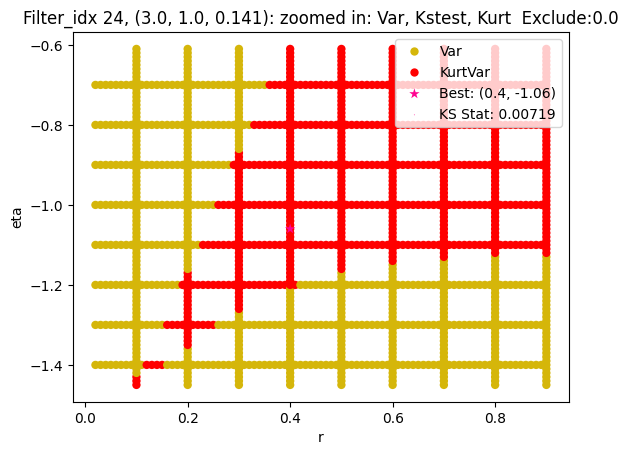

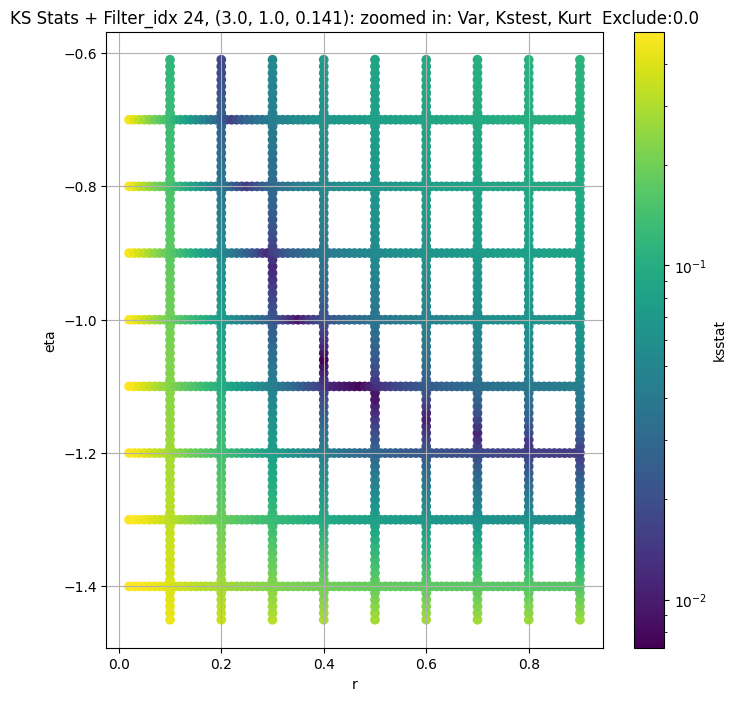

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + 100 = 200, ksstat: 0.008503500326861646, var: 2.8761277198791504


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + 75 = 175, ksstat: 0.00883997961962224, var: 2.938373565673828


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + 50 = 150, ksstat: 0.008624927600573928, var: 3.0065183639526367


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + 25 = 125, ksstat: 0.008953769430889547, var: 3.082058906555176


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + 0 = 100, ksstat: 0.008844827680999257, var: 3.1672604084014893


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + -25 = 75, ksstat: 0.00863168035730022, var: 3.2658393383026123


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + -50 = 50, ksstat: 0.007194571244291348, var: 3.3849170207977295


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + -75 = 25, ksstat: 0.007550723352754529, var: 3.5417838096618652


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 25, 100.0 + -100 = 0, ksstat: 0.007357380240051836, var: 3.908169746398926
Number of samples: 100000, Without approximation : 160000000.0


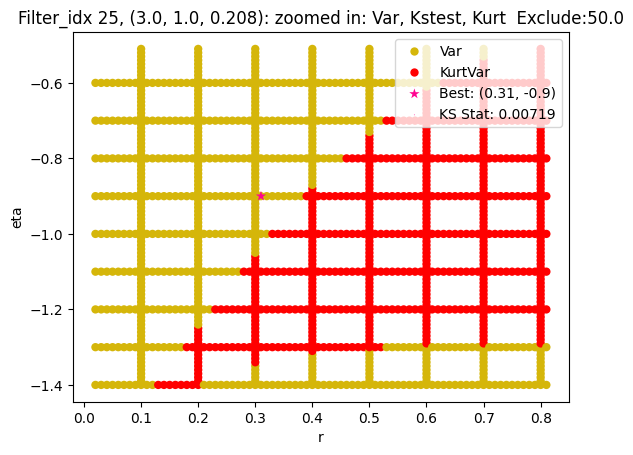

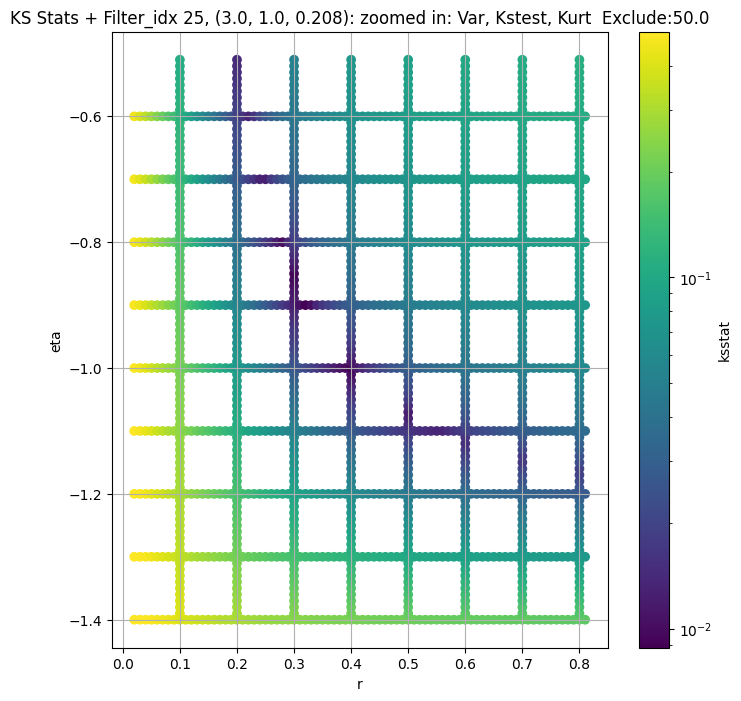

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.007192026685528763, var: 0.953919529914856


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.0072798352416418854, var: 0.985824704170227


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.005572543573457156, var: 1.0249528884887695


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.004919859758258149, var: 1.0777802467346191


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.004763484712848487, var: 1.2336318492889404
Number of samples: 100000, Without approximation : 160000000.0


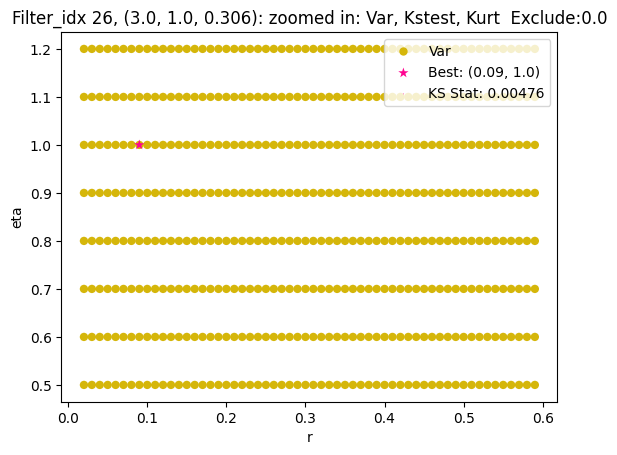

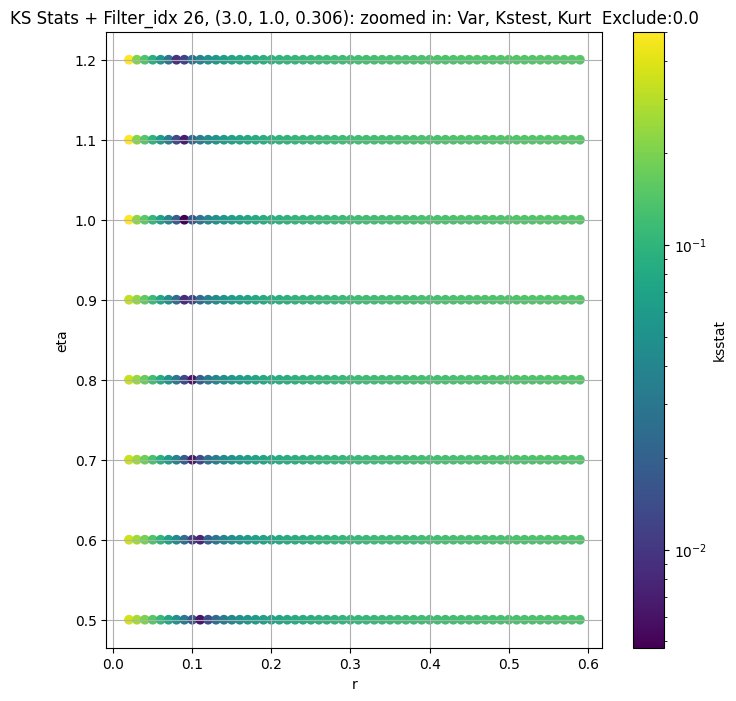

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 100 = 150, ksstat: 0.004868157849331478, var: 0.3250962793827057


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 75 = 125, ksstat: 0.004338304429668323, var: 0.3329569101333618


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 50 = 100, ksstat: 0.0037439422045666415, var: 0.34191590547561646


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 25 = 75, ksstat: 0.0031297922302320064, var: 0.35245078802108765


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 0 = 50, ksstat: 0.0022523679889904225, var: 0.3654450476169586


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + -25 = 25, ksstat: 0.0023406852459226246, var: 0.38326820731163025


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + -50 = 0, ksstat: 0.0043470012554379656, var: 0.4590403139591217
Number of samples: 100000, Without approximation : 160000000.0


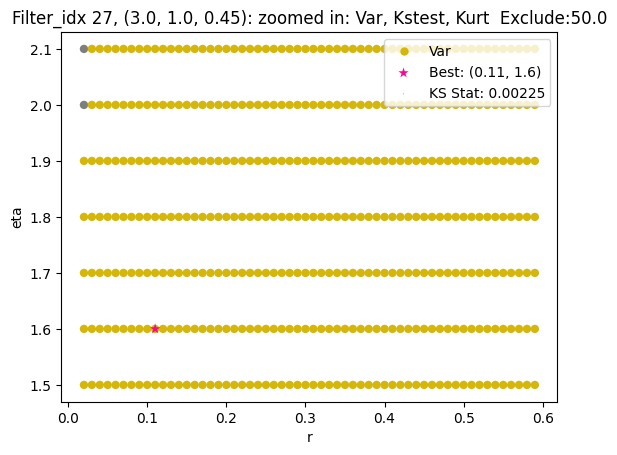

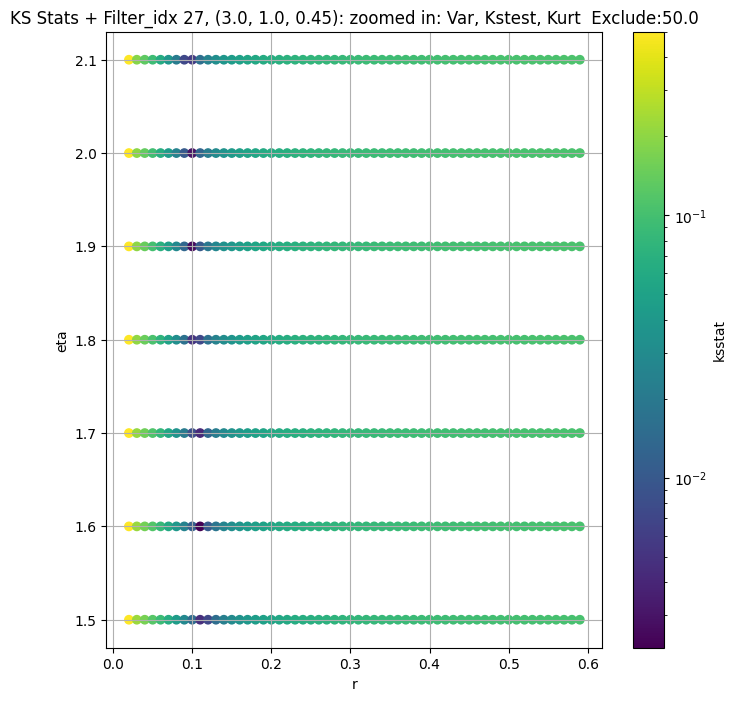

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/456 [00:00<?, ?it/s]

Finding Minimum after computing 456 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.01042151066715541, var: 97.16341400146484


  0%|          | 0/456 [00:00<?, ?it/s]

Finding Minimum after computing 456 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.009587703885107768, var: 98.80921173095703


  0%|          | 0/456 [00:00<?, ?it/s]

Finding Minimum after computing 456 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.009413203540465043, var: 100.69229125976562


  0%|          | 0/456 [00:00<?, ?it/s]

Finding Minimum after computing 456 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.008373530195675216, var: 102.98355865478516


  0%|          | 0/456 [00:00<?, ?it/s]

Finding Minimum after computing 456 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.008278942433545322, var: 107.09752655029297
Number of samples: 100000, Without approximation : 160000000.0


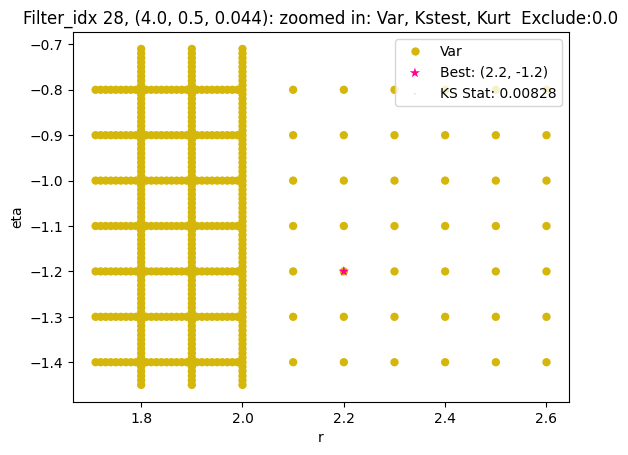

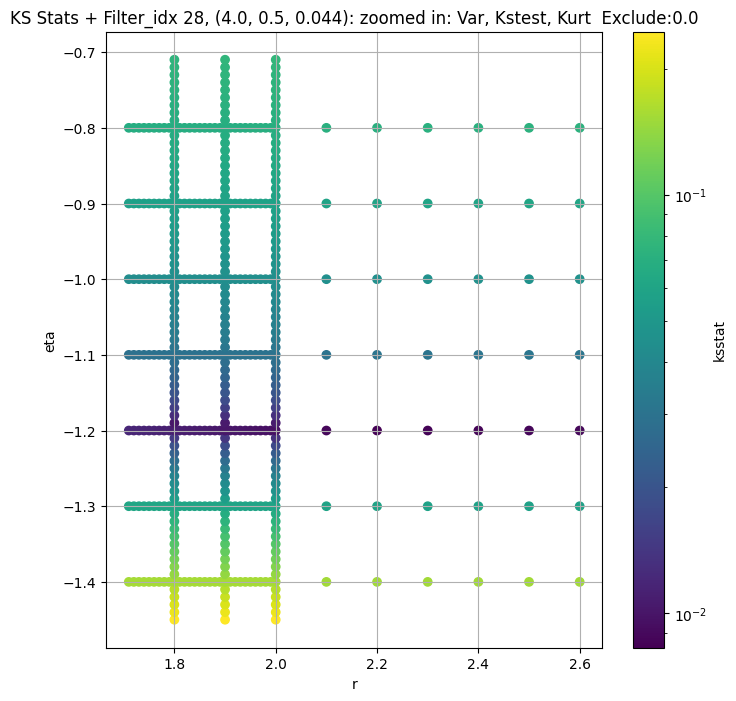

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 29, 50.0 + 100 = 150, ksstat: 0.0072048359019041275, var: 36.43069839477539


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 29, 50.0 + 75 = 125, ksstat: 0.007169660457375271, var: 37.039710998535156


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 29, 50.0 + 50 = 100, ksstat: 0.007152451728224762, var: 37.708251953125


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 29, 50.0 + 25 = 75, ksstat: 0.007129571528440626, var: 38.457252502441406


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 29, 50.0 + 0 = 50, ksstat: 0.007073621931717788, var: 39.326290130615234


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 29, 50.0 + -25 = 25, ksstat: 0.007025283608228738, var: 40.406394958496094


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 29, 50.0 + -50 = 0, ksstat: 0.00696236134786149, var: 42.613731384277344
Number of samples: 100000, Without approximation : 160000000.0


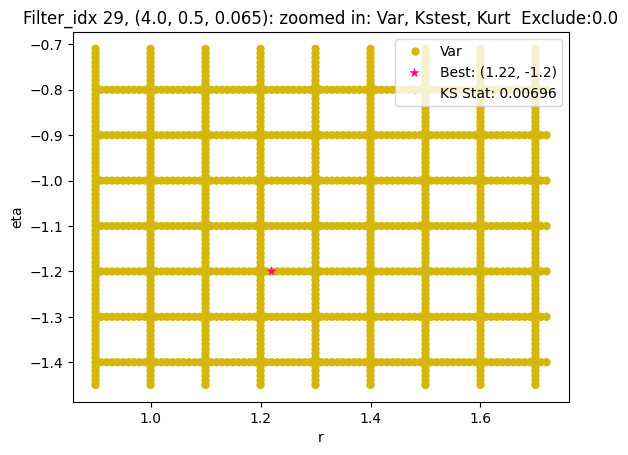

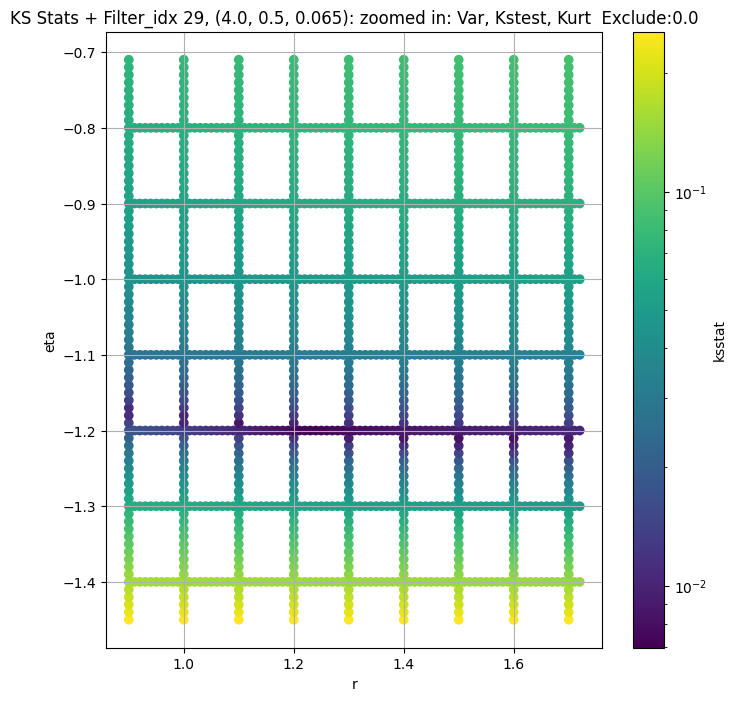

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + 100 = 300, ksstat: 0.008814870392337026, var: 15.075578689575195


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + 75 = 275, ksstat: 0.008983804288118846, var: 15.283021926879883


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + 50 = 250, ksstat: 0.008911991814759213, var: 15.501520156860352


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + 25 = 225, ksstat: 0.008837276751110623, var: 15.732523918151855


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + 0 = 200, ksstat: 0.008955326592936297, var: 15.978004455566406


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + -25 = 175, ksstat: 0.009037577980029632, var: 16.240463256835938


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + -50 = 150, ksstat: 0.008949950811659724, var: 16.523258209228516


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + -75 = 125, ksstat: 0.008856397335613275, var: 16.831138610839844


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 30, 200.0 + -100 = 100, ksstat: 0.009144113814591792, var: 17.17097282409668
Number of samples: 100000, Without approximation : 160000000.0


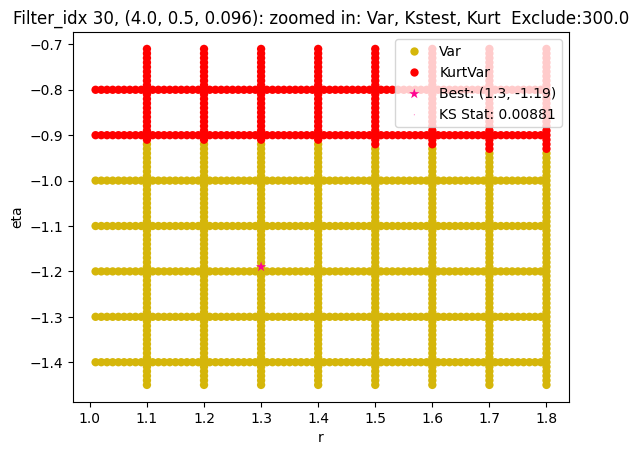

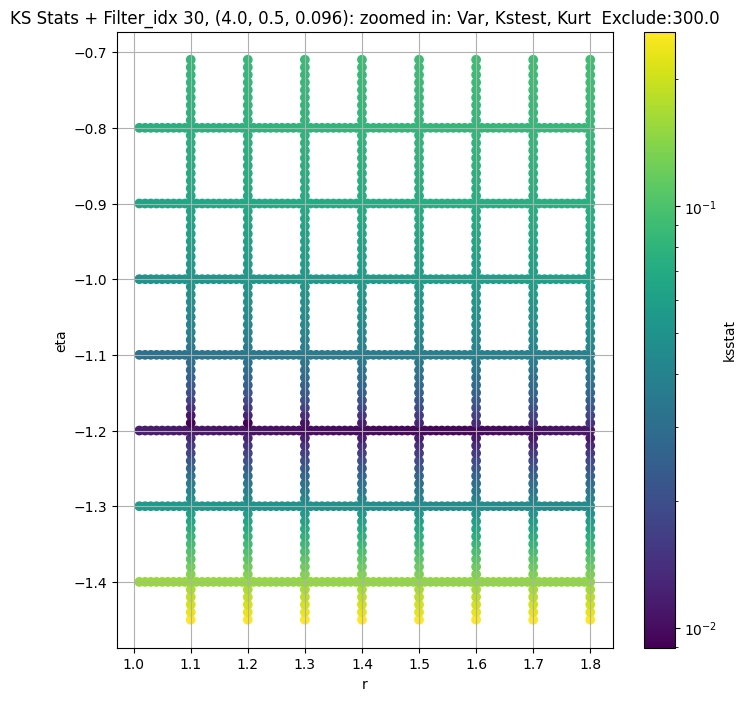

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 100 = 150, ksstat: 0.009757579412285056, var: 6.8542704582214355


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 75 = 125, ksstat: 0.009748692891761501, var: 7.005058765411377


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 50 = 100, ksstat: 0.009505285925956675, var: 7.173277854919434


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 25 = 75, ksstat: 0.009393880950452349, var: 7.365176677703857


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 0 = 50, ksstat: 0.009156518786648776, var: 7.592507362365723


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + -25 = 25, ksstat: 0.008266558006526092, var: 7.883382797241211


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + -50 = 0, ksstat: 0.008367189063102853, var: 8.503867149353027
Number of samples: 100000, Without approximation : 160000000.0


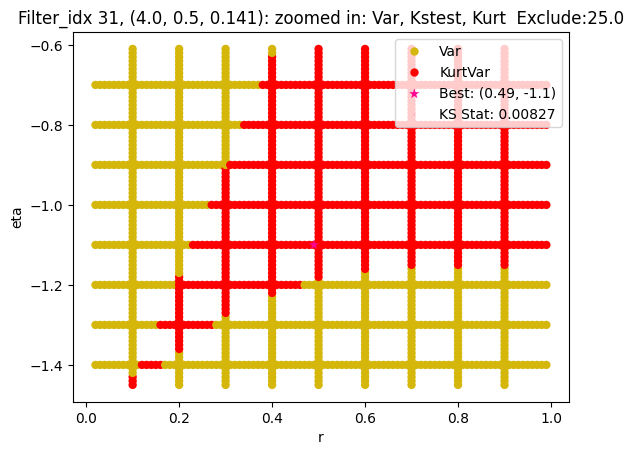

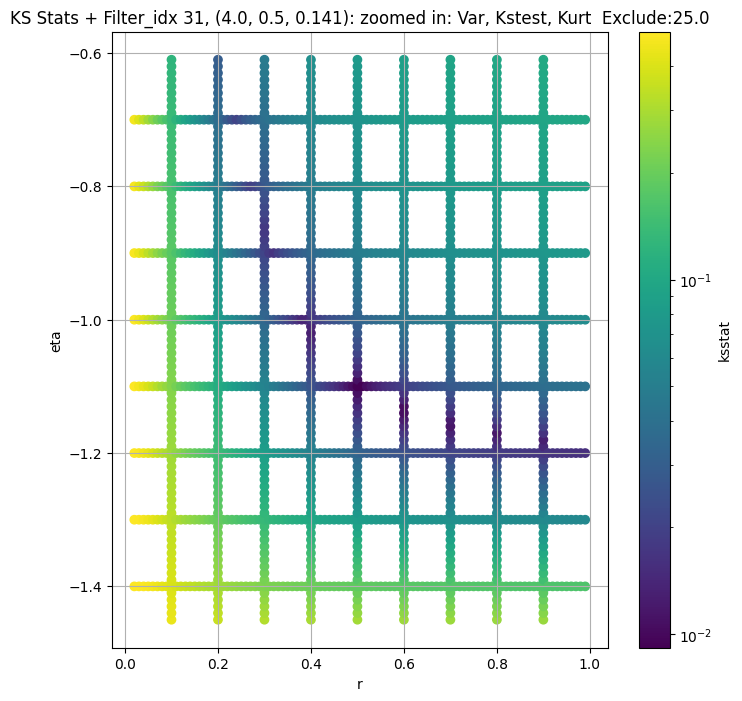

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 0.0 + 100 = 100, ksstat: 0.0074081386275795524, var: 2.656963348388672


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 0.0 + 75 = 75, ksstat: 0.0068962879284151235, var: 2.7360658645629883


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 0.0 + 50 = 50, ksstat: 0.006402483341503784, var: 2.8313369750976562


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 0.0 + 25 = 25, ksstat: 0.0068377301642958965, var: 2.9565820693969727


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 0.0 + 0 = 0, ksstat: 0.006082096141589055, var: 3.309981346130371
Number of samples: 100000, Without approximation : 160000000.0


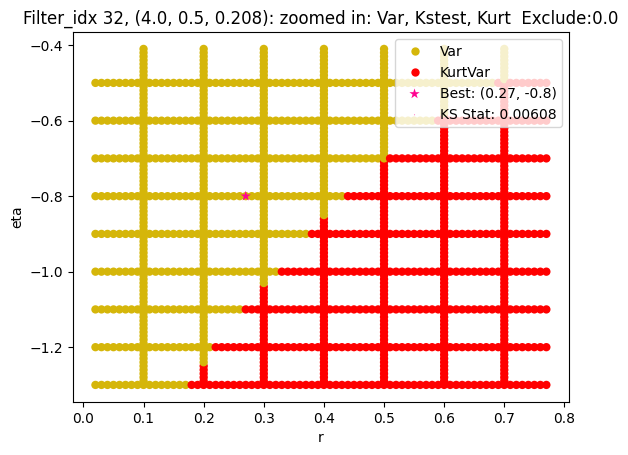

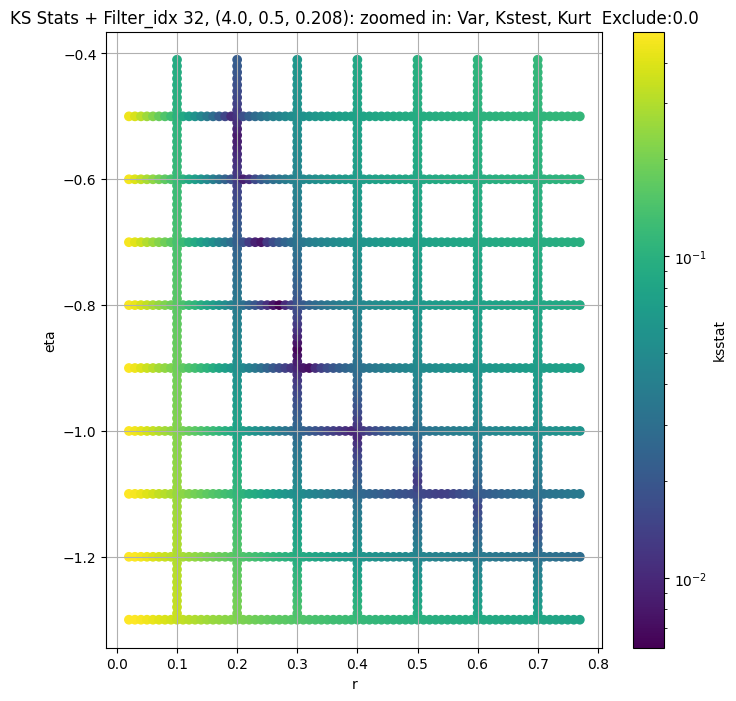

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 100 = 100, ksstat: 0.006217449831504074, var: 0.7353637218475342


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 75 = 75, ksstat: 0.005981439059599844, var: 0.7589017152786255


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 50 = 50, ksstat: 0.005789733141450773, var: 0.7877664566040039


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 25 = 25, ksstat: 0.004621327725129243, var: 0.8267495632171631


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 0 = 0, ksstat: 0.005316392284129501, var: 0.9458284974098206
Number of samples: 100000, Without approximation : 160000000.0


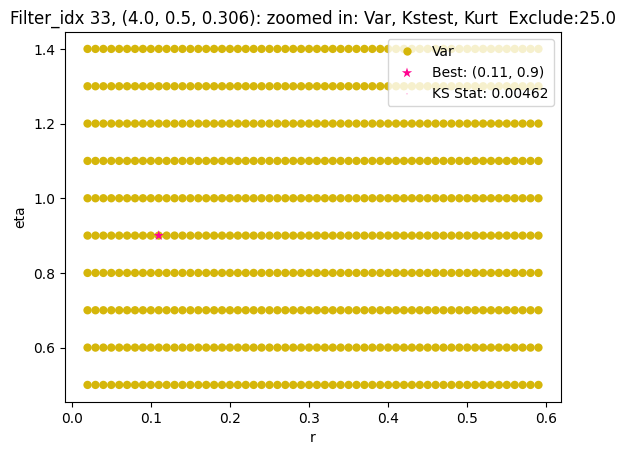

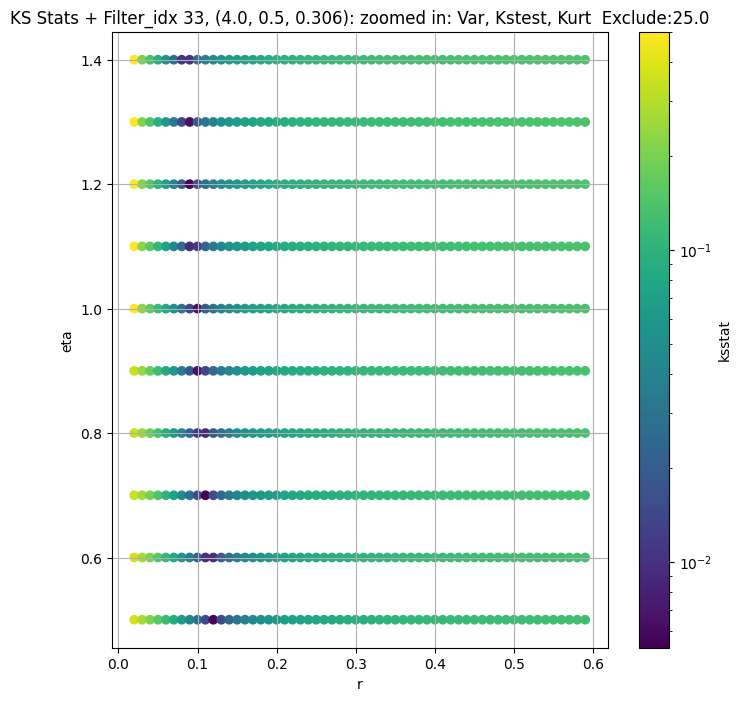

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 100 = 150, ksstat: 0.005785269144170657, var: 0.22266969084739685


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 75 = 125, ksstat: 0.0049712652831828685, var: 0.2273760735988617


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 50 = 100, ksstat: 0.0045831938614602705, var: 0.23272168636322021


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 25 = 75, ksstat: 0.0038206247709901484, var: 0.23898664116859436


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 0 = 50, ksstat: 0.002852272352327767, var: 0.24671529233455658


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + -25 = 25, ksstat: 0.0020284773256664668, var: 0.2573629915714264


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + -50 = 0, ksstat: 0.0032193403936344733, var: 0.30912351608276367
Number of samples: 100000, Without approximation : 160000000.0


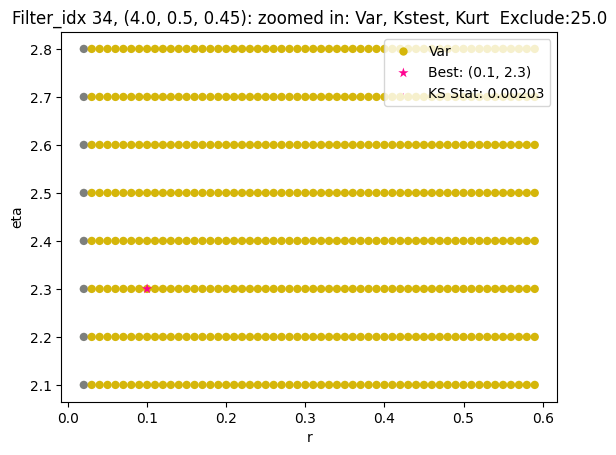

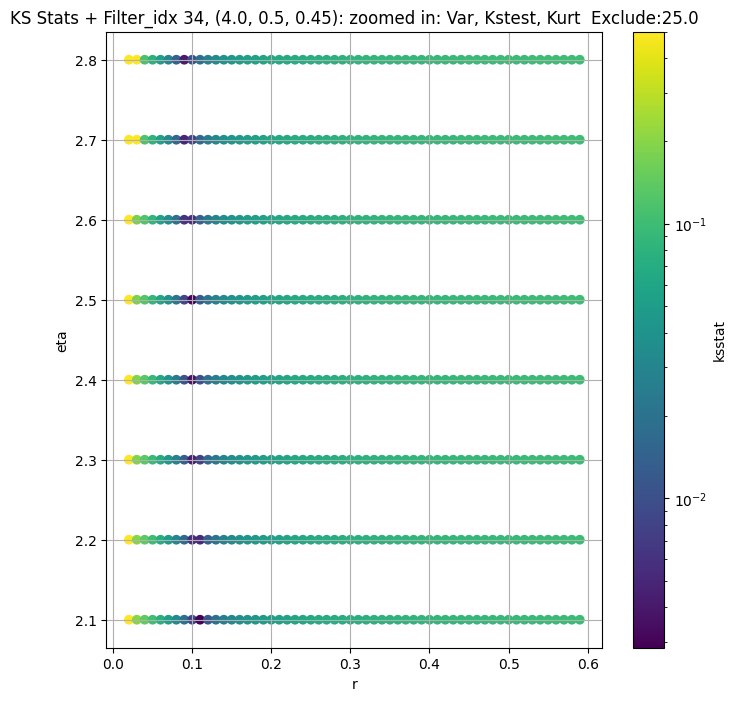

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 35, 0.0 + 100 = 100, ksstat: 0.008057283992393138, var: 107.0078353881836


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 35, 0.0 + 75 = 75, ksstat: 0.007406000036310811, var: 109.14877319335938


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 35, 0.0 + 50 = 50, ksstat: 0.007383111444416002, var: 111.67986297607422


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 35, 0.0 + 25 = 25, ksstat: 0.007371479222165966, var: 114.93144226074219


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 35, 0.0 + 0 = 0, ksstat: 0.007306358604838081, var: 121.18041229248047
Number of samples: 100000, Without approximation : 160000000.0


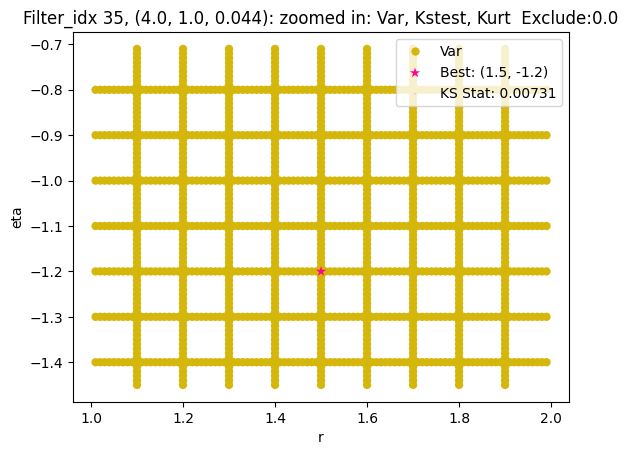

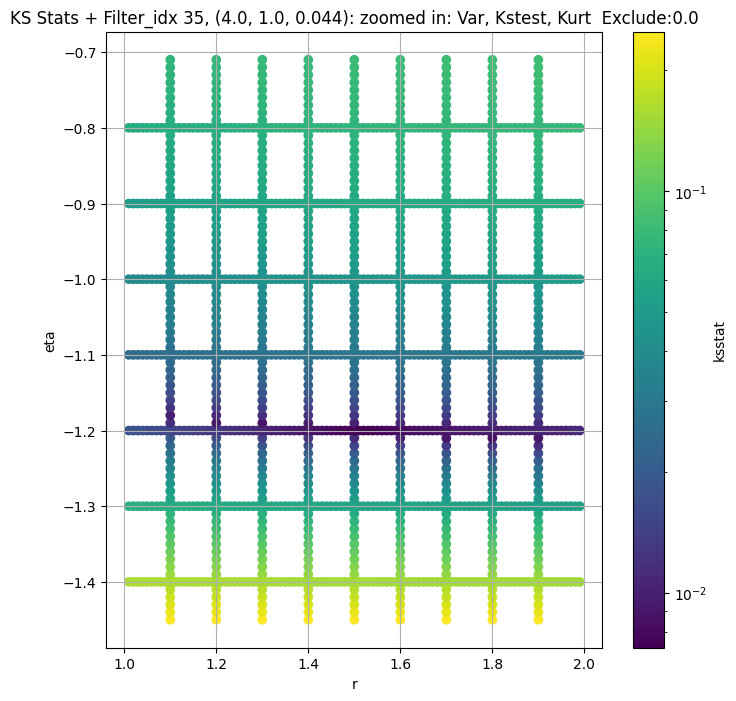

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.009011489648195814, var: 44.9710578918457


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.008566264250468303, var: 45.89611053466797


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.008991267081590426, var: 46.97357177734375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.00851723418221706, var: 48.323184967041016


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.008270911539453918, var: 50.96683120727539
Number of samples: 100000, Without approximation : 160000000.0


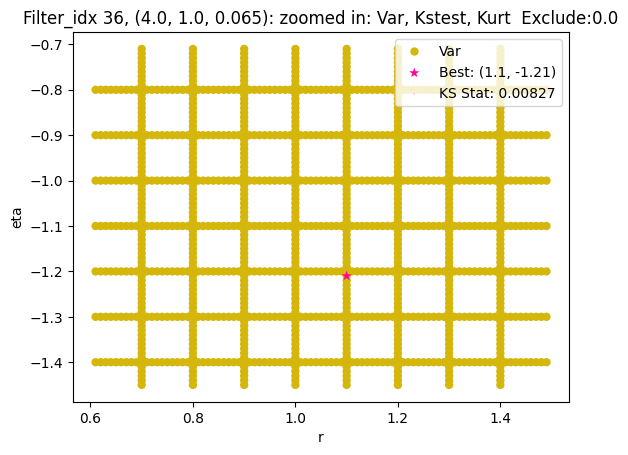

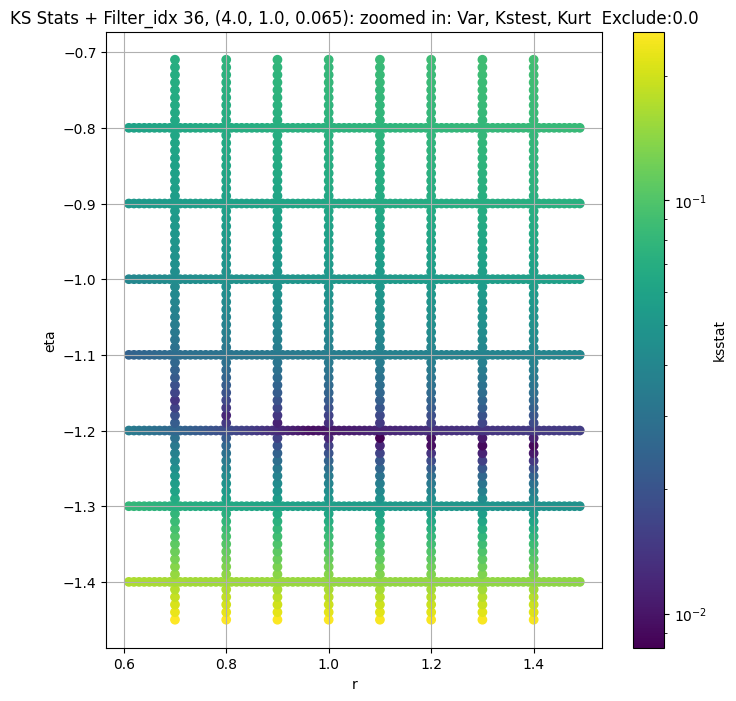

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + 100 = 300, ksstat: 0.009675839719786916, var: 17.6572322845459


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + 75 = 275, ksstat: 0.009580945783325245, var: 17.906124114990234


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + 50 = 250, ksstat: 0.009482672093977906, var: 18.16864776611328


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + 25 = 225, ksstat: 0.009423832509544261, var: 18.446809768676758


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + 0 = 200, ksstat: 0.00947607769686748, var: 18.743270874023438


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + -25 = 175, ksstat: 0.009501245562187344, var: 19.061508178710938


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + -50 = 150, ksstat: 0.009555503462780612, var: 19.405948638916016


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + -75 = 125, ksstat: 0.010480283999256379, var: 19.783111572265625


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 37, 200.0 + -100 = 100, ksstat: 0.011803735778937674, var: 20.20294761657715
Number of samples: 100000, Without approximation : 160000000.0


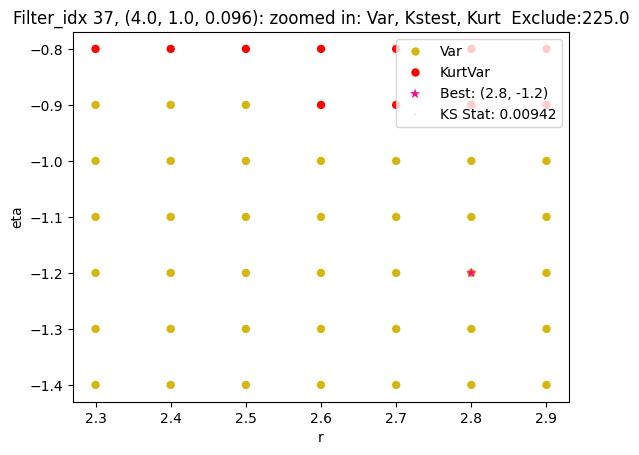

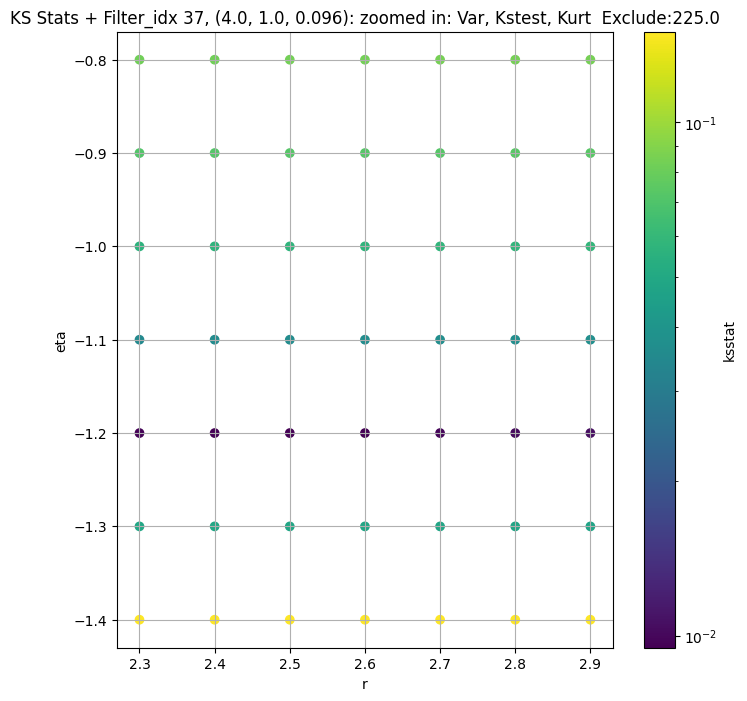

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 50.0 + 100 = 150, ksstat: 0.0073327974725856115, var: 7.390259742736816


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 50.0 + 75 = 125, ksstat: 0.007444269479022714, var: 7.555881023406982


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 50.0 + 50 = 100, ksstat: 0.00746694713199314, var: 7.7409210205078125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 50.0 + 25 = 75, ksstat: 0.0071734105512911706, var: 7.952797889709473


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 50.0 + 0 = 50, ksstat: 0.007386664586516156, var: 8.204585075378418


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 50.0 + -25 = 25, ksstat: 0.007431354281941971, var: 8.529047966003418


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 50.0 + -50 = 0, ksstat: 0.0075543527461969795, var: 9.312406539916992
Number of samples: 100000, Without approximation : 160000000.0


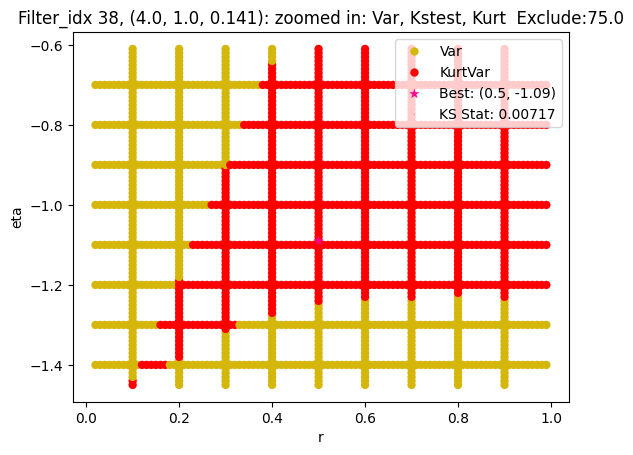

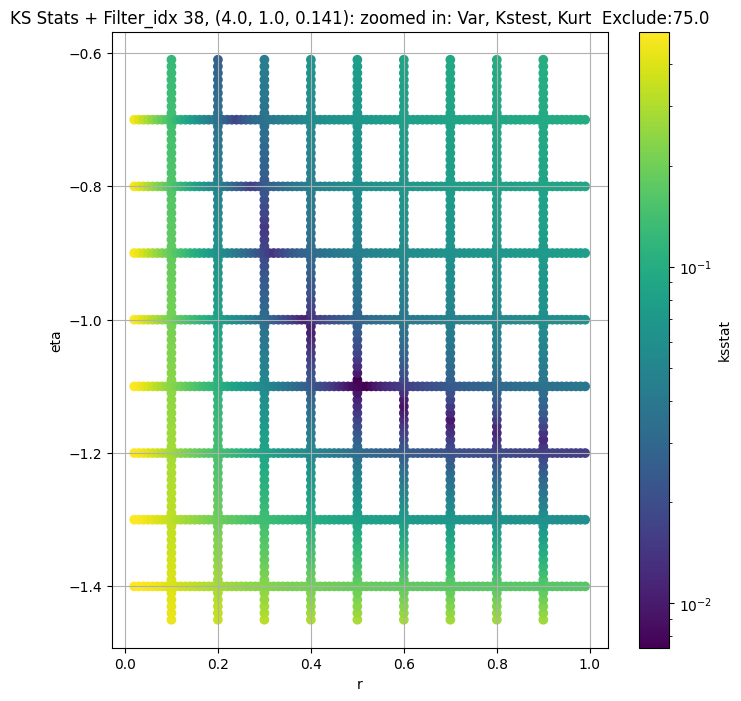

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 39, 0.0 + 100 = 100, ksstat: 0.008065311498211769, var: 2.9520883560180664


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 39, 0.0 + 75 = 75, ksstat: 0.008002755799246752, var: 3.0379769802093506


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 39, 0.0 + 50 = 50, ksstat: 0.008422258509519387, var: 3.141160011291504


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 39, 0.0 + 25 = 25, ksstat: 0.007451775703885111, var: 3.2764525413513184


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 39, 0.0 + 0 = 0, ksstat: 0.0069733283913929744, var: 3.6433825492858887
Number of samples: 100000, Without approximation : 160000000.0


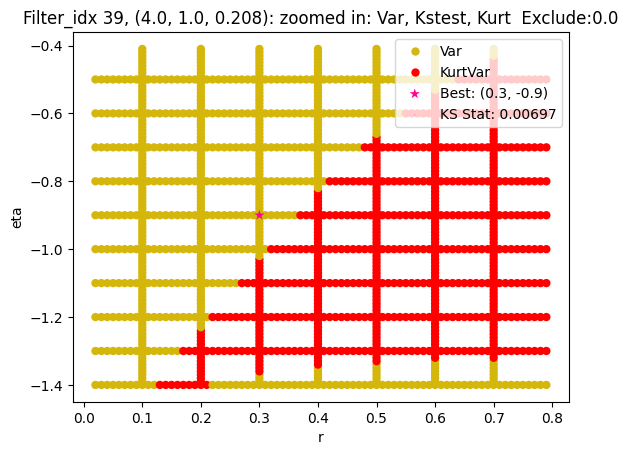

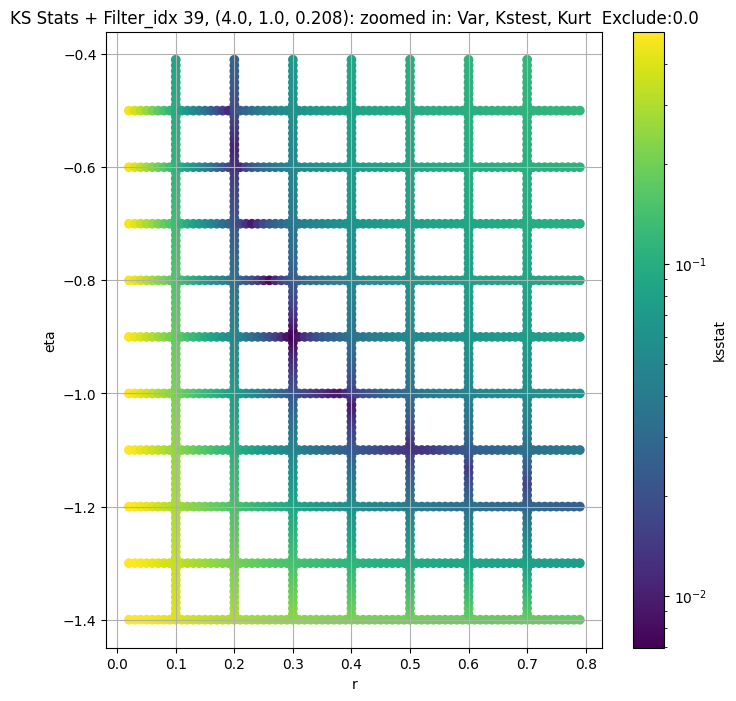

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 0.0 + 100 = 100, ksstat: 0.007356248600056459, var: 0.8667798638343811


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 0.0 + 75 = 75, ksstat: 0.00616219946241181, var: 0.8946943879127502


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 0.0 + 50 = 50, ksstat: 0.0056857112472376015, var: 0.9288661479949951


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 0.0 + 25 = 25, ksstat: 0.005160461032803265, var: 0.9747081995010376


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 40, 0.0 + 0 = 0, ksstat: 0.005190528201878819, var: 1.1515096426010132
Number of samples: 100000, Without approximation : 160000000.0


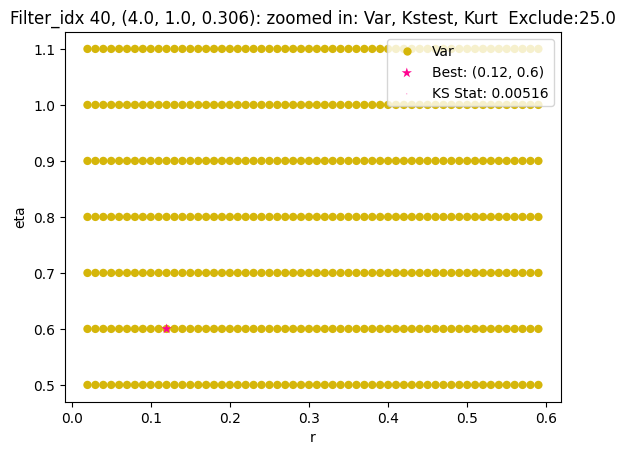

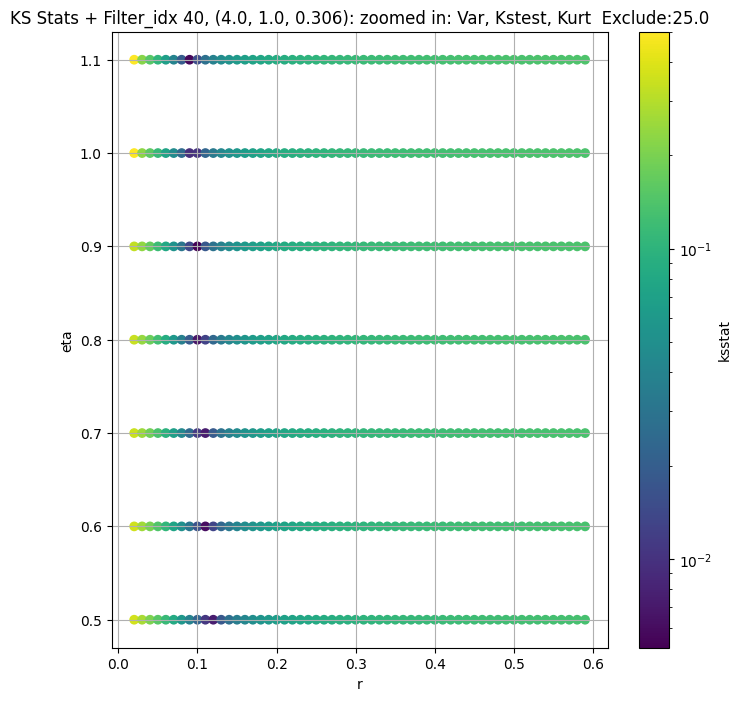

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 100 = 150, ksstat: 0.004919889018252799, var: 0.26355260610580444


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 75 = 125, ksstat: 0.004372773596509637, var: 0.27003979682922363


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 50 = 100, ksstat: 0.003755594762453039, var: 0.27747899293899536


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 25 = 75, ksstat: 0.0031401671330236886, var: 0.2862889766693115


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 0 = 50, ksstat: 0.0022075896590600733, var: 0.29729267954826355


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + -25 = 25, ksstat: 0.0020523749457528884, var: 0.31268206238746643


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + -50 = 0, ksstat: 0.0057483076211487655, var: 0.39317724108695984
Number of samples: 100000, Without approximation : 160000000.0


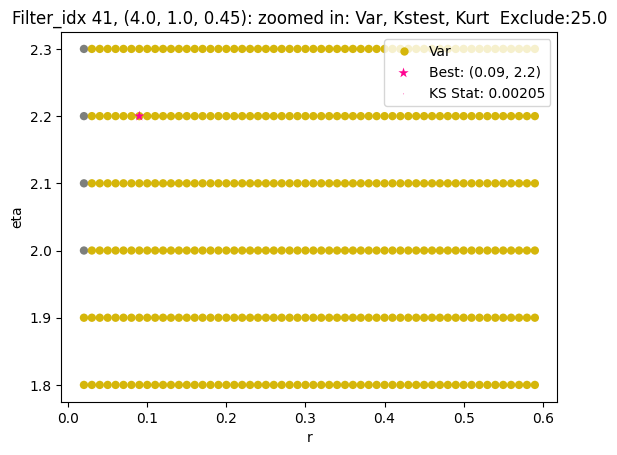

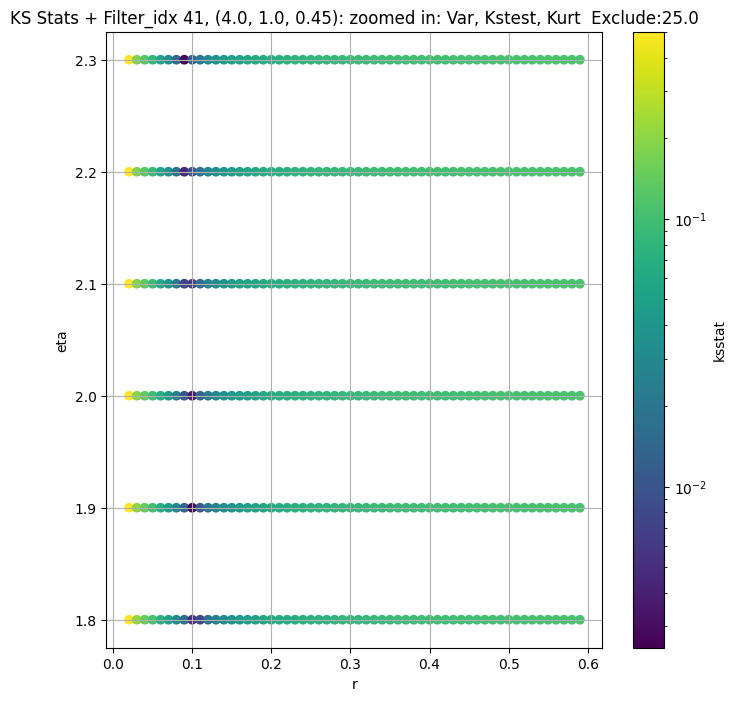

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",119.920680,90.392960,170.642840,10.590433,3.464781,74.931915,160000000.0,"(2.0, 0.5, 0.044)",0.010390,...,5.594559e+02,0.0,119.920680,0.000107,0.010390,3.70,-1.20,5.594559e+02,0.0,16477
1,"(2.0, 0.5, 0.065)",47.594410,35.287544,70.195230,16.244356,4.297632,127.499300,160000000.0,"(2.0, 0.5, 0.065)",0.011403,...,1.728865e+02,50.0,47.594410,0.000107,0.009047,1.70,-1.22,2.196068e+02,0.0,21972
2,"(2.0, 0.5, 0.096)",21.673610,15.789366,35.630035,23.372608,4.751333,189.667900,160000000.0,"(2.0, 0.5, 0.096)",0.008775,...,7.774104e+01,50.0,18.815195,0.000107,0.008333,1.10,-1.19,6.529673e+01,100.0,27807
3,"(2.0, 0.5, 0.141)",8.808341,6.126378,15.579457,28.468450,5.715089,174.328890,160000000.0,"(2.0, 0.5, 0.141)",0.008590,...,8.484664e+00,100.0,8.808341,0.000107,0.006919,0.53,-1.10,7.278308e+00,0.0,39062
4,"(2.0, 0.5, 0.208)",3.561086,2.395280,7.824097,44.146633,6.604411,327.389340,160000000.0,"(2.0, 0.5, 0.208)",0.007937,...,6.175921e-02,0.0,3.561086,0.000107,0.006638,0.30,-0.81,6.391968e-02,0.0,43944
5,"(2.0, 0.5, 0.306)",1.033891,0.661437,2.774271,82.956276,5.937702,427.047420,160000000.0,"(2.0, 0.5, 0.306)",0.003847,...,1.120879e-15,0.0,1.033891,0.000107,0.003847,0.10,1.20,1.120879e-15,0.0,131835
6,"(2.0, 0.5, 0.45)",0.608527,0.399818,1.869624,99.041620,5.892619,468.845900,160000000.0,"(2.0, 0.5, 0.45)",0.002096,...,2.637749e-16,0.0,0.608527,0.000107,0.001856,0.09,1.90,4.643623e-19,0.0,527343
7,"(2.0, 1.0, 0.044)",166.012740,126.613090,245.244550,12.991724,3.800807,110.412130,160000000.0,"(2.0, 1.0, 0.044)",0.010354,...,7.744853e+02,0.0,166.012740,0.000107,0.010354,3.70,-1.20,7.744853e+02,0.0,16477
8,"(2.0, 1.0, 0.065)",65.958330,48.032578,106.776000,17.634312,4.299627,133.457060,160000000.0,"(2.0, 1.0, 0.065)",0.008816,...,2.675942e+02,100.0,57.891792,0.000107,0.008816,2.60,-1.20,2.675942e+02,100.0,24718


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

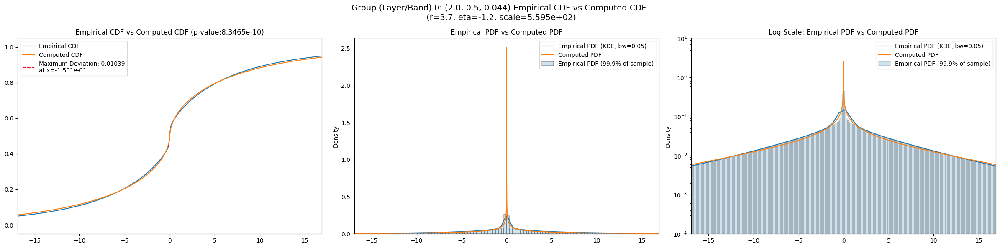

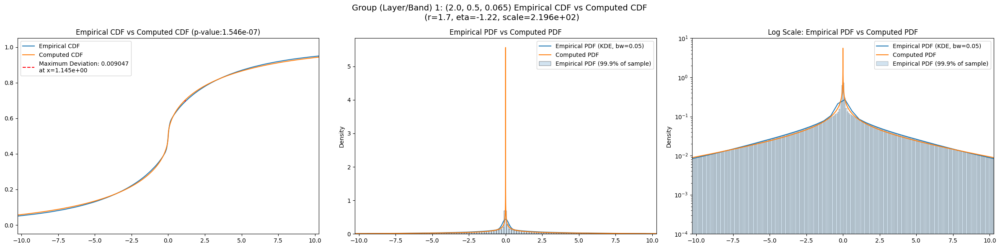

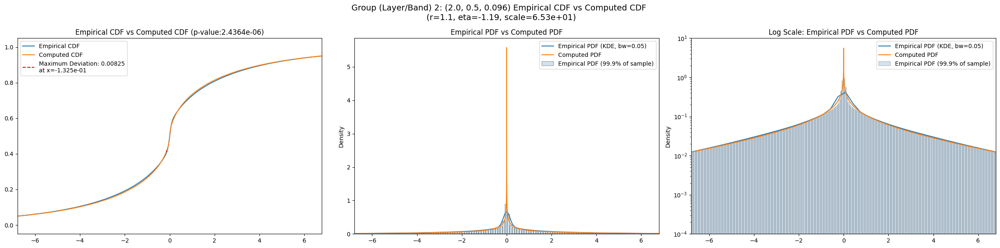

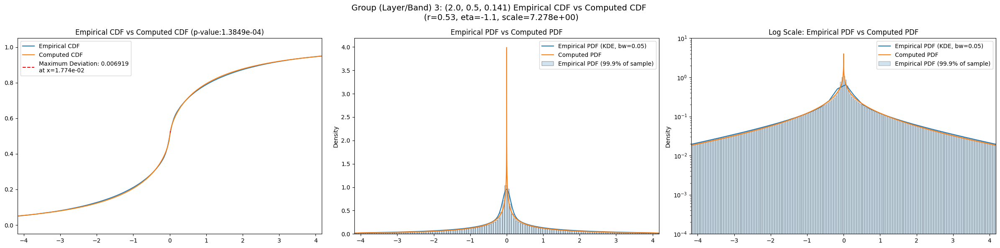

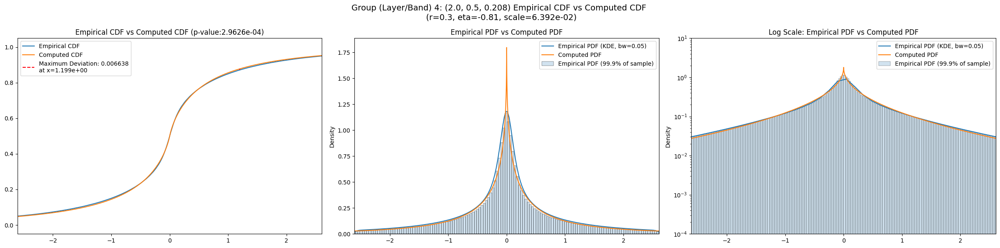

...

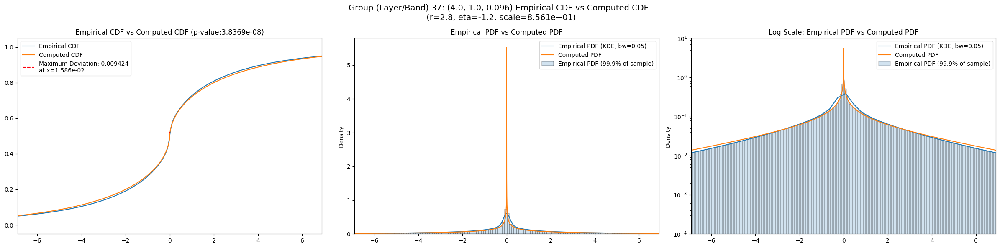

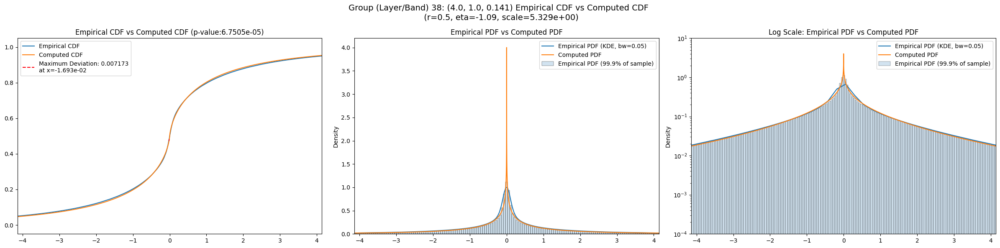

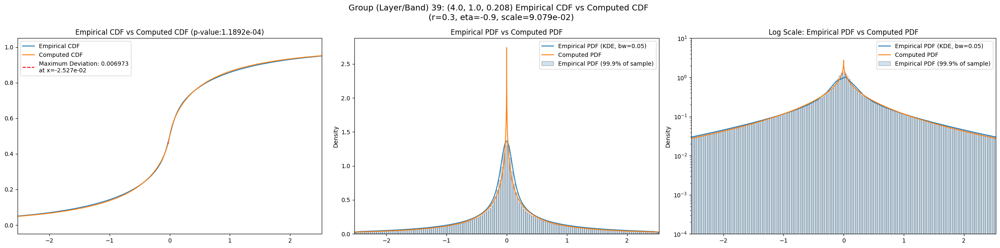

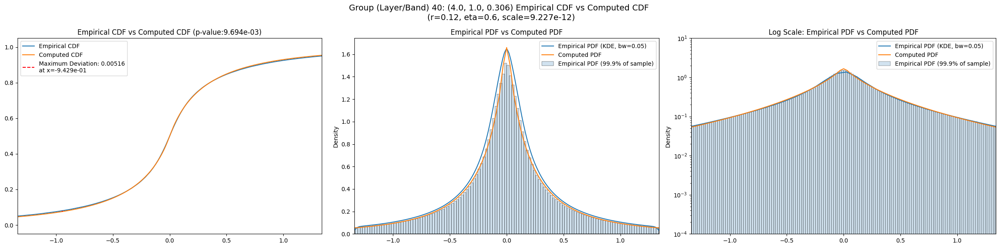

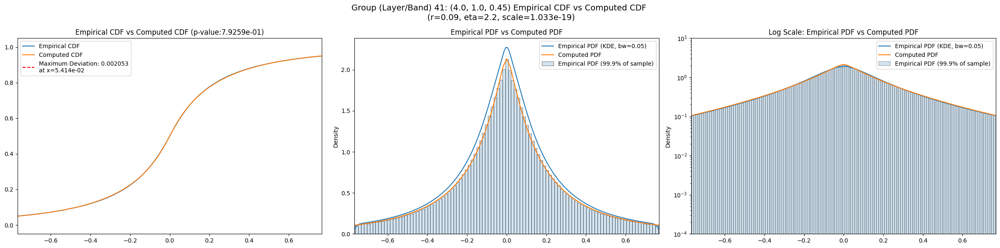

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",119.920680,90.392960,170.642840,10.590433,3.464781,74.931915,160000000.0,"(2.0, 0.5, 0.044)",0.010390,...,6.042050,0.063603,0.0,4.805520,0.047427,0.0,3.931280,0.050885,0.0,0.0
1,"(2.0, 0.5, 0.065)",47.594410,35.287544,70.195230,16.244356,4.297632,127.499300,160000000.0,"(2.0, 0.5, 0.065)",0.011403,...,3.344360,0.071889,0.0,2.661660,0.055223,0.0,2.152920,0.058744,0.0,0.0
2,"(2.0, 0.5, 0.096)",21.673610,15.789366,35.630035,23.372608,4.751333,189.667900,160000000.0,"(2.0, 0.5, 0.096)",0.008775,...,2.134570,0.074757,0.0,1.733260,0.055379,0.0,1.387350,0.059044,0.0,0.0
3,"(2.0, 0.5, 0.141)",8.808341,6.126378,15.579457,28.468450,5.715089,174.328890,160000000.0,"(2.0, 0.5, 0.141)",0.008590,...,1.288190,0.074942,0.0,1.080880,0.051573,0.0,0.856647,0.054852,0.0,0.0
4,"(2.0, 0.5, 0.208)",3.561086,2.395280,7.824097,44.146633,6.604411,327.389340,160000000.0,"(2.0, 0.5, 0.208)",0.007937,...,0.828827,0.069981,0.0,0.717565,0.043460,0.0,0.567525,0.045167,0.0,0.0
5,"(2.0, 0.5, 0.306)",1.033891,0.661437,2.774271,82.956276,5.937702,427.047420,160000000.0,"(2.0, 0.5, 0.306)",0.003847,...,0.495017,0.056049,0.0,0.435183,0.028710,0.0,0.346100,0.028339,0.0,0.0
6,"(2.0, 0.5, 0.45)",0.608527,0.399818,1.869624,99.041620,5.892619,468.845900,160000000.0,"(2.0, 0.5, 0.45)",0.002096,...,0.409629,0.050486,0.0,0.360421,0.023153,0.0,0.287467,0.022727,0.0,0.0
7,"(2.0, 1.0, 0.044)",166.012740,126.613090,245.244550,12.991724,3.800807,110.412130,160000000.0,"(2.0, 1.0, 0.044)",0.010354,...,7.077700,0.062362,0.0,5.636330,0.045779,0.0,4.602390,0.048984,0.0,0.0
8,"(2.0, 1.0, 0.065)",65.958330,48.032578,106.776000,17.634312,4.299627,133.457060,160000000.0,"(2.0, 1.0, 0.065)",0.008816,...,4.135690,0.065516,0.0,3.301910,0.048258,0.0,2.674330,0.051553,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.010390,0.000107,0.010390,0.063603,0.047427,0.050885
1,0.011403,0.000107,0.009047,0.071889,0.055223,0.058744
2,0.008775,0.000107,0.008333,0.074757,0.055379,0.059044
3,0.008590,0.000107,0.006919,0.074942,0.051573,0.054852
4,0.007937,0.000107,0.006638,0.069981,0.043460,0.045167
5,0.003847,0.000107,0.003847,0.056049,0.028710,0.028339
6,0.002096,0.000107,0.001856,0.050486,0.023153,0.022727
7,0.010354,0.000107,0.010354,0.062362,0.045779,0.048984
8,0.008816,0.000107,0.008816,0.065516,0.048258,0.051553


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,119.920680,0.010390,3.70,-1.20,5.594559e+02,0.0
1,47.594410,0.009047,1.70,-1.22,2.196068e+02,0.0
2,18.815195,0.008333,1.10,-1.19,6.529673e+01,100.0
3,8.808341,0.006919,0.53,-1.10,7.278308e+00,0.0
4,3.561086,0.006638,0.30,-0.81,6.391968e-02,0.0
5,1.033891,0.003847,0.10,1.20,1.120879e-15,0.0
6,0.608527,0.001856,0.09,1.90,4.643623e-19,0.0
7,166.012740,0.010354,3.70,-1.20,7.744853e+02,0.0
8,57.891792,0.008816,2.60,-1.20,2.675942e+02,100.0
